# **Credit EDA Case Study**



## **Import Libraries**

In [1]:
# Filtering out the warnings
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Importing the necessary libraries.
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

## **Reading CSV File**

In [3]:
# Parsing the CSV files 'application_data.csv' and 'previous_application.csv'.
app_df = pd.read_csv('application_data.csv')
pre_app_df = pd.read_csv('previous_application.csv')

## **Data Understanding**

In [4]:
# Determining the shape of the application_data dataframe

app_df.shape

(307511, 122)

In [5]:
# The .info() method in pandas provides information about the DataFrame, including column details.
# "verbose" to True provides additional details about the DataFrame.
# "null_counts" set to False omits the count of non-null values.
app_df.info(verbose=True, null_counts=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Dtype  
---   ------                        -----  
 0    SK_ID_CURR                    int64  
 1    TARGET                        int64  
 2    NAME_CONTRACT_TYPE            object 
 3    CODE_GENDER                   object 
 4    FLAG_OWN_CAR                  object 
 5    FLAG_OWN_REALTY               object 
 6    CNT_CHILDREN                  int64  
 7    AMT_INCOME_TOTAL              float64
 8    AMT_CREDIT                    float64
 9    AMT_ANNUITY                   float64
 10   AMT_GOODS_PRICE               float64
 11   NAME_TYPE_SUITE               object 
 12   NAME_INCOME_TYPE              object 
 13   NAME_EDUCATION_TYPE           object 
 14   NAME_FAMILY_STATUS            object 
 15   NAME_HOUSING_TYPE             object 
 16   REGION_POPULATION_RELATIVE    float64
 17   DAYS_BIRTH                    int64  
 18   DA

In [6]:
#  It shows the top 5 rows of the DataFrame
app_df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [7]:
#  It shows the last 5 rows of the DataFrame
app_df.tail()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
307506,456251,0,Cash loans,M,N,N,0,157500.0,254700.0,27558.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307507,456252,0,Cash loans,F,N,Y,0,72000.0,269550.0,12001.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
307508,456253,0,Cash loans,F,N,Y,0,153000.0,677664.0,29979.0,...,0,0,0,0,1.0,0.0,0.0,1.0,0.0,1.0
307509,456254,1,Cash loans,F,N,Y,0,171000.0,370107.0,20205.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
307510,456255,0,Cash loans,F,N,N,0,157500.0,675000.0,49117.5,...,0,0,0,0,0.0,0.0,0.0,2.0,0.0,1.0


In [8]:
#.describe(): it is use to calculates various summary statistics for the numerical columns in the DataFrame.
# .T: This transposes the result, swapping rows with columns.
app_df.describe().T

,count,mean,std,min,25%,50%,75%,max
SK_ID_CURR,307511.0,278180.518577,102790.175348,100002.0,189145.5,278202.0,367142.5,456255.0
TARGET,307511.0,0.080729,0.272419,0.0,0.0,0.0,0.0,1.0
CNT_CHILDREN,307511.0,0.417052,0.722121,0.0,0.0,0.0,1.0,19.0
AMT_INCOME_TOTAL,307511.0,168797.919297,237123.146279,25650.0,112500.0,147150.0,202500.0,117000000.0
AMT_CREDIT,307511.0,599025.999706,402490.776996,45000.0,270000.0,513531.0,808650.0,4050000.0
...,...,...,...,...,...,...,...,...
AMT_REQ_CREDIT_BUREAU_DAY,265992.0,0.007000,0.110757,0.0,0.0,0.0,0.0,9.0
AMT_REQ_CREDIT_BUREAU_WEEK,265992.0,0.034362,0.204685,0.0,0.0,0.0,0.0,8.0
AMT_REQ_CREDIT_BUREAU_MON,265992.0,0.267395,0.916002,0.0,0.0,0.0,0.0,27.0
AMT_REQ_CREDIT_BUREAU_QRT,265992.0,0.265474,0.794056,0.0,0.0,0.0,0.0,261.0


## **Data Cleaning and Manipulation**

In [9]:
# Checking the null values in each column

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
missing_percentage = round((app_df.isnull().sum()/len(app_df))*100,2)

In [10]:
missing_percentage[missing_percentage > 30]

OWN_CAR_AGE                     65.99
OCCUPATION_TYPE                 31.35
EXT_SOURCE_1                    56.38
APARTMENTS_AVG                  50.75
BASEMENTAREA_AVG                58.52
YEARS_BEGINEXPLUATATION_AVG     48.78
YEARS_BUILD_AVG                 66.50
COMMONAREA_AVG                  69.87
ELEVATORS_AVG                   53.30
ENTRANCES_AVG                   50.35
FLOORSMAX_AVG                   49.76
FLOORSMIN_AVG                   67.85
LANDAREA_AVG                    59.38
LIVINGAPARTMENTS_AVG            68.35
LIVINGAREA_AVG                  50.19
NONLIVINGAPARTMENTS_AVG         69.43
NONLIVINGAREA_AVG               55.18
APARTMENTS_MODE                 50.75
BASEMENTAREA_MODE               58.52
YEARS_BEGINEXPLUATATION_MODE    48.78
YEARS_BUILD_MODE                66.50
COMMONAREA_MODE                 69.87
ELEVATORS_MODE                  53.30
ENTRANCES_MODE                  50.35
FLOORSMAX_MODE                  49.76
FLOORSMIN_MODE                  67.85
LANDAREA_MOD

 The "OCCUPATION_TYPE" field significantly influences the loan approval process by affecting an applicant's financial stability, repayment capacity, and risk profile. This field sheds light on the applicant's profession, directly impacting their income stability and ability to meet loan obligations. The importance of "OCCUPATION_TYPE" as a key factor is evident. Moreover, the decision to adopt a 40% threshold, instead of 30%, for dropping columns demonstrates a prudent strategy.

In [11]:
#Droping Columns
app_df.drop(columns = missing_percentage[missing_percentage > 40].index, axis=1,inplace=True)
app_df.shape


(307511, 73)

In [12]:
# Checking % of missing values again

(app_df.isnull().sum()/len(app_df))*100

SK_ID_CURR                      0.000000
TARGET                          0.000000
NAME_CONTRACT_TYPE              0.000000
CODE_GENDER                     0.000000
FLAG_OWN_CAR                    0.000000
FLAG_OWN_REALTY                 0.000000
CNT_CHILDREN                    0.000000
AMT_INCOME_TOTAL                0.000000
AMT_CREDIT                      0.000000
AMT_ANNUITY                     0.003902
AMT_GOODS_PRICE                 0.090403
NAME_TYPE_SUITE                 0.420148
NAME_INCOME_TYPE                0.000000
NAME_EDUCATION_TYPE             0.000000
NAME_FAMILY_STATUS              0.000000
NAME_HOUSING_TYPE               0.000000
REGION_POPULATION_RELATIVE      0.000000
DAYS_BIRTH                      0.000000
DAYS_EMPLOYED                   0.000000
DAYS_REGISTRATION               0.000000
DAYS_ID_PUBLISH                 0.000000
FLAG_MOBIL                      0.000000
FLAG_EMP_PHONE                  0.000000
FLAG_WORK_PHONE                 0.000000
FLAG_CONT_MOBILE

We've completed a thorough data preprocessing procedure to improve the dataset's quality. Our main objective was addressing missing values, particularly those exceeding 40% in each column. We meticulously removed columns that surpassed this 40% missing value threshold.

This crucial data cleansing step ensures that the resulting dataset is more resilient and dependable for future analysis. This methodology lets us give particular consideration to each row, providing assurance that our final dataset is both comprehensive and dependable.

### **Handling Missing Values**
### Inspecting and addressing individual columns with missing data in a sequential manner.

#### ***AMT_GOODS_PRICE***

In [13]:
# AMT_GOODS_PRICE
app_df[app_df['AMT_GOODS_PRICE'].isnull()].head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
724,100837,0,Revolving loans,F,N,Y,2,45000.0,135000.0,6750.0,NaN,NaN,Commercial associate,Secondary / secondary special,Married,House / apartment,0.024610,-10072,-381,-519.0,-1834,1,1,1,1,0,0,Core staff,4.0,2,2,WEDNESDAY,14,0,0,0,0,0,0,Kindergarten,0.378174,NaN,2.0,1.0,2.0,1.0,-2011.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
5937,106955,0,Revolving loans,F,N,N,0,157500.0,450000.0,22500.0,NaN,NaN,Working,Secondary / secondary special,Married,House / apartment,0.010006,-11993,-2921,-1289.0,-1948,1,1,1,1,1,1,Private service staff,2.0,2,2,SATURDAY,13,0,0,0,0,0,0,Business Entity Type 3,0.464614,0.537070,0.0,0.0,0.0,0.0,-476.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,2.0
6425,107494,0,Revolving loans,F,N,N,0,67500.0,202500.0,10125.0,NaN,NaN,Working,Higher education,Married,House / apartment,0.008474,-9727,-2712,-4132.0,-800,1,1,1,1,1,0,Accountants,2.0,2,2,WEDNESDAY,18,0,0,0,0,0,0,Trade: type 7,0.565849,NaN,1.0,1.0,1.0,0.0,-643.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
6703,107822,0,Revolving loans,F,N,N,1,121500.0,180000.0,9000.0,NaN,NaN,Working,Secondary / secondary special,Civil marriage,House / apartment,0.011657,-11079,-899,-3765.0,-572,1,1,1,1,1,0,Managers,3.0,1,1,WEDNESDAY,11,0,0,0,0,0,0,Government,0.645519,0.863363,1.0,0.0,1.0,0.0,-1292.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
7647,108913,0,Revolving loans,M,N,Y,0,180000.0,450000.0,22500.0,NaN,NaN,Working,Higher education,Single / not married,House / apartment,0.032561,-9986,-1847,-4762.0,-506,1,1,1,1,1,0,Security staff,1.0,1,1,SATURDAY,18,0,0,0,0,0,0,Construction,0.552557,0.661024,1.0,0.0,1.0,0.0,-159.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0


In [14]:
app_df['AMT_GOODS_PRICE'].describe().apply(lambda x: '%.2f' % x)

count     307233.00
mean      538396.21
std       369446.46
min        40500.00
25%       238500.00
50%       450000.00
75%       679500.00
max      4050000.00
Name: AMT_GOODS_PRICE, dtype: object

In [15]:
app_df['AMT_GOODS_PRICE'].fillna(app_df['AMT_GOODS_PRICE'].mean(),inplace=True)

In [16]:
app_df['AMT_GOODS_PRICE'].isnull().sum()

0

#### ***NAME_TYPE_SUITE***

In [17]:
# NAME_TYPE_SUITE

app_df[app_df['NAME_TYPE_SUITE'].isnull()].head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
64,100076,0,Cash loans,M,Y,N,0,180000.0,315000.0,9679.5,315000.000000,NaN,Commercial associate,Secondary / secondary special,Married,House / apartment,0.028663,-13866,-2546,-5448.0,-4097,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,12,0,0,0,0,0,0,Transport: type 3,0.584887,0.095070,0.0,0.0,0.0,0.0,-3.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
724,100837,0,Revolving loans,F,N,Y,2,45000.0,135000.0,6750.0,538396.207429,NaN,Commercial associate,Secondary / secondary special,Married,House / apartment,0.024610,-10072,-381,-519.0,-1834,1,1,1,1,0,0,Core staff,4.0,2,2,WEDNESDAY,14,0,0,0,0,0,0,Kindergarten,0.378174,NaN,2.0,1.0,2.0,1.0,-2011.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
1199,101414,0,Cash loans,M,Y,N,0,135000.0,533668.5,34636.5,477000.000000,NaN,Working,Secondary / secondary special,Civil marriage,House / apartment,0.046220,-21717,-2393,-5486.0,-4513,1,1,0,1,0,0,NaN,2.0,1,1,SUNDAY,10,0,0,0,0,0,0,Transport: type 3,0.756676,0.544235,3.0,0.0,3.0,0.0,-3.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,4.0,0.0,0.0
1669,101954,0,Cash loans,F,Y,N,2,153000.0,1162170.0,30654.0,832500.000000,NaN,State servant,Higher education,Separated,House / apartment,0.024610,-12975,-1839,-3896.0,-2179,1,1,0,1,1,0,Core staff,3.0,2,2,THURSDAY,12,0,0,0,0,0,0,Government,0.685813,0.528093,0.0,0.0,0.0,0.0,-2.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1862,102183,0,Cash loans,F,Y,N,0,121500.0,268659.0,13774.5,243000.000000,NaN,Commercial associate,Secondary / secondary special,Married,House / apartment,0.010147,-12870,-2822,-777.0,-4371,1,1,1,1,1,0,NaN,2.0,2,2,THURSDAY,11,0,0,0,0,1,1,Business Entity Type 3,0.492076,0.178760,2.0,0.0,2.0,0.0,-326.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0.0,0.0,0.0,0.0,2.0,0.0


In [18]:
app_df['NAME_TYPE_SUITE'].describe()

count            306219
unique                7
top       Unaccompanied
freq             248526
Name: NAME_TYPE_SUITE, dtype: object

In [19]:
app_df['NAME_TYPE_SUITE'].value_counts(dropna=False)

Unaccompanied      248526
Family              40149
Spouse, partner     11370
Children             3267
Other_B              1770
NaN                  1292
Other_A               866
Group of people       271
Name: NAME_TYPE_SUITE, dtype: int64

In [20]:
## Need to check this column values
app_df['NAME_TYPE_SUITE'].fillna(app_df['NAME_TYPE_SUITE'].mode()[0],inplace=True)

In [21]:
app_df['NAME_TYPE_SUITE'].isnull().sum()

0


#### ***OCCUPATION_TYPE***


In [22]:
# OCCUPATION_TYPE
app_df[app_df['OCCUPATION_TYPE'].isnull()].head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
8,100011,0,Cash loans,F,N,Y,0,112500.000,1019610.0,33826.5,913500.0,Children,Pensioner,Secondary / secondary special,Married,House / apartment,0.018634,-20099,365243,-7427.0,-3514,1,0,0,1,0,0,NaN,2.0,2,2,WEDNESDAY,14,0,0,0,0,0,0,XNA,0.205747,0.751724,1.0,0.0,1.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
11,100015,0,Cash loans,F,N,Y,0,38419.155,148365.0,10678.5,135000.0,Children,Pensioner,Secondary / secondary special,Married,House / apartment,0.015221,-20417,365243,-5246.0,-2512,1,0,0,1,1,0,NaN,2.0,2,2,FRIDAY,7,0,0,0,0,0,0,XNA,0.555183,0.652897,0.0,0.0,0.0,0.0,-2396.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,2.0
23,100027,0,Cash loans,F,N,Y,0,83250.000,239850.0,23850.0,225000.0,Unaccompanied,Pensioner,Secondary / secondary special,Married,House / apartment,0.006296,-24827,365243,-9012.0,-3684,1,0,0,1,1,0,NaN,2.0,3,3,FRIDAY,12,0,0,0,0,0,0,XNA,0.624305,0.669057,0.0,0.0,0.0,0.0,-795.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
28,100033,0,Cash loans,M,Y,Y,0,270000.000,790830.0,57676.5,675000.0,Unaccompanied,State servant,Higher education,Single / not married,House / apartment,0.046220,-9994,-1796,-4668.0,-2661,1,1,0,1,0,1,NaN,1.0,1,1,WEDNESDAY,11,0,1,1,0,0,0,Military,0.685011,0.524496,0.0,0.0,0.0,0.0,-849.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,1.0
30,100035,0,Cash loans,F,N,Y,0,292500.000,665892.0,24592.5,477000.0,Unaccompanied,Commercial associate,Secondary / secondary special,Civil marriage,House / apartment,0.025164,-15280,-2668,-5266.0,-3787,1,1,0,1,0,1,NaN,2.0,2,2,WEDNESDAY,13,0,0,0,0,0,0,Business Entity Type 3,0.479987,0.410103,0.0,0.0,0.0,0.0,-1634.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,5.0


In [23]:
app_df['OCCUPATION_TYPE'].describe()

count       211120
unique          18
top       Laborers
freq         55186
Name: OCCUPATION_TYPE, dtype: object

In [24]:
app_df['OCCUPATION_TYPE'].value_counts(dropna=False)

NaN                      96391
Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, dtype: int64

In [25]:
#
app_df['OCCUPATION_TYPE'].fillna('Others',inplace=True)

In [26]:
app_df['OCCUPATION_TYPE'].isnull().sum()

0

In cases where the 'OCCUPATION_TYPE' column contains a significant number of missing values, exceeding 30%, conventional data handling methods such as deletion or imputation using mean or mode values can adversely impact the overall value distribution.

To mitigate this issue, I have opted to substitute the missing values in the 'OCCUPATION_TYPE' column with the label 'others.' This approach preserves the integrity of other fields and ensures that the dataset remains consistent while addressing the missing data problem.

#### ***EXT_SOURCE_2***

In [27]:
# EXT_SOURCE_2
app_df[app_df['EXT_SOURCE_2'].isnull()].head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
329,100377,0,Cash loans,M,N,N,2,157500.0,239850.0,25447.5,225000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.009549,-14252,-1281,-6024.0,-3427,1,1,1,1,0,0,High skill tech staff,4.0,2,2,TUESDAY,10,0,0,0,1,0,1,Business Entity Type 3,NaN,NaN,1.0,0.0,1.0,0.0,-344.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
349,100402,0,Cash loans,F,N,Y,0,81000.0,276277.5,21825.0,238500.0,Unaccompanied,Pensioner,Secondary / secondary special,Single / not married,Municipal apartment,0.005144,-19780,365243,-11248.0,-3331,1,0,0,1,0,0,Others,1.0,2,2,MONDAY,15,0,0,0,0,0,0,XNA,NaN,NaN,1.0,0.0,1.0,0.0,-275.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
617,100706,0,Cash loans,F,N,Y,0,180000.0,533668.5,22738.5,477000.0,Unaccompanied,Pensioner,Secondary / secondary special,Single / not married,Municipal apartment,0.010500,-22460,365243,-1746.0,-4617,1,0,0,1,0,0,Others,1.0,3,3,MONDAY,13,0,0,0,0,0,0,XNA,NaN,0.547810,1.0,1.0,1.0,1.0,-364.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,2.0
1028,101189,0,Cash loans,F,Y,Y,0,121500.0,909000.0,36180.0,909000.0,Unaccompanied,Pensioner,Secondary / secondary special,Married,House / apartment,0.028663,-21323,365243,-7795.0,-3988,1,0,0,1,0,0,Others,2.0,2,2,TUESDAY,9,0,0,0,0,0,0,XNA,NaN,0.754406,2.0,0.0,2.0,0.0,-4.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,5.0
1520,101787,0,Cash loans,M,Y,Y,0,225000.0,269550.0,21294.0,225000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.072508,-18896,-460,-4387.0,-2447,1,1,0,1,0,0,Drivers,2.0,1,1,MONDAY,11,0,0,0,0,0,0,Transport: type 4,NaN,0.795803,2.0,0.0,2.0,0.0,-1868.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0


In [28]:
app_df['EXT_SOURCE_2'].describe().apply(lambda x: '%.2f' % x)

count    306851.00
mean          0.51
std           0.19
min           0.00
25%           0.39
50%           0.57
75%           0.66
max           0.85
Name: EXT_SOURCE_2, dtype: object

In [29]:
app_df['EXT_SOURCE_2'].value_counts(dropna=False)

2.858979e-01    721
NaN             660
2.622584e-01    417
2.652563e-01    343
1.596792e-01    322
2.653117e-01    306
2.665198e-01    244
2.631436e-01    243
1.621446e-01    238
1.621921e-01    234
1.631870e-01    184
1.604053e-01    173
1.915259e-01    169
2.453496e-01    167
3.542247e-01    149
1.942664e-01    140
1.923161e-01    131
3.572820e-01    129
1.942151e-01    127
1.953538e-01    123
3.551256e-01    113
3.411229e-01    110
2.556162e-01     92
3.585685e-01     90
2.930897e-01     85
3.441915e-01     84
2.620553e-01     84
3.573422e-01     81
2.547600e-01     80
3.420278e-01     73
2.961436e-01     72
2.007754e-01     71
3.442507e-01     69
2.962028e-01     67
1.542654e-01     67
3.454859e-01     67
2.290030e-01     67
2.746463e-01     66
2.974306e-01     64
2.598076e-01     64
2.629359e-01     61
3.102603e-01     61
2.650476e-01     59
1.548483e-01     59
2.533716e-01     59
2.563408e-01     58
5.806869e-01     57
2.632411e-01     56
1.535706e-01     55
6.019534e-01     55


In [30]:
app_df['EXT_SOURCE_2'].fillna(app_df['EXT_SOURCE_2'].mean(),inplace=True)

In [31]:
app_df['EXT_SOURCE_2'].isnull().sum()

0

#### ***EXT_SOURCE_3***

In [32]:
# EXT_SOURCE_3
app_df[app_df['EXT_SOURCE_3'].isnull()].head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,NaN,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,-19005,-3039,-9833.0,-2437,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,-19932,-3038,-4311.0,-3458,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,NaN,0.0,0.0,0.0,0.0,-1106.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
9,100012,0,Revolving loans,M,N,Y,0,135000.0,405000.0,20250.0,405000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.019689,-14469,-2019,-14437.0,-3992,1,1,0,1,0,0,Laborers,1.0,2,2,THURSDAY,8,0,0,0,0,0,0,Electricity,0.746644,NaN,2.0,0.0,2.0,0.0,-1673.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
14,100018,0,Cash loans,F,N,Y,0,189000.0,773680.5,32778.0,679500.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.010006,-14583,-203,-615.0,-2056,1,1,0,1,0,0,Laborers,2.0,2,1,MONDAY,9,0,0,0,0,0,0,Transport: type 2,0.642656,NaN,0.0,0.0,0.0,0.0,-188.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


In [33]:
app_df['EXT_SOURCE_3'].describe()

count    246546.000000
mean          0.510853
std           0.194844
min           0.000527
25%           0.370650
50%           0.535276
75%           0.669057
max           0.896010
Name: EXT_SOURCE_3, dtype: float64

In [34]:
app_df['EXT_SOURCE_3'].value_counts(dropna=False)

NaN         60965
0.746300     1460
0.713631     1315
0.694093     1276
0.670652     1191
0.652897     1154
0.581484     1141
0.689479     1138
0.595456     1136
0.554947     1132
0.621226     1109
0.657784     1092
0.607557     1067
0.643026     1066
0.450747     1064
0.626304     1054
0.673830     1030
0.651260     1029
0.511892     1026
0.706205      992
0.553165      984
0.593718      978
0.634706      969
0.740799      961
0.681706      959
0.565608      956
0.728141      953
0.771362      947
0.576209      943
0.586740      942
0.656158      931
0.631355      929
0.484851      922
0.709189      919
0.665855      912
0.684828      911
0.538863      911
0.617826      907
0.591977      904
0.513694      895
0.683269      895
0.579727      895
0.000527      886
0.733815      880
0.501075      879
0.619528      879
0.508287      877
0.754406      874
0.712155      867
0.832785      865
0.558507      864
0.524496      860
0.633032      854
0.659406      850
0.812823      849
0.636376  

In [35]:
app_df['EXT_SOURCE_3'].fillna(app_df['EXT_SOURCE_3'].mean(),inplace=True)


In [36]:
app_df['EXT_SOURCE_3'].isnull().sum()

0

#### ***AMT_ANNUITY***

In [37]:
# AMT_ANNUITY
app_df[app_df['AMT_ANNUITY'].isnull()].shape

(12, 73)

In [38]:
app_df['AMT_ANNUITY'].describe()

count    307499.000000
mean      27108.573909
std       14493.737315
min        1615.500000
25%       16524.000000
50%       24903.000000
75%       34596.000000
max      258025.500000
Name: AMT_ANNUITY, dtype: float64

In [39]:
# for dropping rows is slightly incorrect.
app_df.dropna(subset=['AMT_ANNUITY'], inplace=True)

In [40]:
app_df[app_df['AMT_ANNUITY'].isnull()].shape

(0, 73)

#### ***CNT_FAM_MEMBERS***

In [41]:

# CNT_FAM_MEMBERS
app_df[app_df['CNT_FAM_MEMBERS'].isnull()].shape

(2, 73)

In [42]:
app_df['CNT_FAM_MEMBERS'].describe()

count    307497.000000
mean          2.152681
std           0.910692
min           1.000000
25%           2.000000
50%           2.000000
75%           3.000000
max          20.000000
Name: CNT_FAM_MEMBERS, dtype: float64

In [43]:
# for dropping rows is slightly incorrect.
app_df.dropna(subset=['CNT_FAM_MEMBERS'], inplace=True)

In [44]:
app_df[app_df['CNT_FAM_MEMBERS'].isnull()].shape

(0, 73)

#### ***Removing columns that are not relevant***

In my assessment, these specific fields appear to lack relevance in the context of our analysis. Consequently, I have made the decision to remove them from the dataset, as they are not expected to contribute meaningfully to our intended outcomes.

In [45]:
# Droping columns
# OBS_30_CNT_SOCIAL_CIRCLE
# DEF_30_CNT_SOCIAL_CIRCLE
# OBS_60_CNT_SOCIAL_CIRCLE
# DEF_60_CNT_SOCIAL_CIRCLE
# DAYS_LAST_PHONE_CHANGE
app_df.drop(columns = ['OBS_60_CNT_SOCIAL_CIRCLE','DEF_30_CNT_SOCIAL_CIRCLE','OBS_30_CNT_SOCIAL_CIRCLE','DEF_60_CNT_SOCIAL_CIRCLE','DAYS_LAST_PHONE_CHANGE'],axis=1,inplace=True)

In [46]:
# Droping columns
# FLAG_DOCUMENT_2
# FLAG_DOCUMENT_3
# FLAG_DOCUMENT_4
# FLAG_DOCUMENT_5
# FLAG_DOCUMENT_6
# FLAG_DOCUMENT_7
# FLAG_DOCUMENT_8
# FLAG_DOCUMENT_9
# FLAG_DOCUMENT_10
# FLAG_DOCUMENT_11
# FLAG_DOCUMENT_12
# FLAG_DOCUMENT_13
# FLAG_DOCUMENT_14
# FLAG_DOCUMENT_15
# FLAG_DOCUMENT_16
# FLAG_DOCUMENT_17
# FLAG_DOCUMENT_18
# FLAG_DOCUMENT_19
# FLAG_DOCUMENT_20
# FLAG_DOCUMENT_21
for i in app_df.columns:
    if i.startswith("FLAG_DOCUMENT") | i.startswith("AMT_REQ_CREDIT_BUREAU"):
      app_df.drop(columns = i,axis= 1,inplace=True)


#### ***Revisiting the dataset once more***

In [47]:
app_df.shape

(307497, 42)

In [48]:
app_df.isnull().sum()

SK_ID_CURR                     0
TARGET                         0
NAME_CONTRACT_TYPE             0
CODE_GENDER                    0
FLAG_OWN_CAR                   0
FLAG_OWN_REALTY                0
CNT_CHILDREN                   0
AMT_INCOME_TOTAL               0
AMT_CREDIT                     0
AMT_ANNUITY                    0
AMT_GOODS_PRICE                0
NAME_TYPE_SUITE                0
NAME_INCOME_TYPE               0
NAME_EDUCATION_TYPE            0
NAME_FAMILY_STATUS             0
NAME_HOUSING_TYPE              0
REGION_POPULATION_RELATIVE     0
DAYS_BIRTH                     0
DAYS_EMPLOYED                  0
DAYS_REGISTRATION              0
DAYS_ID_PUBLISH                0
FLAG_MOBIL                     0
FLAG_EMP_PHONE                 0
FLAG_WORK_PHONE                0
FLAG_CONT_MOBILE               0
FLAG_PHONE                     0
FLAG_EMAIL                     0
OCCUPATION_TYPE                0
CNT_FAM_MEMBERS                0
REGION_RATING_CLIENT           0
REGION_RAT

In [49]:
round((app_df.isnull().sum()/len(app_df))*100,2)

SK_ID_CURR                     0.0
TARGET                         0.0
NAME_CONTRACT_TYPE             0.0
CODE_GENDER                    0.0
FLAG_OWN_CAR                   0.0
FLAG_OWN_REALTY                0.0
CNT_CHILDREN                   0.0
AMT_INCOME_TOTAL               0.0
AMT_CREDIT                     0.0
AMT_ANNUITY                    0.0
AMT_GOODS_PRICE                0.0
NAME_TYPE_SUITE                0.0
NAME_INCOME_TYPE               0.0
NAME_EDUCATION_TYPE            0.0
NAME_FAMILY_STATUS             0.0
NAME_HOUSING_TYPE              0.0
REGION_POPULATION_RELATIVE     0.0
DAYS_BIRTH                     0.0
DAYS_EMPLOYED                  0.0
DAYS_REGISTRATION              0.0
DAYS_ID_PUBLISH                0.0
FLAG_MOBIL                     0.0
FLAG_EMP_PHONE                 0.0
FLAG_WORK_PHONE                0.0
FLAG_CONT_MOBILE               0.0
FLAG_PHONE                     0.0
FLAG_EMAIL                     0.0
OCCUPATION_TYPE                0.0
CNT_FAM_MEMBERS     

In [50]:
app_df.info(verbose=True, null_counts=False)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 307497 entries, 0 to 307510
Data columns (total 42 columns):
 #   Column                       Dtype  
---  ------                       -----  
 0   SK_ID_CURR                   int64  
 1   TARGET                       int64  
 2   NAME_CONTRACT_TYPE           object 
 3   CODE_GENDER                  object 
 4   FLAG_OWN_CAR                 object 
 5   FLAG_OWN_REALTY              object 
 6   CNT_CHILDREN                 int64  
 7   AMT_INCOME_TOTAL             float64
 8   AMT_CREDIT                   float64
 9   AMT_ANNUITY                  float64
 10  AMT_GOODS_PRICE              float64
 11  NAME_TYPE_SUITE              object 
 12  NAME_INCOME_TYPE             object 
 13  NAME_EDUCATION_TYPE          object 
 14  NAME_FAMILY_STATUS           object 
 15  NAME_HOUSING_TYPE            object 
 16  REGION_POPULATION_RELATIVE   float64
 17  DAYS_BIRTH                   int64  
 18  DAYS_EMPLOYED                int64  
 19  DA

We have successfully eliminated all null values within each column of the dataset. With this accomplished, we can now shift our attention to examining and addressing any remaining 'NAN' and 'XNA' values present in the dataset.

###  **Handling all NAN values and XNA value**

#### ***ORGANIZATION_TYPE***

In [51]:

print(app_df['ORGANIZATION_TYPE'].value_counts(normalize=True))


Business Entity Type 3    0.221105
XNA                       0.180080
Self-employed             0.124909
Other                     0.054248
Medicine                  0.036397
Business Entity Type 2    0.034316
Government                0.033831
School                    0.028921
Trade: type 7             0.025467
Kindergarten              0.022374
Construction              0.021857
Business Entity Type 1    0.019457
Transport: type 4         0.017555
Trade: type 3             0.011356
Industry: type 9          0.010953
Industry: type 3          0.010660
Security                  0.010556
Housing                   0.009620
Industry: type 11         0.008794
Military                  0.008566
Bank                      0.008153
Agriculture               0.007981
Police                    0.007613
Transport: type 2         0.007168
Postal                    0.007015
Security Ministries       0.006420
Trade: type 2             0.006179
Restaurant                0.005889
Services            

So, for column 'ORGANIZATION_TYPE', We have 18% of the column is having 'XNA' values. Hence if we drop the rows, will not have any major impact on our dataset.

In [52]:
app_df=app_df.drop(app_df.loc[app_df['ORGANIZATION_TYPE']=='XNA'].index)


In [53]:
print(app_df['ORGANIZATION_TYPE'].value_counts(normalize=True))

Business Entity Type 3    0.269666
Self-employed             0.152342
Other                     0.066162
Medicine                  0.044391
Business Entity Type 2    0.041853
Government                0.041262
School                    0.035272
Trade: type 7             0.031060
Kindergarten              0.027288
Construction              0.026658
Business Entity Type 1    0.023730
Transport: type 4         0.021410
Trade: type 3             0.013850
Industry: type 9          0.013359
Industry: type 3          0.013002
Security                  0.012875
Housing                   0.011732
Industry: type 11         0.010725
Military                  0.010447
Bank                      0.009944
Agriculture               0.009733
Police                    0.009285
Transport: type 2         0.008742
Postal                    0.008555
Security Ministries       0.007830
Trade: type 2             0.007536
Restaurant                0.007183
Services                  0.006247
University          

#### ***Standardising***
#### DAYS_BIRTH, DAYS_EMPLOYED, DAYS_REGISTRATION, DAYS_ID_PUBLISH cannot be -Ve numbers. Converting into absolute values

In [54]:
#Converting DAYS_BIRTH to +ve and converting days to years. Column renamed to AGE_IN_YEARS
app_df['AGE_IN_YEARS'] = [abs(num)//365 for num in app_df['DAYS_BIRTH']]
#Dropping the DAYS_Birth column since we have created an AGE_IN_YEARS column for the same
app_df.drop('DAYS_BIRTH',axis=1,inplace=True)

In [55]:
#Converting DAYS_EMPLOYED to +ve and converting days to years. Column renamed to YEAR_EMPLOYED
app_df['YEAR_EMPLOYED'] = [abs(num)//365 for num in app_df['DAYS_EMPLOYED']]
#Dropping the DAYS_EMPLOYED column since we have created an YEAR_EMPLOYED column for the same
app_df.drop('DAYS_EMPLOYED',axis=1,inplace=True)

In [56]:
#Converting DAYS_REGISTRATION to +ve and converting days to years. Column renamed to YEAR_REGISTRATION
app_df['YEAR_REGISTRATION'] = [abs(num)//365 for num in app_df['DAYS_REGISTRATION']]
#Dropping the DAYS_REGISTRATION column since we have created an YEAR_REGISTRATION column for the same
app_df.drop('DAYS_REGISTRATION',axis=1,inplace=True)

In [57]:
#Converting DAYS_ID_PUBLISH to +ve and converting days to years. Column renamed to YEAR_ID_PUBLISH
app_df['YEAR_ID_PUBLISH'] = [abs(num)//365 for num in app_df['DAYS_ID_PUBLISH']]
#Dropping the DAYS_ID_PUBLISH column since we have created an YEAR_ID_PUBLISH column for the same
app_df.drop('DAYS_ID_PUBLISH',axis=1,inplace=True)

In [58]:
app_df.head(10)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,AGE_IN_YEARS,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376,25,1,9.0,5
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.622246,0.510853,45,3,3.0,0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,0.555912,0.729567,52,0,11.0,6
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,0.510853,52,8,26.0,6
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11,0,0,0,0,1,1,Religion,0.322738,0.510853,54,8,11.0,9
5,100008,0,Cash loans,M,N,Y,0,99000.0,490495.5,27517.5,454500.0,"Spouse, partner",State servant,Secondary / secondary special,Married,House / apartment,0.035792,1,1,1,1,1,0,Laborers,2.0,2,2,WEDNESDAY,16,0,0,0,0,0,0,Other,0.354225,0.621226,46,4,13.0,1
6,100009,0,Cash loans,F,Y,Y,1,171000.0,1560726.0,41301.0,1395000.0,Unaccompanied,Commercial associate,Higher education,Married,House / apartment,0.035792,1,1,0,1,1,0,Accountants,3.0,2,2,SUNDAY,16,0,0,0,0,0,0,Business Entity Type 3,0.724000,0.492060,37,8,3.0,1
7,100010,0,Cash loans,M,Y,Y,0,360000.0,1530000.0,42075.0,1530000.0,Unaccompanied,State servant,Higher education,Married,House / apartment,0.003122,1,1,1,1,0,0,Managers,2.0,3,3,MONDAY,16,0,0,0,0,1,1,Other,0.714279,0.540654,51,1,12.0,6
9,100012,0,Revolving loans,M,N,Y,0,135000.0,405000.0,20250.0,405000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.019689,1,1,0,1,0,0,Laborers,1.0,2,2,THURSDAY,8,0,0,0,0,0,0,Electricity,0.746644,0.510853,39,5,39.0,10
10,100014,0,Cash loans,F,N,Y,1,112500.0,652500.0,21177.0,652500.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.022800,1,1,0,1,0,0,Core staff,3.0,2,2,SATURDAY,15,0,0,0,0,0,0,Medicine,0.651862,0.363945,27,1,12.0,2


#### ***CODE_GENDER***

In [59]:
app_df['CODE_GENDER'].value_counts()

F      157168
M       94951
XNA         4
Name: CODE_GENDER, dtype: int64

In [60]:
app_df.loc[app_df['CODE_GENDER'] == "XNA", 'CODE_GENDER'] = app_df['CODE_GENDER'].mode()[0]

In [61]:
app_df['CODE_GENDER'].value_counts()

F    157172
M     94951
Name: CODE_GENDER, dtype: int64

#### ***FLAG_OWN_CAR***

In [62]:
app_df['FLAG_OWN_CAR'].value_counts(dropna =True)

N    157708
Y     94415
Name: FLAG_OWN_CAR, dtype: int64

#### ***Partitioning object columns to observe value counts***

In [63]:
object_columns = app_df.select_dtypes(include=['object']).columns
print(object_columns)

Index(['NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE',
       'WEEKDAY_APPR_PROCESS_START', 'ORGANIZATION_TYPE'],
      dtype='object')


In [64]:
for col in object_columns:
  print(app_df[col].value_counts(dropna = True))
  print("===================\n")

Cash loans         226212
Revolving loans     25911
Name: NAME_CONTRACT_TYPE, dtype: int64

F    157172
M     94951
Name: CODE_GENDER, dtype: int64

N    157708
Y     94415
Name: FLAG_OWN_CAR, dtype: int64

Y    171077
N     81046
Name: FLAG_OWN_REALTY, dtype: int64

Unaccompanied      206101
Family              31658
Spouse, partner      9663
Children             2250
Other_B              1473
Other_A               762
Group of people       216
Name: NAME_TYPE_SUITE, dtype: int64

Working                 158768
Commercial associate     71612
State servant            21700
Student                     18
Pensioner                   10
Businessman                 10
Maternity leave              5
Name: NAME_INCOME_TYPE, dtype: int64

Secondary / secondary special    173281
Higher education                  66663
Incomplete higher                  9756
Lower secondary                    2285
Academic degree                     138
Name: NAME_EDUCATION_TYPE, dtype: int64

Married          

#### ***NAME_FAMILY_STATUS***

In [65]:
app_df.loc[app_df['NAME_FAMILY_STATUS'] == "Unknown", 'NAME_FAMILY_STATUS'] = app_df['NAME_FAMILY_STATUS'].mode()[0]

In [66]:
app_df['NAME_FAMILY_STATUS'].value_counts()

Married                 163907
Single / not married     39313
Civil marriage           26195
Separated                16000
Widow                     6708
Name: NAME_FAMILY_STATUS, dtype: int64

#### We conducted a thorough examination of all columns with object data types in the dataset. Our primary focus was on ensuring data quality by scrutinizing the presence of 'XNA' values, missing data, and any instances of negative values within these categorical columns. After analysis, we are pleased to report that our findings indicate the absence of any 'XNA' entries or missing data points in these columns. Furthermore, no negative values were detected.

### **Handling Outlier using  "capping" or "winsorization" technique**
Handling outliers using "capping" or "winsorization" is a technique where extreme values in a dataset are limited or replaced with a specified threshold value. This method helps prevent outliers from disproportionately affecting statistical analyses, visualizations, or machine learning models. Instead of removing outliers entirely, capping retains their presence in the data while minimizing their impact on the overall distribution. This approach is particularly useful when outliers are deemed valid but their extreme values could distort analysis or model performance.

*Let's filter the dataset to include only the numerical columns*

In [67]:

numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
outlier_col = app_df.select_dtypes(include=numerics).columns
outlier_col

Index(['SK_ID_CURR', 'TARGET', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'REGION_POPULATION_RELATIVE', 'FLAG_MOBIL', 'FLAG_EMP_PHONE',
       'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL',
       'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'EXT_SOURCE_2',
       'EXT_SOURCE_3', 'AGE_IN_YEARS', 'YEAR_EMPLOYED', 'YEAR_REGISTRATION',
       'YEAR_ID_PUBLISH'],
      dtype='object')

In [68]:
print(len(outlier_col))
# Filter columns that don't start with 'FLAG'
outlier_col = app_df[outlier_col[~outlier_col.str.startswith('FLAG')]].columns
len(outlier_col)

30


24

In [69]:
# Remove 'TARGET' column from the list
outlier_col = outlier_col[~outlier_col.isin(['TARGET'])]
len(outlier_col)

23

#### These numerical columns with a limited range of values (0, 1, 2, or 3). Numerical columns with a very limited range of values treated as categorical variables.Given their limited variability, these columns are treated categorically, and no box plots are generated, resulting in their exclusion from the plotted columns list.

In [70]:
#These numerical columns with a limited range of values (0, 1, 2, or 3)
cols = ['REGION_RATING_CLIENT','REGION_RATING_CLIENT_W_CITY','REG_REGION_NOT_LIVE_REGION','REG_REGION_NOT_WORK_REGION','LIVE_REGION_NOT_WORK_REGION','REG_CITY_NOT_LIVE_CITY','REG_CITY_NOT_WORK_CITY','LIVE_CITY_NOT_WORK_CITY']
for col in cols:
  print(app_df[col].value_counts(dropna=True))
  print("==================================\n")


2    185430
3     38973
1     27720
Name: REGION_RATING_CLIENT, dtype: int64

2    187326
3     35342
1     29455
Name: REGION_RATING_CLIENT_W_CITY, dtype: int64

0    247777
1      4346
Name: REG_REGION_NOT_LIVE_REGION, dtype: int64

0    236516
1     15607
Name: REG_REGION_NOT_WORK_REGION, dtype: int64

0    239625
1     12498
Name: LIVE_REGION_NOT_WORK_REGION, dtype: int64

0    229492
1     22631
Name: REG_CITY_NOT_LIVE_CITY, dtype: int64

0    181262
1     70861
Name: REG_CITY_NOT_WORK_CITY, dtype: int64

0    196914
1     55209
Name: LIVE_CITY_NOT_WORK_CITY, dtype: int64



In [71]:
# Remove column from the list

outlier_col = outlier_col[~outlier_col.isin(cols)]
len(outlier_col)

15

#### **Generating box plots for all the numerical columns**

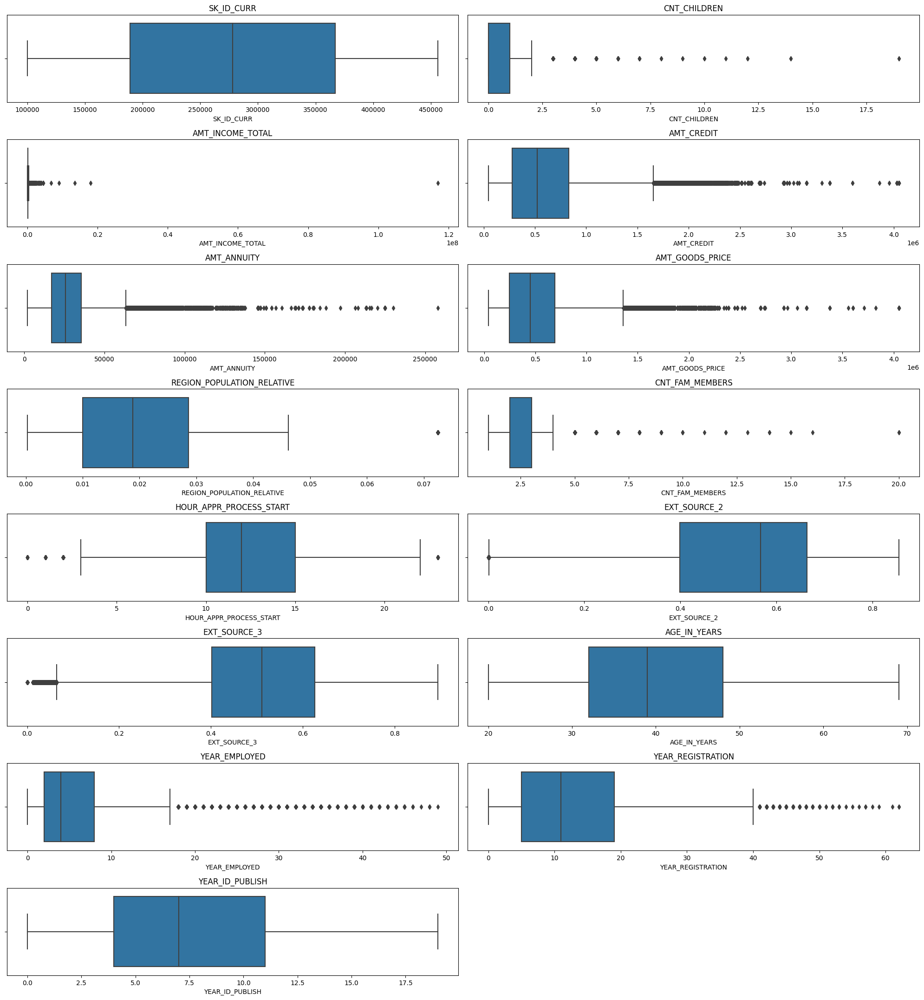

In [72]:

# Set the size of the figure and the number of rows and columns for subplots
num_rows = 15
num_cols = 2
subplot_index = 1

fig = plt.figure(figsize=(20, 40))

# Loop through columns and create box plots
for i in outlier_col:
    plt.subplot(num_rows, num_cols, subplot_index)
    plt.title('{}'.format(i))
    sns.boxplot(x=app_df[i])  # Use 'x' parameter to specify the column for box plot
    subplot_index = subplot_index + 1

fig.tight_layout()
plt.show()

#### **Display Show the percentiles for each column**

In [73]:
round(app_df[['CNT_CHILDREN', 'AMT_INCOME_TOTAL','AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE','REGION_POPULATION_RELATIVE','CNT_FAM_MEMBERS','HOUR_APPR_PROCESS_START','EXT_SOURCE_3']].describe(percentiles = [0.05, 0.25, 0.5, 0.75, 0.9, 0.95, .99]))

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,CNT_FAM_MEMBERS,HOUR_APPR_PROCESS_START,EXT_SOURCE_3
count,252123.0,252123.0,252123.0,252123.0,252123.0,252123.0,252123.0,252123.0,252123.0
mean,0.0,175912.0,611400.0,27812.0,549396.0,0.0,2.0,12.0,1.0
std,1.0,258858.0,406531.0,14648.0,373083.0,0.0,1.0,3.0,0.0
min,0.0,25650.0,45000.0,1980.0,40500.0,0.0,1.0,0.0,0.0
5%,0.0,72000.0,143910.0,9000.0,135000.0,0.0,1.0,7.0,0.0
25%,0.0,112500.0,277970.0,17073.0,247500.0,0.0,2.0,10.0,0.0
50%,0.0,157500.0,521280.0,25834.0,450000.0,0.0,2.0,12.0,1.0
75%,1.0,211500.0,829332.0,35618.0,693000.0,0.0,3.0,15.0,1.0
90%,2.0,270000.0,1170000.0,46701.0,1125000.0,0.0,4.0,17.0,1.0
95%,2.0,355269.0,1350000.0,53712.0,1332000.0,0.0,4.0,18.0,1.0


Having created box plots and computed percentiles for every numeric column, our current focus is on handling outliers within these numerical features. The reason for this emphasis lies in the potential of outliers to exert a substantial influence on our data calculations and analytical processes.

#### ***CNT_CHILDREN***

In [74]:

# CNT_CHILDREN shows a large outlier(19). A family cannot or very rare to have 19 children.
app_df['CNT_CHILDREN'].describe(percentiles = [0.75,0.85,0.90,0.95,0.99])

count    252123.000000
mean          0.498542
std           0.763173
min           0.000000
50%           0.000000
75%           1.000000
85%           1.000000
90%           2.000000
95%           2.000000
99%           3.000000
max          19.000000
Name: CNT_CHILDREN, dtype: float64

In [75]:
app_df['CNT_CHILDREN'].value_counts()

0     161897
1      59698
2      26365
3       3629
4        414
5         81
6         19
7          7
8          2
9          2
12         2
10         2
19         2
14         2
11         1
Name: CNT_CHILDREN, dtype: int64

In [76]:
# Convert CNT_CHILDREN column to integer type
app_df['CNT_CHILDREN'] = app_df['CNT_CHILDREN'].astype(int)

In [77]:
# Assuming an ideal scenario, we are considering that people have at most five children
IDEAL_CNT_CHILDREN=5
app_df["CNT_CHILDREN"] =  app_df.CNT_CHILDREN.apply(lambda x: IDEAL_CNT_CHILDREN if x>IDEAL_CNT_CHILDREN else x)
app_df['CNT_CHILDREN'].value_counts()

0    161897
1     59698
2     26365
3      3629
4       414
5       120
Name: CNT_CHILDREN, dtype: int64

#### We are generating box plots for the columns: AMT_INCOME_TOTAL, AMT_CREDIT, AMT_ANNUITY, and AMT_GOODS_PRICE. Due to the presence of huge outliers in these columns, we are addressing columns separately for outlier treatment.

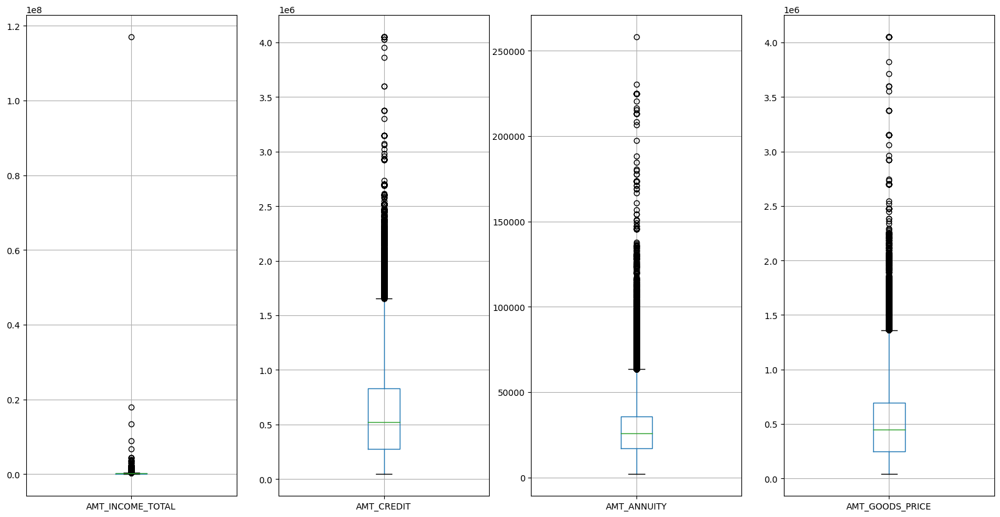

In [78]:
cols = ['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE']
plt.figure(figsize=(20,10))
for i, col in enumerate(cols):
    plt.subplot(1,4, i+1)
    app_df.boxplot(column = col)
plt.show()

#### This operation effectively caps the values in the columns at the 90 quartile value, limiting extreme values above 90 quartile. It can be useful for handling outliers or extreme values in the data, preventing them from disproportionately affecting analysis or modeling.

In [79]:
quantile_90th = app_df["AMT_INCOME_TOTAL"].quantile(0.90)
app_df["AMT_INCOME_TOTAL"] =  app_df.AMT_INCOME_TOTAL.apply(lambda x:  quantile_90th if x>quantile_90th else x)

In [80]:
quantile_90th=app_df["AMT_CREDIT"].quantile(0.90)
app_df["AMT_CREDIT"] =  app_df.AMT_CREDIT.apply(lambda x: quantile_90th if x>quantile_90th else x)

In [81]:
quantile_90th=app_df["AMT_ANNUITY"].quantile(0.90)
app_df["AMT_ANNUITY"] =  app_df.AMT_ANNUITY.apply(lambda x: quantile_90th if x>quantile_90th else x)

In [82]:
quantile_90th=app_df["AMT_GOODS_PRICE"].quantile(0.90)
app_df["AMT_GOODS_PRICE"] =  app_df.AMT_GOODS_PRICE.apply(lambda x: quantile_90th if x>quantile_90th else x)

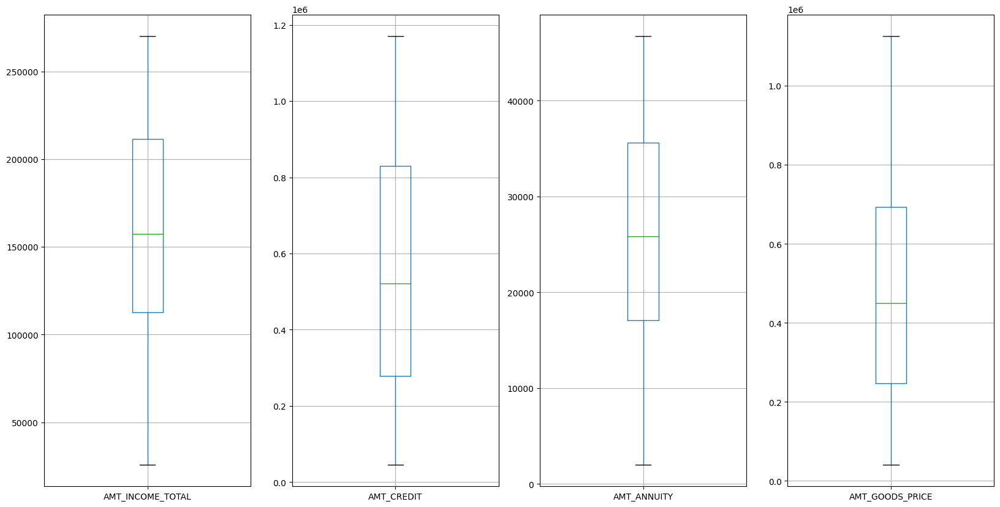

In [83]:
cols = ['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE']
plt.figure(figsize=(20,10))
for i, col in enumerate(cols):
    plt.subplot(1,4, i+1)
    app_df.boxplot(column = col)
plt.show()

####  ***Checking again percentiles 'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE'***

In [84]:
# Checking again
round(app_df[['CNT_CHILDREN', 'AMT_INCOME_TOTAL','AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE']].describe(percentiles = [0.05, 0.25, 0.5, 0.75, 0.9, 0.95, .99]),2)

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE
count,252123.00,252123.00,252123.00,252123.00,252123.00
mean,0.50,163496.95,580337.34,26671.14,525717.57
std,0.76,62772.16,333281.78,11745.16,312303.60
min,0.00,25650.00,45000.00,1980.00,40500.00
5%,0.00,72000.00,143910.00,9000.00,135000.00
25%,0.00,112500.00,277969.50,17073.00,247500.00
50%,0.00,157500.00,521280.00,25834.50,450000.00
75%,1.00,211500.00,829332.00,35617.50,693000.00
90%,2.00,270000.00,1170000.00,46701.00,1125000.00
95%,2.00,270000.00,1170000.00,46701.00,1125000.00


#### ***REGION_POPULATION_RELATIVE***

In [85]:
# Handling outliers for REGION_POPULATION_RELATIVE
app_df['REGION_POPULATION_RELATIVE'].describe()

count    252123.000000
mean          0.020894
std           0.013874
min           0.000290
25%           0.010006
50%           0.018850
75%           0.028663
max           0.072508
Name: REGION_POPULATION_RELATIVE, dtype: float64

In [86]:

q3=app_df["REGION_POPULATION_RELATIVE"].quantile(0.90)
app_df["REGION_POPULATION_RELATIVE"] =  app_df.REGION_POPULATION_RELATIVE.apply(lambda x: q3 if x>q3 else x)

q4=app_df["REGION_POPULATION_RELATIVE"].quantile(0.15)
app_df["REGION_POPULATION_RELATIVE"] =  app_df.REGION_POPULATION_RELATIVE.apply(lambda x: q4 if x<q4 else x)


app_df['REGION_POPULATION_RELATIVE'].describe()

count    252123.000000
mean          0.019703
std           0.009870
min           0.007305
25%           0.010006
50%           0.018850
75%           0.028663
max           0.035792
Name: REGION_POPULATION_RELATIVE, dtype: float64

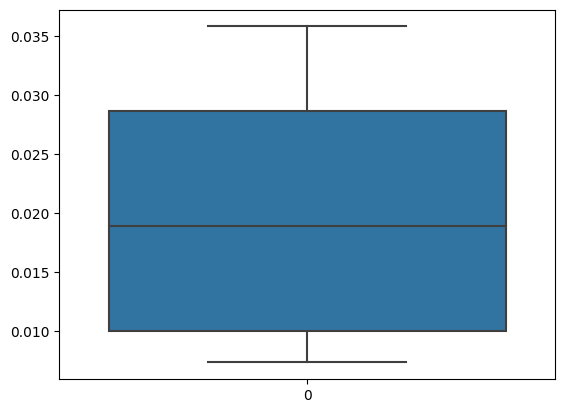

In [87]:
# checking again for outliers
outlier_plot = sns.boxplot(app_df['REGION_POPULATION_RELATIVE'])
plt.show()

#### ***CNT_FAM_MEMBERS***

In [88]:
# Handling outliers for CNT_FAM_MEMBERS
app_df['CNT_FAM_MEMBERS'].value_counts()

2.0     123321
3.0      51467
1.0      49046
4.0      24360
5.0       3417
6.0        396
7.0         78
8.0         19
9.0          6
10.0         3
14.0         2
12.0         2
20.0         2
13.0         1
15.0         1
16.0         1
11.0         1
Name: CNT_FAM_MEMBERS, dtype: int64

In [89]:
app_df['CNT_FAM_MEMBERS'].describe(percentiles = [0.75,0.85,0.90,0.95,0.99])

count    252123.000000
mean          2.252547
std           0.942127
min           1.000000
50%           2.000000
75%           3.000000
85%           3.000000
90%           4.000000
95%           4.000000
99%           5.000000
max          20.000000
Name: CNT_FAM_MEMBERS, dtype: float64

In [90]:
q3=app_df["CNT_FAM_MEMBERS"].quantile(0.95)
app_df["CNT_FAM_MEMBERS"] =  app_df.CNT_FAM_MEMBERS.apply(lambda x: q3 if x>q3 else x)

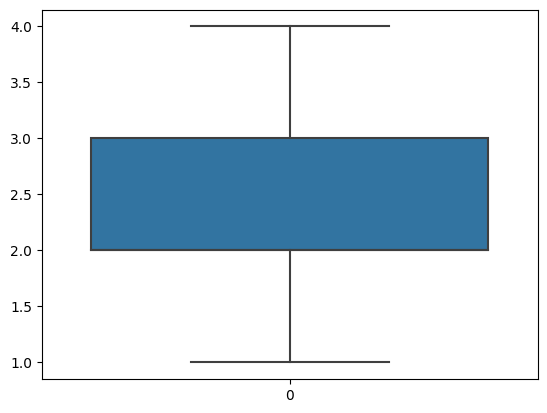

In [91]:
outlier_plot = sns.boxplot(app_df['CNT_FAM_MEMBERS'])
plt.show()

#### ***HOUR_APPR_PROCESS_START***

In [92]:
# Handling outliers for HOUR_APPR_PROCESS_START
app_df['HOUR_APPR_PROCESS_START'].value_counts()

11    29714
10    29670
12    27903
13    25682
14    23121
9     21168
15    21136
16    17750
17    13290
8     11581
18     8209
7      7127
6      4569
19     3519
5      2920
4      1706
20     1094
3      1033
21      366
2       267
22      141
1        80
23       39
0        38
Name: HOUR_APPR_PROCESS_START, dtype: int64

In [93]:
app_df['HOUR_APPR_PROCESS_START'].describe(percentiles = [0.10,0.15,0.20,0.25,0.75,0.85,0.90,0.95,0.99])

count    252123.000000
mean         12.203202
std           3.299824
min           0.000000
10%           8.000000
15%           9.000000
20%           9.000000
25%          10.000000
50%          12.000000
75%          15.000000
85%          16.000000
90%          17.000000
95%          18.000000
99%          19.000000
max          23.000000
Name: HOUR_APPR_PROCESS_START, dtype: float64

In [94]:
q3=app_df["HOUR_APPR_PROCESS_START"].quantile(0.95)
app_df["HOUR_APPR_PROCESS_START"] =  app_df.HOUR_APPR_PROCESS_START.apply(lambda x: q3 if x>q3 else x)

q4=app_df["HOUR_APPR_PROCESS_START"].quantile(0.15)
app_df["HOUR_APPR_PROCESS_START"] =  app_df.HOUR_APPR_PROCESS_START.apply(lambda x: q4 if x<q4 else x)


app_df['HOUR_APPR_PROCESS_START'].describe()

count    252123.000000
mean         12.446088
std           2.787133
min           9.000000
25%          10.000000
50%          12.000000
75%          15.000000
max          18.000000
Name: HOUR_APPR_PROCESS_START, dtype: float64

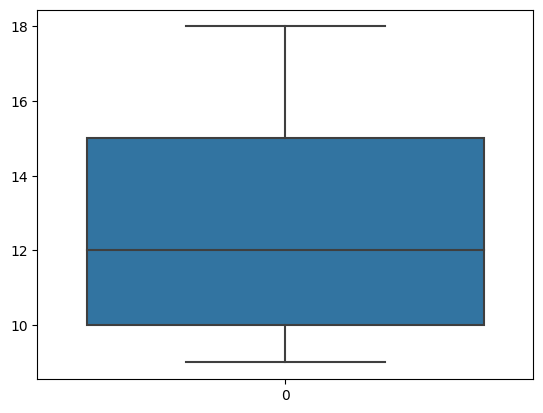

In [95]:
outlier_plot = sns.boxplot(app_df['HOUR_APPR_PROCESS_START'])
plt.show()

#### ***EXT_SOURCE_3***

In [96]:
# Handling outliers for EXT_SOURCE_3
app_df['EXT_SOURCE_3'].describe(percentiles = [0.10,0.15,0.20,0.25,0.75,0.85,0.90,0.95,0.99])

count    252123.000000
mean          0.502425
std           0.175595
min           0.000527
10%           0.245851
15%           0.304672
20%           0.355639
25%           0.401407
50%           0.510853
75%           0.626304
85%           0.692559
90%           0.728141
95%           0.771362
99%           0.829750
max           0.893976
Name: EXT_SOURCE_3, dtype: float64

In [97]:
q3=app_df["EXT_SOURCE_3"].quantile(0.95)
app_df["EXT_SOURCE_3"] =  app_df.EXT_SOURCE_3.apply(lambda x: q3 if x>q3 else x)

q4=app_df["EXT_SOURCE_3"].quantile(0.15)
app_df["EXT_SOURCE_3"] =  app_df.EXT_SOURCE_3.apply(lambda x: q4 if x<q4 else x)


app_df['EXT_SOURCE_3'].describe()

count    252123.000000
mean          0.516780
std           0.143471
min           0.304672
25%           0.401407
50%           0.510853
75%           0.626304
max           0.771362
Name: EXT_SOURCE_3, dtype: float64

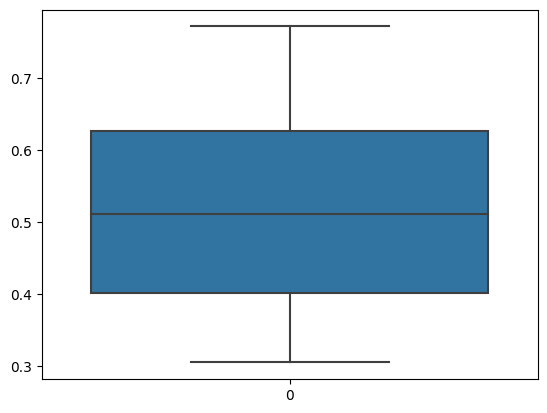

In [98]:
outlier_plot = sns.boxplot(app_df['EXT_SOURCE_3'])
plt.show()

In [99]:
app_df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,AGE_IN_YEARS,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10.0,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.304672,25,1,9.0,5
1,100003,0,Cash loans,F,N,N,0,270000.0,1170000.0,35698.5,1125000.0,Family,State servant,Higher education,Married,House / apartment,0.007305,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11.0,0,0,0,0,0,0,School,0.622246,0.510853,45,3,3.0,0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9.0,0,0,0,0,0,0,Government,0.555912,0.729567,52,0,11.0,6
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17.0,0,0,0,0,0,0,Business Entity Type 3,0.650442,0.510853,52,8,26.0,6
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11.0,0,0,0,0,1,1,Religion,0.322738,0.510853,54,8,11.0,9


####We have successfully capped the outliers in our dataset, and upon analyzing the percentiles, it appears that the data is now in a satisfactory state. The outlier management has helped us achieve a more reliable and stable dataset for our analysis.

## **Data visualization**

### **Univariate Analysis**

Univariate analysis is a statistical method employed in data analysis to explore and comprehend the characteristics of an individual variable independently, without considering its associations with other variables. This analytical approach provides a deeper understanding of the variable's distribution, central tendencies, variability, and overall behavior within the dataset.

In our current analysis, we have identified specific fields that will be utilized for creating bins and generating bar graphs. These selected fields will serve as the foundation for our data segmentation and visualization endeavors, enabling us to extract valuable insights and discern patterns from the data they encompass.

#### ***AGE_IN_YEARS***

In [100]:
app_df['AGE_IN_YEARS'].describe()


count    252123.000000
mean         39.963228
std          10.033187
min          20.000000
25%          32.000000
50%          39.000000
75%          48.000000
max          69.000000
Name: AGE_IN_YEARS, dtype: float64

In [101]:
# Binning AGE_IN_YEARS and Creating new column "AGE_IN_YEARS_GROUP"
bins = list(range(0, 71, 10))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
app_df['AGE_IN_YEARS_GROUP']= pd.cut(app_df.AGE_IN_YEARS,bins=bins, labels=labels,include_lowest=True)

app_df['AGE_IN_YEARS_GROUP'].value_counts()

30-40    82549
40-50    72173
20-30    52631
50-60    40288
60-70     4481
10-20        1
0-10         0
Name: AGE_IN_YEARS_GROUP, dtype: int64

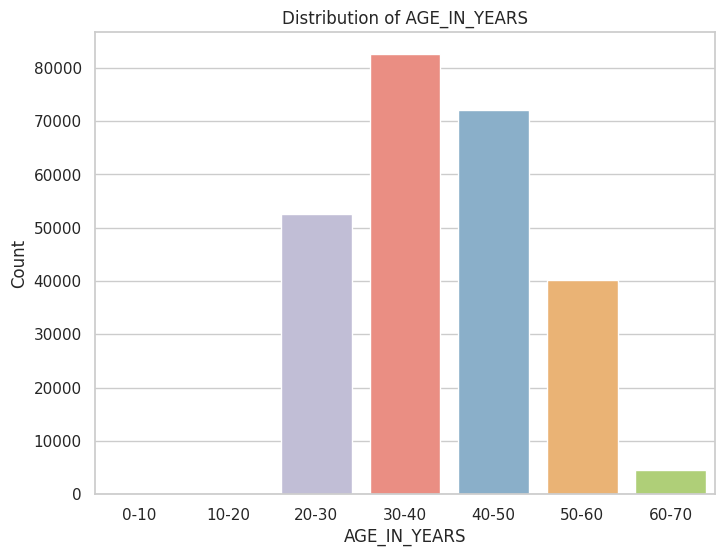

In [102]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))
sns.countplot(data=app_df, x='AGE_IN_YEARS_GROUP', palette="Set3")

plt.xlabel("AGE_IN_YEARS")
plt.ylabel("Count")
plt.title("Distribution of AGE_IN_YEARS")
plt.show()

***Notable Point***

* Based on the count graph for the "Age_in_years" category, there are no applicants aged between 0 and 20 years.
* The majority of applicants fall into the age category of 30 to 40 years, indicating the highest number of applicants in this age group.

#### ***YEAR_EMPLOYED***

In [103]:
app_df['YEAR_EMPLOYED'].describe(percentiles = [0.10,0.15,0.20,0.25,0.75,0.85,0.90,0.95,0.99])


count    252123.000000
mean          6.037065
std           6.416207
min           0.000000
10%           0.000000
15%           1.000000
20%           1.000000
25%           2.000000
50%           4.000000
75%           8.000000
85%          11.000000
90%          14.000000
95%          19.000000
99%          31.000000
max          49.000000
Name: YEAR_EMPLOYED, dtype: float64

In [104]:
# hanlding outliers in YEAR_EMPLOYED
q3=app_df["YEAR_EMPLOYED"].quantile(0.95)
app_df["YEAR_EMPLOYED"] =  app_df.YEAR_EMPLOYED.apply(lambda x: q3 if x>q3 else x)
app_df['YEAR_EMPLOYED'].describe()

count    252123.000000
mean          5.688945
std           5.305871
min           0.000000
25%           2.000000
50%           4.000000
75%           8.000000
max          19.000000
Name: YEAR_EMPLOYED, dtype: float64

In [105]:
# Binning YEAR_EMPLOYED and Creating new column "YEAR_EMPLOYED_GROUP"
bins = list(range(0, 21, 2))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
app_df['YEAR_EMPLOYED_GROUP']= pd.cut(app_df.YEAR_EMPLOYED,bins=bins, labels=labels,include_lowest=True)

app_df['YEAR_EMPLOYED_GROUP'].value_counts()


0-2      89390
2-4      46871
4-6      31318
6-8      24587
8-10     16341
18-20    14429
10-12    11211
12-14     8992
14-16     5060
16-18     3924
Name: YEAR_EMPLOYED_GROUP, dtype: int64

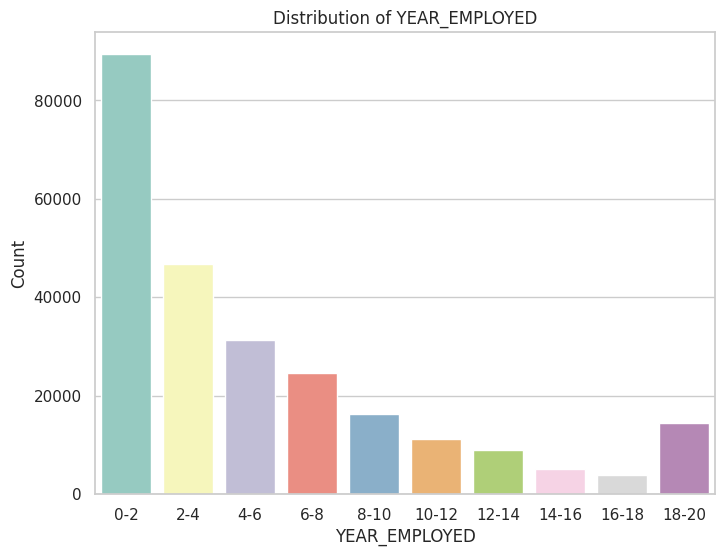

In [106]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))
sns.countplot(data=app_df, x='YEAR_EMPLOYED_GROUP', palette="Set3")

plt.xlabel("YEAR_EMPLOYED")
plt.ylabel("Count")
plt.title("Distribution of YEAR_EMPLOYED")
plt.show()

***Notable Ponts***

* The graph reveals that the highest frequency of applicants falls into the category of 0 to 2 years of employment before the application.
* Notably, as the number of years of employment increases, the frequency of applicants decreases, with the category of 16 to 18 years of employment having the lowest representation.

#### ***YEAR_REGISTRATION***

In [107]:
app_df['YEAR_REGISTRATION'].describe(percentiles = [0.10,0.15,0.20,0.25,0.75,0.85,0.90,0.95,0.99])
app_df['YEAR_REGISTRATION'].value_counts()

0.0     14645
1.0     13775
2.0     13092
3.0     11332
12.0    11175
11.0    10778
13.0    10733
7.0     10007
8.0      9709
4.0      9662
6.0      9417
9.0      9180
10.0     9131
14.0     8768
5.0      8669
16.0     7478
15.0     7390
17.0     7114
19.0     6762
18.0     6703
20.0     6331
22.0     6234
21.0     6121
23.0     5825
24.0     5416
25.0     4762
26.0     4300
27.0     3664
28.0     2830
29.0     2164
30.0     1737
31.0     1476
32.0     1247
33.0      954
34.0      830
35.0      651
36.0      541
37.0      415
38.0      301
39.0      194
40.0      168
41.0       99
42.0       88
43.0       66
44.0       41
46.0       29
47.0       28
45.0       28
48.0       14
49.0       13
50.0       13
52.0        7
53.0        4
57.0        2
51.0        2
62.0        2
56.0        1
58.0        1
59.0        1
55.0        1
54.0        1
61.0        1
Name: YEAR_REGISTRATION, dtype: int64

In [108]:
# hanlding outliers in YEAR_REGISTRATION
q3=app_df["YEAR_REGISTRATION"].quantile(0.99)
app_df["YEAR_REGISTRATION"] =  app_df.YEAR_REGISTRATION.apply(lambda x: q3 if x>q3 else x)
app_df['YEAR_REGISTRATION'].value_counts()

q4=app_df["YEAR_REGISTRATION"].quantile(0.15)
app_df["YEAR_REGISTRATION"] =  app_df.YEAR_REGISTRATION.apply(lambda x: q4 if x<q4 else x)
app_df['YEAR_REGISTRATION'].describe()


count    252123.000000
mean         12.347572
std           8.594054
min           2.000000
25%           5.000000
50%          11.000000
75%          19.000000
max          35.000000
Name: YEAR_REGISTRATION, dtype: float64

In [109]:
# Binning YEAR_REGISTRATION and Creating new column "YEAR_REGISTRATION_GROUP"
bins = list(range(0, 40, 5))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
app_df['YEAR_REGISTRATION_GROUP']= pd.cut(app_df.YEAR_REGISTRATION,bins=bins, labels=labels,include_lowest=True)

app_df['YEAR_REGISTRATION_GROUP'].value_counts()


0-5      71175
10-15    48844
5-10     47444
15-20    34388
20-25    28358
25-30    14695
30-35     7219
Name: YEAR_REGISTRATION_GROUP, dtype: int64

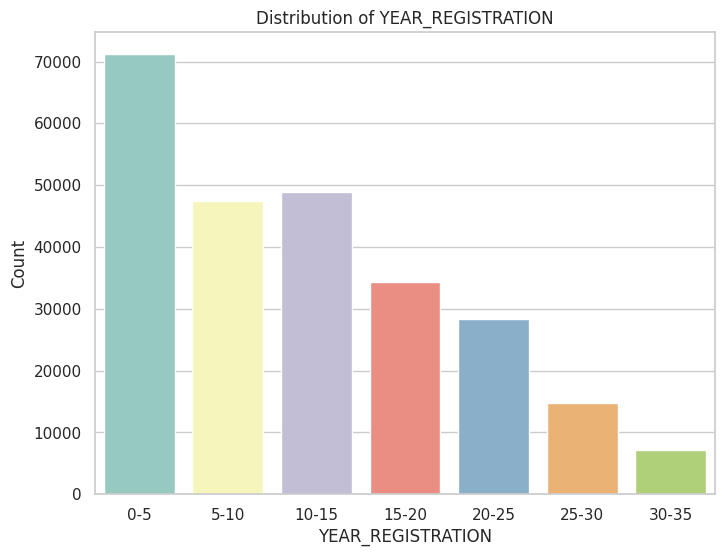

In [110]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))
sns.countplot(data=app_df, x='YEAR_REGISTRATION_GROUP', palette="Set3")

plt.xlabel("YEAR_REGISTRATION")
plt.ylabel("Count")
plt.title("Distribution of YEAR_REGISTRATION")
plt.show()

***Notable Points***

* The graph reveals that the highest frequency of applicants falls into the category of 0 to 2 years of employment before the application.
* Notably, as the number of years of employment increases, the frequency of applicants decreases, with the category of 16 to 18 years of employment having the lowest representation.

#### ***YEAR_ID_PUBLISH***

In [111]:
app_df['YEAR_ID_PUBLISH'].describe(percentiles = [0.10,0.15,0.20,0.25,0.75,0.85,0.90,0.95,0.99])
app_df['YEAR_ID_PUBLISH'].value_counts()

11    29758
12    25967
7     17386
6     16807
2     16505
8     16446
3     16212
9     16181
5     15886
4     15623
10    15608
1     14988
0     14132
13    13959
14     4275
15     1654
16      704
17       31
19        1
Name: YEAR_ID_PUBLISH, dtype: int64

In [112]:
# hanlding outliers in YEAR_ID_PUBLISH
q3=app_df["YEAR_ID_PUBLISH"].quantile(0.99)
app_df["YEAR_ID_PUBLISH"] =  app_df.YEAR_ID_PUBLISH.apply(lambda x: q3 if x>q3 else x)
app_df['YEAR_ID_PUBLISH'].value_counts()

11.0    29758
12.0    25967
7.0     17386
6.0     16807
2.0     16505
8.0     16446
3.0     16212
9.0     16181
5.0     15886
4.0     15623
10.0    15608
1.0     14988
0.0     14132
13.0    13959
14.0     6665
Name: YEAR_ID_PUBLISH, dtype: int64

In [113]:
# Binning YEAR_ID_PUBLISH and Creating new column "YEAR_ID_PUBLISH_GROUP"
bins = list(range(0, 16, 2))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]

app_df['YEAR_ID_PUBLISH_GROUP']= pd.cut(app_df.YEAR_ID_PUBLISH,bins=bins, labels=labels,include_lowest=True)

app_df['YEAR_ID_PUBLISH_GROUP'].value_counts()

10-12    55725
0-2      45625
6-8      33832
4-6      32693
2-4      31835
8-10     31789
12-14    20624
Name: YEAR_ID_PUBLISH_GROUP, dtype: int64

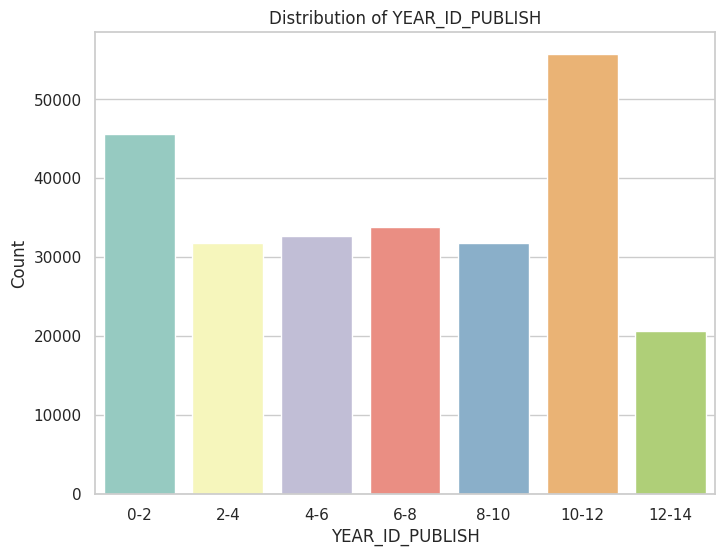

In [114]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))
sns.countplot(data=app_df, x='YEAR_ID_PUBLISH_GROUP', palette="Set3")

plt.xlabel("YEAR_ID_PUBLISH")
plt.ylabel("Count")
plt.title("Distribution of YEAR_ID_PUBLISH")
plt.show()

***Notable Points***

* According to the graph, the category of 10 to 12 years before the application has the highest frequency of applicants. Notably, all categories have counts exceeding 20,000.
* Conversely, the category of 12 to 14 years before the application has a lower frequency compared to other categories.

#### ***AMT_INCOME_TOTAL***

In [115]:
app_df['AMT_INCOME_TOTAL'].describe().apply(lambda x: '%.2f' % x)

count    252123.00
mean     163496.95
std       62772.16
min       25650.00
25%      112500.00
50%      157500.00
75%      211500.00
max      270000.00
Name: AMT_INCOME_TOTAL, dtype: object

In [116]:
# Creating bins for Total income amount
bins = list(range(0, 300001, 60000))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 240000"
app_df['AMT_INCOME_TOTAL_GROUP']= pd.cut(app_df.AMT_INCOME_TOTAL,bins=bins, labels=labels,include_lowest=True)

app_df['AMT_INCOME_TOTAL_GROUP'].value_counts()


120000-180000       94875
60000-120000        71282
More than 240000    41288
180000-240000       40667
0-60000              4011
Name: AMT_INCOME_TOTAL_GROUP, dtype: int64

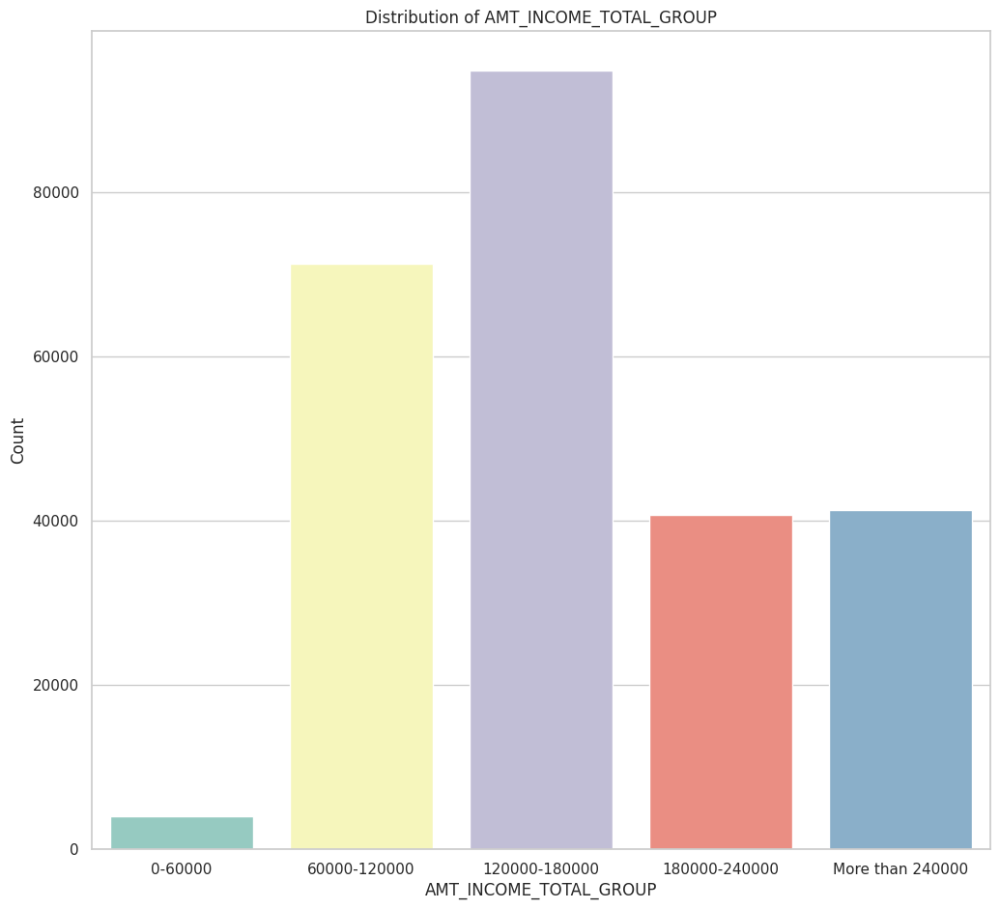

In [117]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(12, 11))
sns.countplot(data=app_df, x='AMT_INCOME_TOTAL_GROUP', palette="Set3")

plt.xlabel("AMT_INCOME_TOTAL_GROUP")
plt.ylabel("Count")
plt.title("Distribution of AMT_INCOME_TOTAL_GROUP")
plt.show()

***Notable Points***

* After grouping the income data into AMT_INCOME_TOTAL_GROUP bins, the graph reveals that the highest number of applicants falls into the income range of 120,000 to 180,000 in the AMT_INCOME_TOTAL_GROUP.
* Conversely, the lowest number of applicants are found in the income range of 0 to 60,000, according to the graph.

#### ***AMT_CREDIT***

In [118]:
app_df['AMT_CREDIT'].describe().apply(lambda x: '%.2f' % x)

count     252123.00
mean      580337.34
std       333281.78
min        45000.00
25%       277969.50
50%       521280.00
75%       829332.00
max      1170000.00
Name: AMT_CREDIT, dtype: object

In [119]:
# Creating bins for CREDIT amount
bins = list(range(0, 1200001, 200000))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 1000000"
app_df['AMT_CREDIT_GROUP']= pd.cut(app_df.AMT_CREDIT,bins=bins, labels=labels,include_lowest=True)

app_df['AMT_CREDIT_GROUP'].value_counts()

200000-400000        64346
400000-600000        55026
More than 1000000    43141
600000-800000        35129
0-200000             28368
800000-1000000       26113
Name: AMT_CREDIT_GROUP, dtype: int64

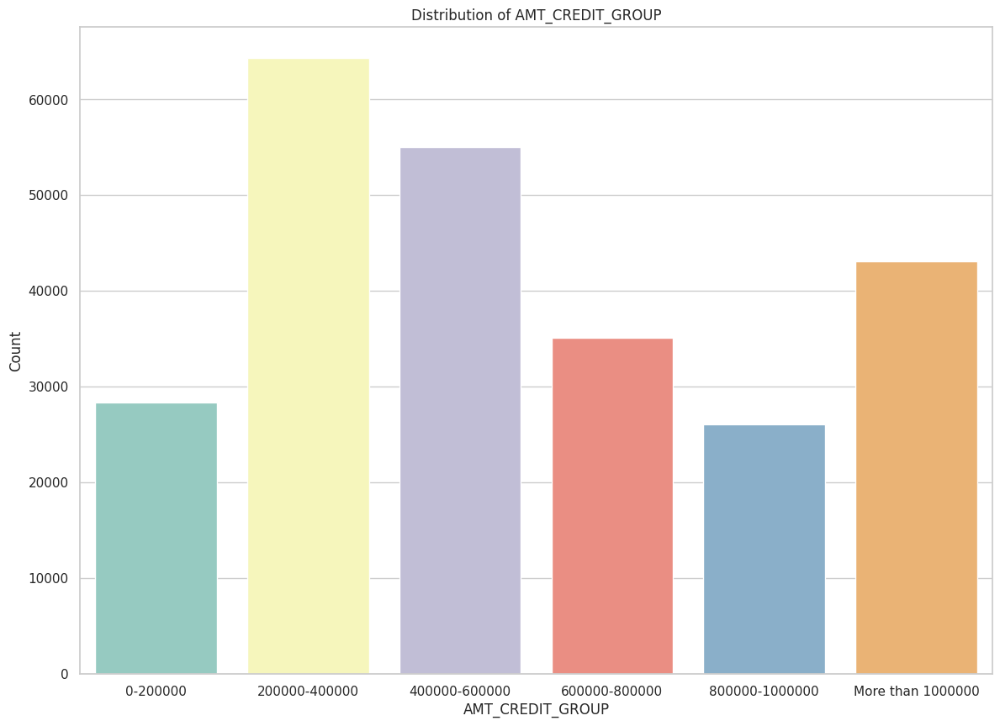

In [120]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(14, 10))
sns.countplot(data=app_df, x='AMT_CREDIT_GROUP', palette="Set3")

plt.xlabel("AMT_CREDIT_GROUP")
plt.ylabel("Count")
plt.title("Distribution of AMT_CREDIT_GROUP")
plt.show()

***Notable Points***

* Following the binning of AMT_CREDIT into AMT_CREDIT_TOTAL_GROUP categories, the graph illustrates that the largest applicant count is observed within the credit amount range of 200,000 to 400,000 in the AMT_CREDIT_TOTAL_GROUP.
* Conversely, the lowest number of applicants is found in the credit amount range of 800,000 to 1,000,000, as depicted in the graph.

#### ***AMT_ANNUITY***

In [121]:
app_df['AMT_ANNUITY'].describe().apply(lambda x: '%.2f' % x)

count    252123.00
mean      26671.14
std       11745.16
min        1980.00
25%       17073.00
50%       25834.50
75%       35617.50
max       46701.00
Name: AMT_ANNUITY, dtype: object

In [122]:
# Creating bins for ANNUITY amount
bins = list(range(0, 50001, 10000))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 40000"

app_df['AMT_ANNUITY_GROUP']= pd.cut(app_df.AMT_ANNUITY,bins=bins, labels=labels,include_lowest=True)

app_df['AMT_ANNUITY_GROUP'].value_counts()

20000-30000        75632
10000-20000        63656
30000-40000        51013
More than 40000    43762
0-10000            18060
Name: AMT_ANNUITY_GROUP, dtype: int64

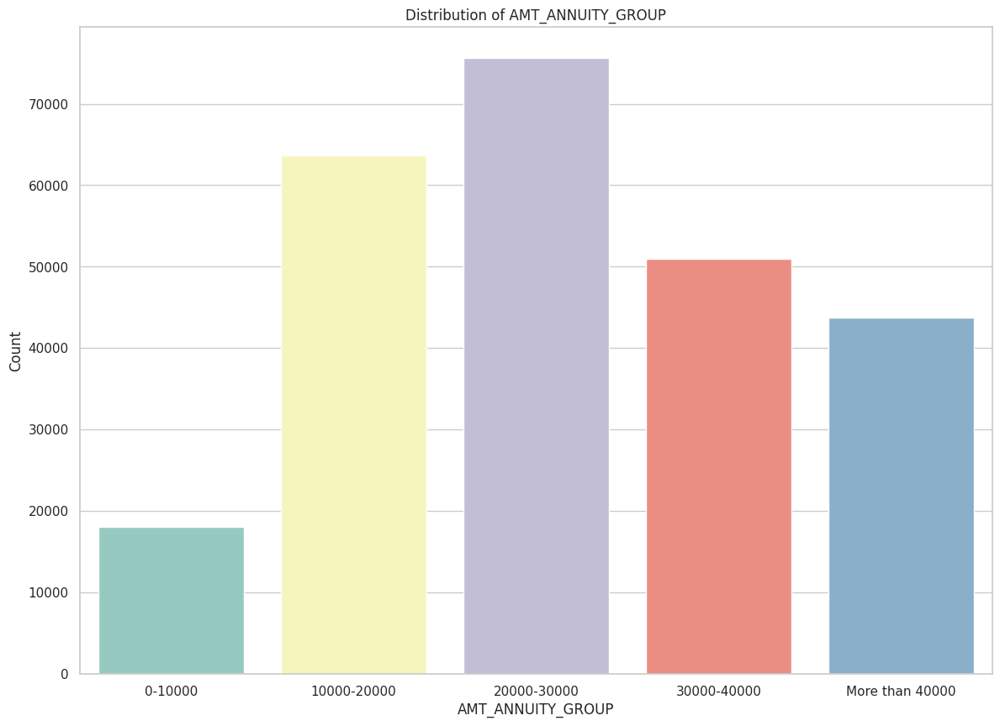

In [123]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(14, 10))
sns.countplot(data=app_df, x='AMT_ANNUITY_GROUP', palette="Set3")

plt.xlabel("AMT_ANNUITY_GROUP")
plt.ylabel("Count")
plt.title("Distribution of AMT_ANNUITY_GROUP")
plt.show()

***Notable Points***

* Upon dividing AMT_ANNUITY into AMT_ANNUITY_GROUP categories, the graph reveals that the largest number of applicants can be found within the Loan annuity range of 20,000 to 300,000 in the AMT_ANNUITY_GROUP.
* Conversely, the lowest count of applicants is identified within the Loan annuity range of 0 to 10,000, as illustrated by the graph.

#### ***AMT_GOODS_PRICE***

In [124]:
app_df['AMT_GOODS_PRICE'].describe().apply(lambda x: '%.2f' % x)

count     252123.00
mean      525717.57
std       312303.60
min        40500.00
25%       247500.00
50%       450000.00
75%       693000.00
max      1125000.00
Name: AMT_GOODS_PRICE, dtype: object

In [125]:
# Creating bins for GOODS PRICE amount
bins = list(range(0, 1200001, 200000))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 1000000"

app_df['AMT_GOODS_PRICE_GROUP']= pd.cut(app_df.AMT_GOODS_PRICE,bins=bins, labels=labels,include_lowest=True)

app_df['AMT_GOODS_PRICE_GROUP'].value_counts()

200000-400000        66971
400000-600000        58424
600000-800000        39236
0-200000             32664
More than 1000000    29151
800000-1000000       25677
Name: AMT_GOODS_PRICE_GROUP, dtype: int64

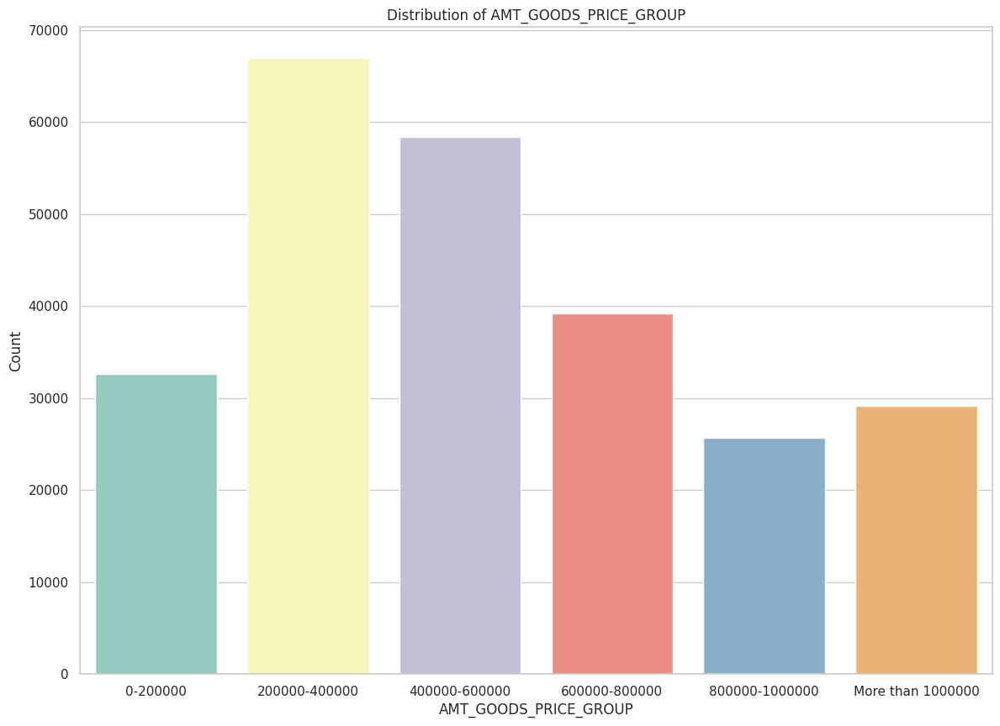

In [126]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(14, 10))
sns.countplot(data=app_df, x='AMT_GOODS_PRICE_GROUP', palette="Set3")

plt.xlabel("AMT_GOODS_PRICE_GROUP")
plt.ylabel("Count")
plt.title("Distribution of AMT_GOODS_PRICE_GROUP")
plt.show()

***Notable Points***

* After grouping AMT_GOODS_PRICE into AMT_GOODS_PRICE_GROUP categories, the graph highlights that the largest number of applicants can be found within the range of 200,000 to 400,000 for the price of goods in the AMT_GOODS_PRICE_GROUP.
* Conversely, the graph illustrates that the lowest count of applicants is within the range of 800,000 to 1,000,000 for the price of goods in this grouping.

#### ***Creating Countplot and Histogram Visualizations for Other Fields***

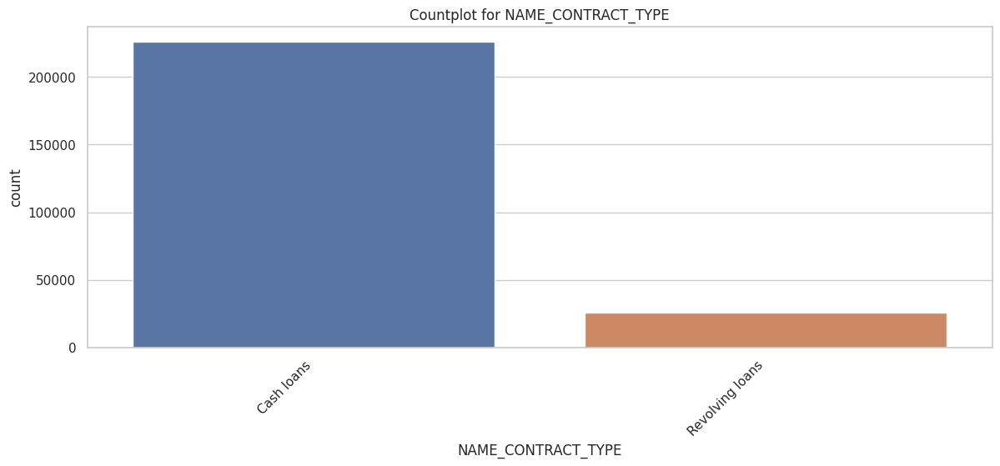

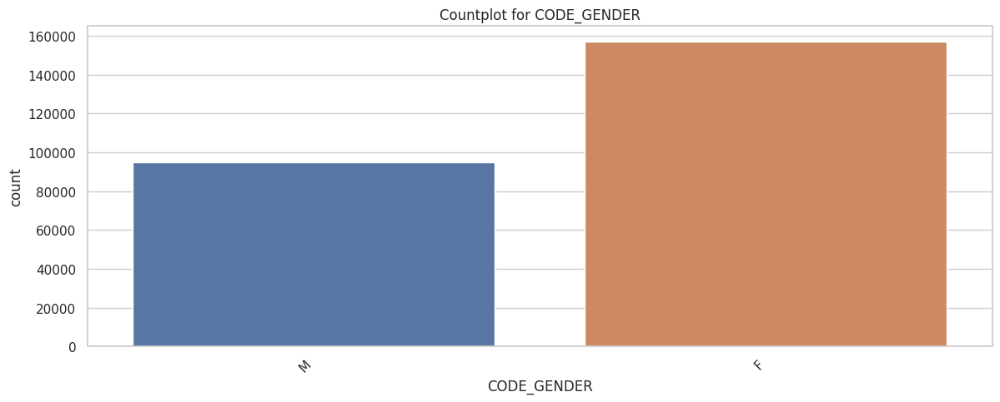

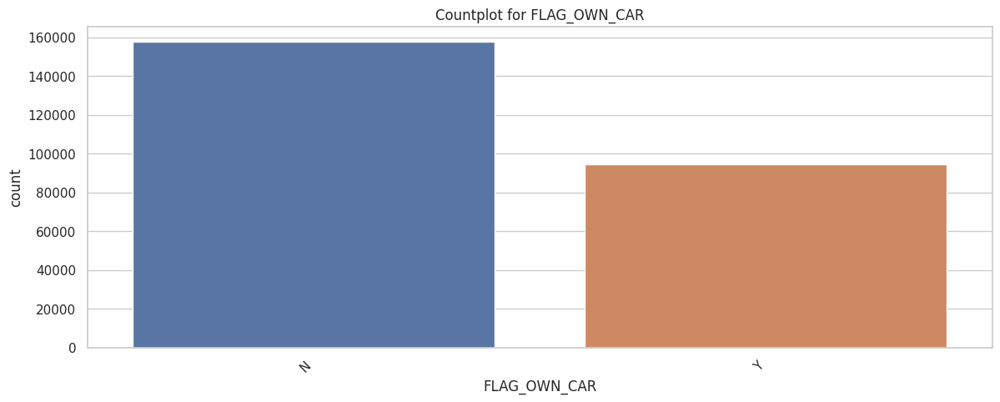

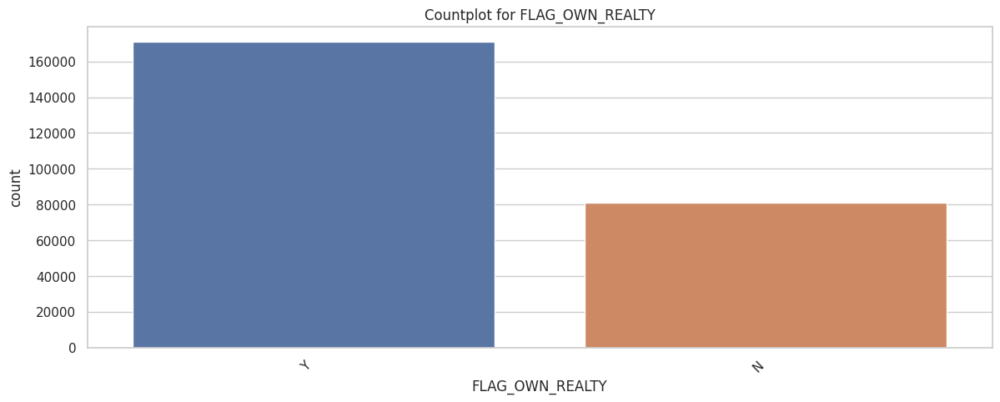

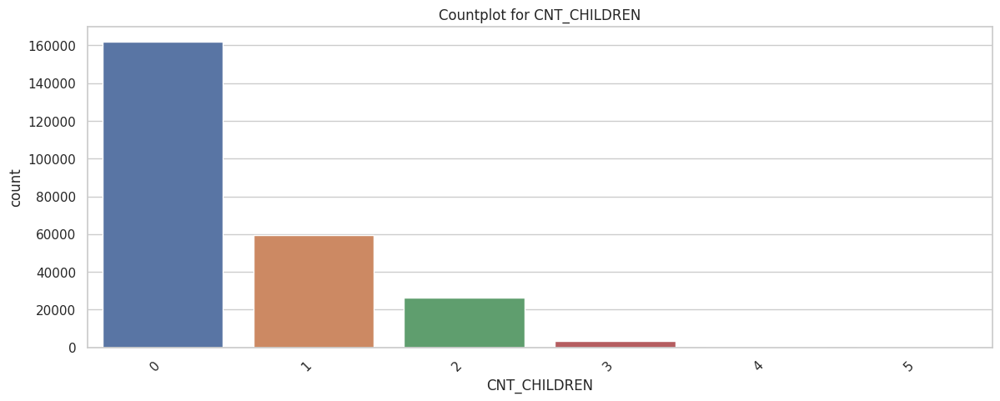

...

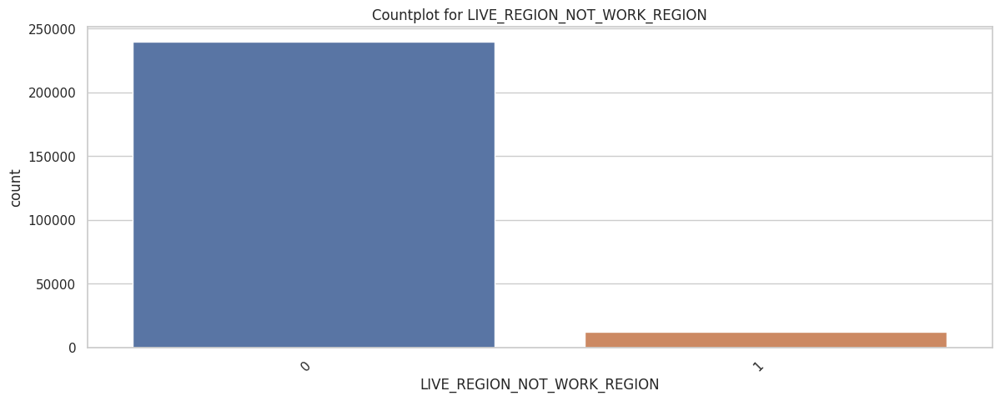

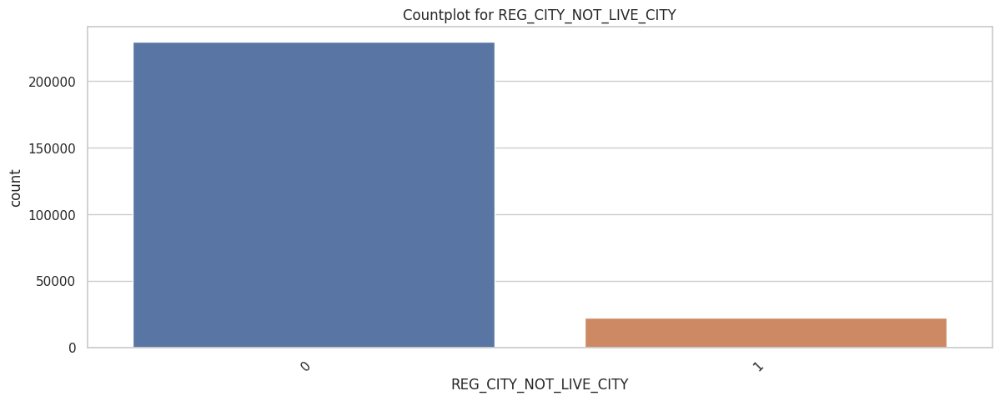

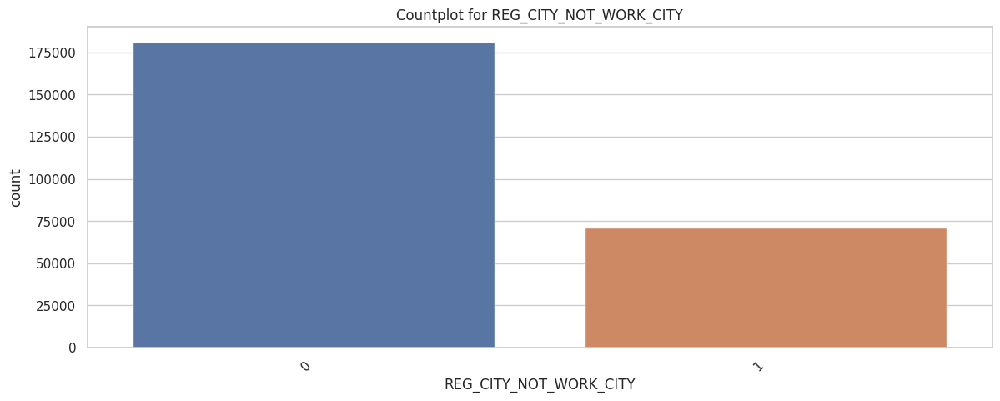

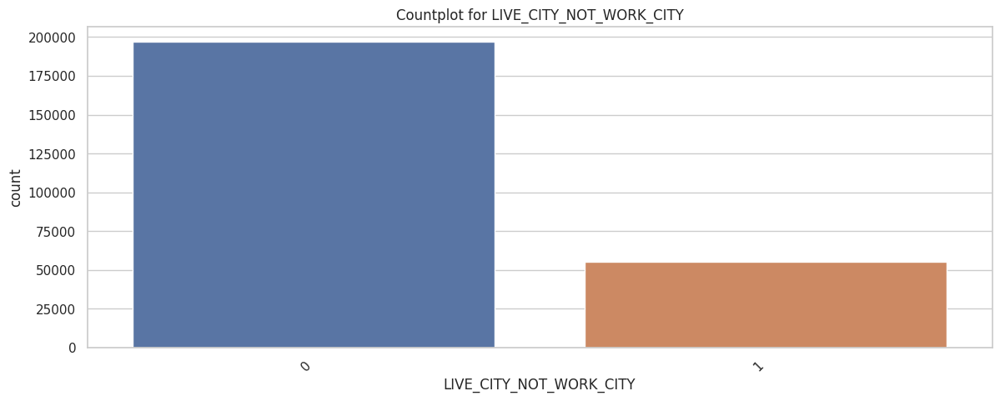

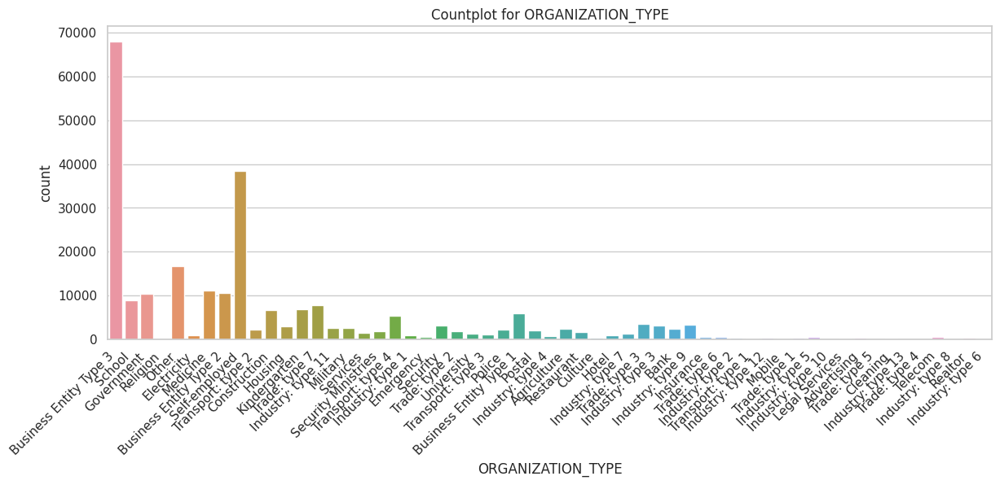

In [127]:
objvarList = ['NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'NAME_TYPE_SUITE',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'FLAG_MOBIL',
       'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE',
       'FLAG_EMAIL', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY','ORGANIZATION_TYPE']
for i in objvarList:
    plt.figure(figsize=(14, 5))
    ax = sns.countplot(x=i, data=app_df)
    plt.title('Countplot for {}'.format(i))
    ax.set(xlabel=i)
    temp = ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')

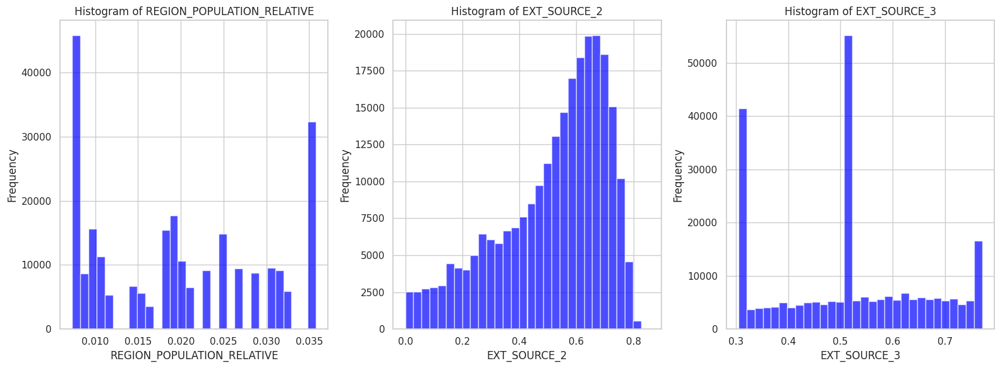

In [128]:
fields_to_plot = ['REGION_POPULATION_RELATIVE', 'EXT_SOURCE_2', 'EXT_SOURCE_3']

plt.figure(figsize=(16, 6))

for i, field in enumerate(fields_to_plot, 1):
    plt.subplot(1, 3, i)
    plt.hist(app_df[field], bins=30, color='blue', alpha=0.7)
    plt.xlabel(field)
    plt.ylabel('Frequency')
    plt.title(f'Histogram of {field}')
    plt.grid(True)

plt.tight_layout()
plt.show()

In our data analysis process, we have generated count plots and histograms to visualize various fields in our dataset. These visualizations help us better understand the distribution, patterns, and characteristics of the data, enabling us to gain valuable insights for further analysis.

### **Data Imbalance**


Data imbalance happens when there are a lot more examples of one thing than another in a dataset. It's like having a box of mostly red marbles and only a few blue ones. This can make it hard for computers to learn about the less common things because they see so much of the more common ones

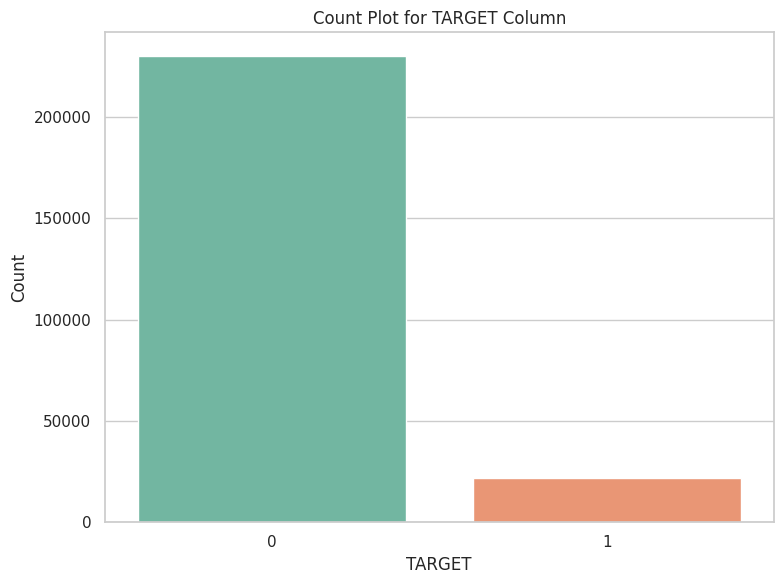

In [129]:
plt.figure(figsize=(8, 6))
sns.countplot(x='TARGET', data=app_df, palette="Set2")
plt.xlabel('TARGET')
plt.ylabel('Count')
plt.title('Count Plot for TARGET Column')
plt.xticks(rotation=0)  # No rotation needed for binary categories (0 and 1)
plt.tight_layout()
plt.show()

The target variable indicates a data imbalance, with a value of 1 representing clients who experienced payment difficulties (late payments on some early installments), and a value of 0 representing all other cases.

In [130]:
# checking for data imbalance

app_df.TARGET.value_counts(normalize=True)*100

0    91.339545
1     8.660455
Name: TARGET, dtype: float64

In [131]:
# Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample,
#  0 - all other cases), it depicts that there is a data imbalance.
# Calculating data imbalance ratio

round(len(app_df[app_df.TARGET==0]) / len(app_df[app_df.TARGET==1]),2)

10.55

**Notable Point**:

1 in every 10 applicant has payment difficulty.

### **Segmented Univariate analysis and Bivariate analysis**

In [132]:
app_df_0=app_df[app_df['TARGET']==0]
app_df_0.shape

(230288, 50)

 "app_df_0" represents a subset of the dataset consisting of applicants who do not face difficulties in repaying loans, typically indicated by a "TARGET" value of 0. This subset is used for analysis of applicants in all other cases where there are no payment difficulties.

In [133]:
app_df_1=app_df[app_df['TARGET']==1]
app_df_1.shape

(21835, 50)

"app_df_1" is a subset of the dataset that includes applicants who are experiencing difficulty paying their loans, typically characterized by a "TARGET" value of 1. This subset allows for focused analysis on this specific group of applicants

In [134]:

app_df_0.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,AGE_IN_YEARS,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH,AGE_IN_YEARS_GROUP,YEAR_EMPLOYED_GROUP,YEAR_REGISTRATION_GROUP,YEAR_ID_PUBLISH_GROUP,AMT_INCOME_TOTAL_GROUP,AMT_CREDIT_GROUP,AMT_ANNUITY_GROUP,AMT_GOODS_PRICE_GROUP
1,100003,0,Cash loans,F,N,N,0,270000.0,1170000.0,35698.5,1125000.0,Family,State servant,Higher education,Married,House / apartment,0.007305,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11.0,0,0,0,0,0,0,School,0.622246,0.510853,45,3.0,3.0,0.0,40-50,2-4,0-5,0-2,More than 240000,More than 1000000,30000-40000,More than 1000000
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9.0,0,0,0,0,0,0,Government,0.555912,0.729567,52,0.0,11.0,6.0,50-60,0-2,10-15,4-6,60000-120000,0-200000,0-10000,0-200000
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.008019,1,1,0,1,0,0,Laborers,2.0,2,2,WEDNESDAY,17.0,0,0,0,0,0,0,Business Entity Type 3,0.650442,0.510853,52,8.0,26.0,6.0,50-60,6-8,25-30,4-6,120000-180000,200000-400000,20000-30000,200000-400000
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.028663,1,1,0,1,0,0,Core staff,1.0,2,2,THURSDAY,11.0,0,0,0,0,1,1,Religion,0.322738,0.510853,54,8.0,11.0,9.0,50-60,6-8,10-15,8-10,120000-180000,400000-600000,20000-30000,400000-600000
5,100008,0,Cash loans,M,N,Y,0,99000.0,490495.5,27517.5,454500.0,"Spouse, partner",State servant,Secondary / secondary special,Married,House / apartment,0.035792,1,1,1,1,1,0,Laborers,2.0,2,2,WEDNESDAY,16.0,0,0,0,0,0,0,Other,0.354225,0.621226,46,4.0,13.0,1.0,40-50,2-4,10-15,0-2,60000-120000,400000-600000,20000-30000,400000-600000


In [135]:
app_df_1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,AGE_IN_YEARS,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH,AGE_IN_YEARS_GROUP,YEAR_EMPLOYED_GROUP,YEAR_REGISTRATION_GROUP,YEAR_ID_PUBLISH_GROUP,AMT_INCOME_TOTAL_GROUP,AMT_CREDIT_GROUP,AMT_ANNUITY_GROUP,AMT_GOODS_PRICE_GROUP
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10.0,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.304672,25,1.0,9.0,5.0,20-30,0-2,5-10,4-6,180000-240000,400000-600000,20000-30000,200000-400000
26,100031,1,Cash loans,F,N,Y,0,112500.0,979992.0,27076.5,702000.0,Unaccompanied,Working,Secondary / secondary special,Widow,House / apartment,0.018029,1,1,0,1,0,0,Cooking staff,1.0,3,2,MONDAY,9.0,0,0,0,0,0,0,Business Entity Type 3,0.548477,0.304672,51,7.0,18.0,5.0,50-60,6-8,15-20,4-6,60000-120000,800000-1000000,20000-30000,600000-800000
40,100047,1,Cash loans,M,N,Y,0,202500.0,1170000.0,35028.0,855000.0,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,0.025164,1,1,0,1,0,0,Laborers,2.0,2,2,TUESDAY,9.0,0,0,0,0,0,0,Business Entity Type 3,0.306841,0.320163,47,3.0,3.0,2.0,40-50,2-4,0-5,0-2,180000-240000,More than 1000000,30000-40000,800000-1000000
42,100049,1,Cash loans,F,N,N,0,135000.0,288873.0,16258.5,238500.0,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,0.007305,1,1,1,1,1,0,Sales staff,2.0,3,3,THURSDAY,11.0,0,0,0,0,0,0,Self-employed,0.674203,0.399676,36,9.0,2.0,12.0,30-40,8-10,0-5,10-12,120000-180000,200000-400000,10000-20000,200000-400000
94,100112,1,Cash loans,M,Y,Y,0,270000.0,953460.0,46701.0,900000.0,Family,Commercial associate,Incomplete higher,Single / not married,With parents,0.030755,1,1,0,1,0,0,Others,1.0,2,2,SUNDAY,13.0,0,0,0,0,1,1,Industry: type 4,0.432340,0.304672,27,5.0,13.0,2.0,20-30,4-6,10-15,0-2,More than 240000,800000-1000000,More than 40000,800000-1000000


For each selected column, create a count plot or bar graph separately for the "TARGET 1" and "TARGET 0" datasets.

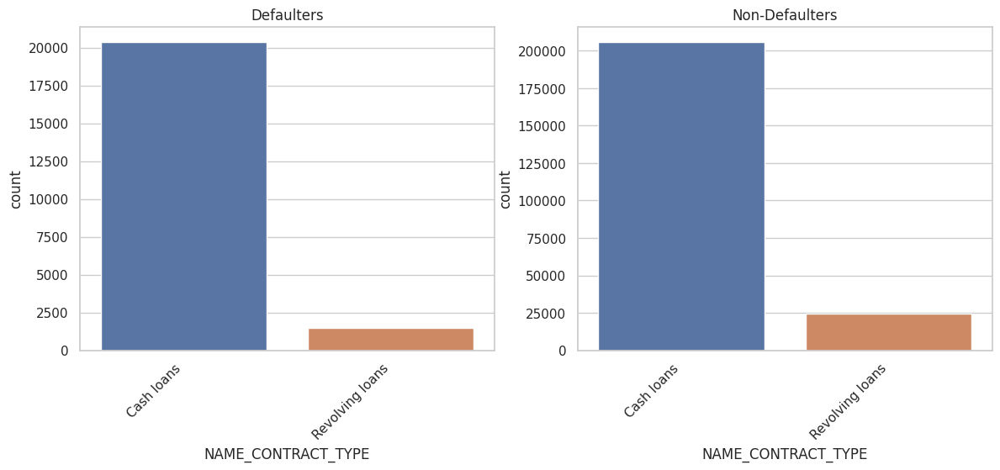

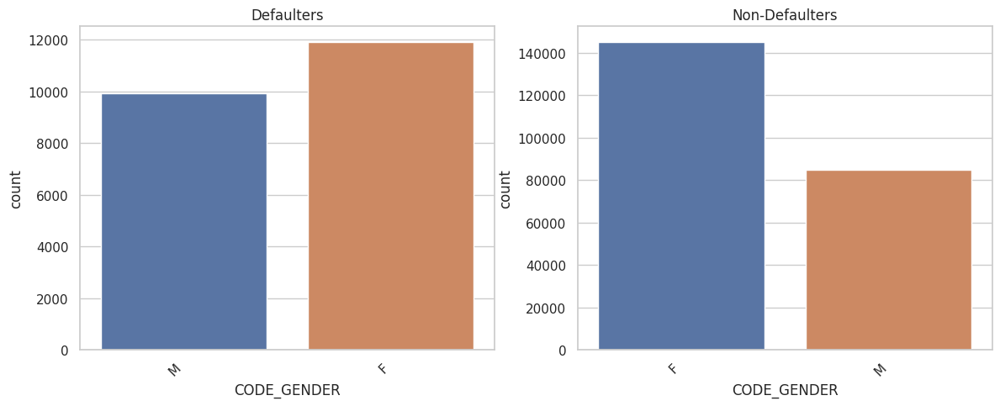

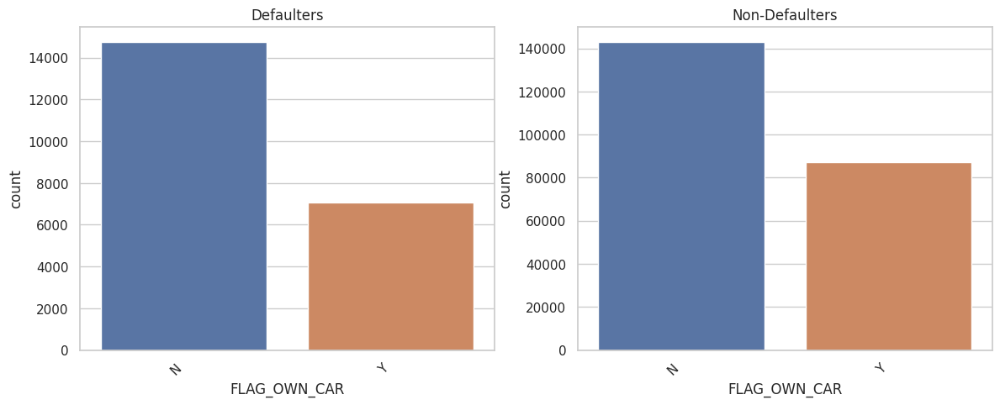

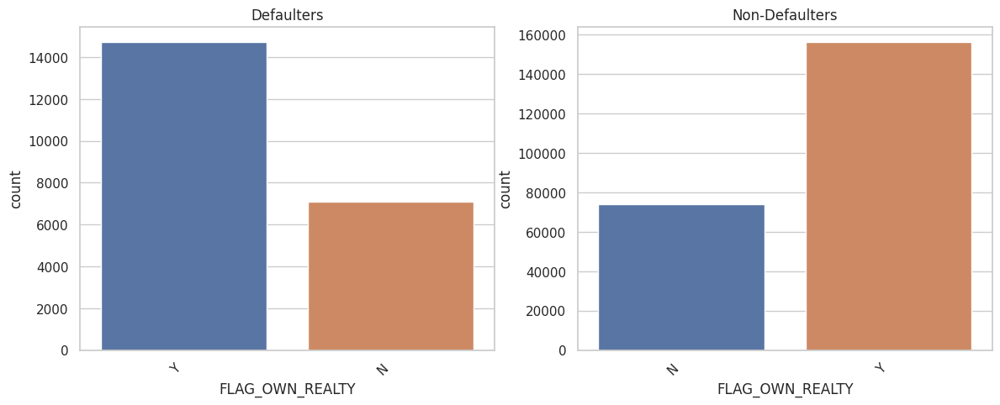

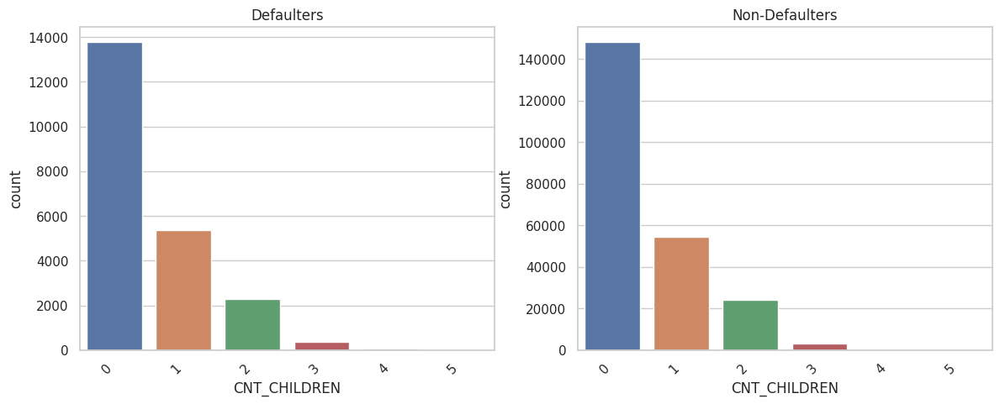

...

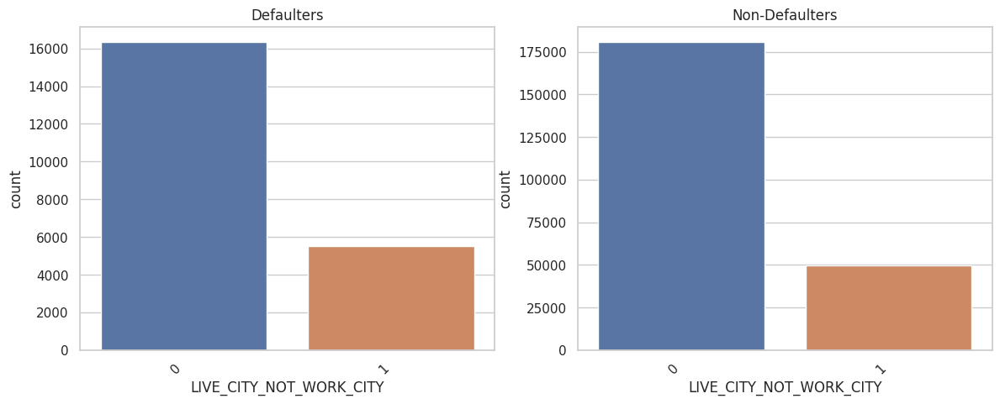

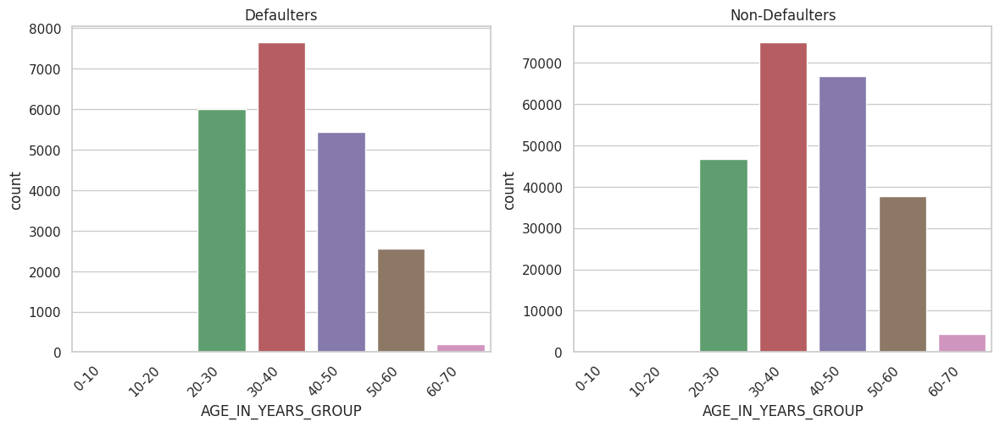

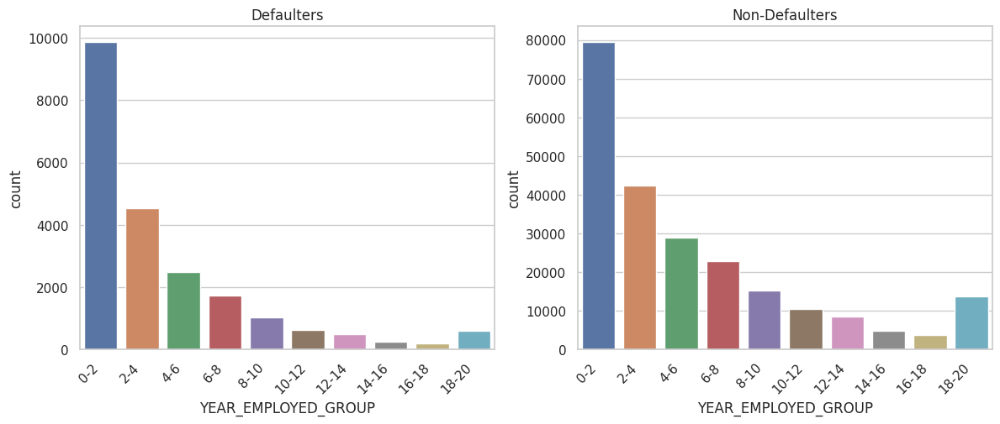

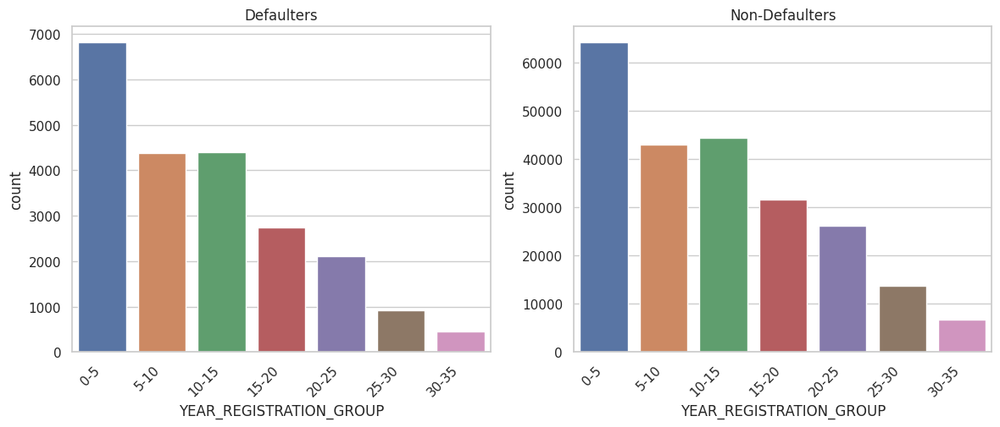

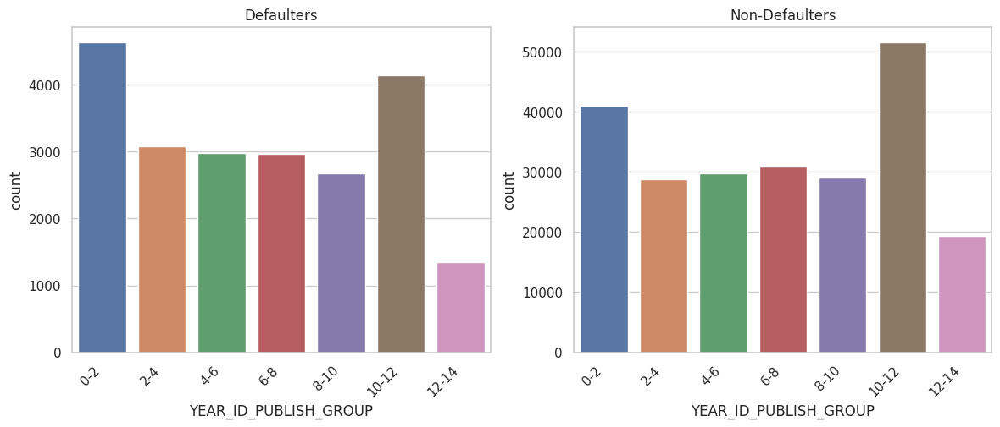

In [136]:

objvarList = ['NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'NAME_TYPE_SUITE',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'FLAG_MOBIL',
       'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE',
       'FLAG_EMAIL', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY',
        'AGE_IN_YEARS_GROUP', 'YEAR_EMPLOYED_GROUP', 'YEAR_REGISTRATION_GROUP',
       'YEAR_ID_PUBLISH_GROUP']
for i in objvarList:
  plt.figure(figsize=(14,5))
  plt.subplot(1,2,1)
  ax = sns.countplot(x = i,data=app_df_1)
  plt.title('Defaulters')
  ax.set(xlabel=i)
  temp = ax.set_xticklabels(ax.get_xticklabels(), rotation = 45, horizontalalignment='right')


  plt.subplot(1,2,2)
  ax = sns.countplot(x = i,data=app_df_0)
  plt.title('Non-Defaulters')
  ax.set(xlabel=i)
  temp = ax.set_xticklabels(ax.get_xticklabels(), rotation = 45, horizontalalignment='right')

Creating histograms for numerical columns while considering both "TARGET 1" and "TARGET 0" datasets, and noting that they exhibit different density distributions.

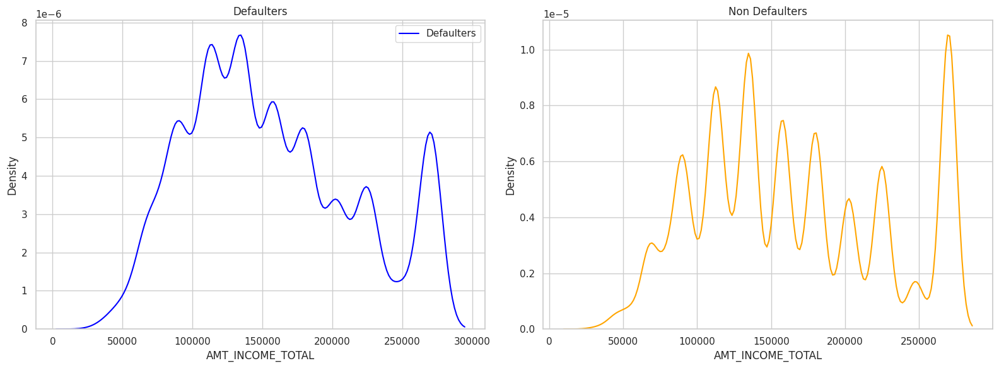

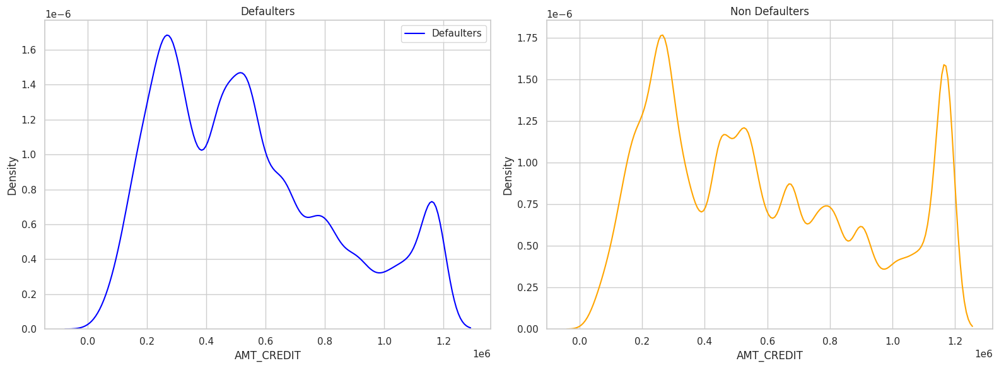

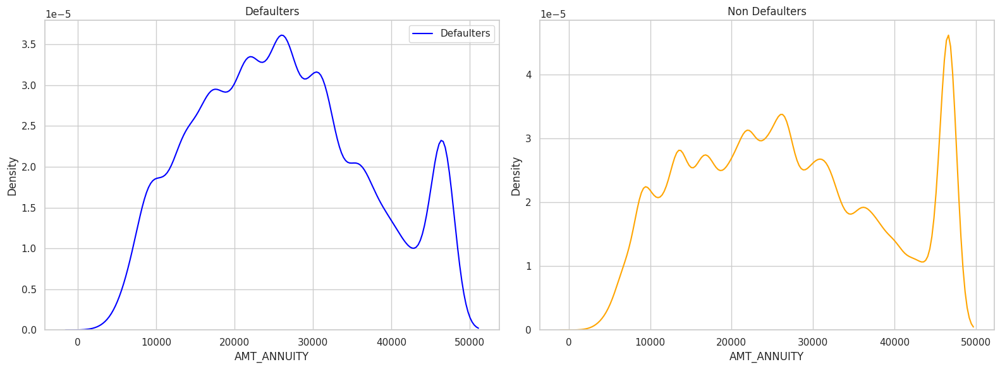

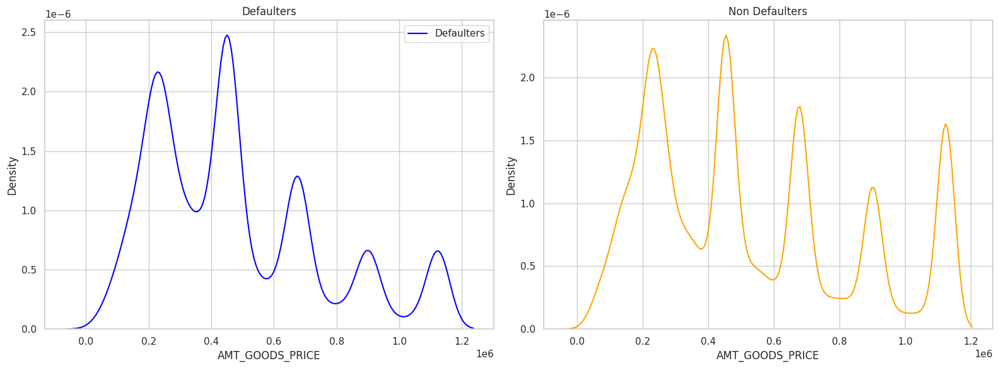

In [137]:
cols = ['AMT_INCOME_TOTAL','AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE']
for col in cols:
  sns.set(style="whitegrid")
  fig, axes = plt.subplots(1, 2, figsize=(16, 6))
  # Create the density plots for Defaulters
  sns.distplot(app_df_1[col], hist=False, ax=axes[0], color='blue', label='Defaulters')

  # Create the density plots for Non Defaulters
  sns.distplot(app_df_0[col], hist=False, ax=axes[1], color='orange', label='Non Defaulters')

  # Set titles for subplots
  axes[0].set_title('Defaulters')
  axes[1].set_title('Non Defaulters')

  # Add a color legend to the first subplot
  axes[0].legend()

  # Adjust layout
  plt.tight_layout()

  # Display the plots
  plt.show()

In [138]:
result = app_df_0.groupby('AMT_INCOME_TOTAL_GROUP')['AMT_CREDIT'].sum()
result

AMT_INCOME_TOTAL_GROUP
0-60000             1.077391e+09
60000-120000        2.782151e+10
120000-180000       4.959812e+10
180000-240000       2.552039e+10
More than 240000    3.048609e+10
Name: AMT_CREDIT, dtype: float64

Creating box plots and count plot to compare the relationship between "INCOME_GROUP" and "AMT_CREDIT" for both "TARGET 0" and "TARGET 1" datasets.

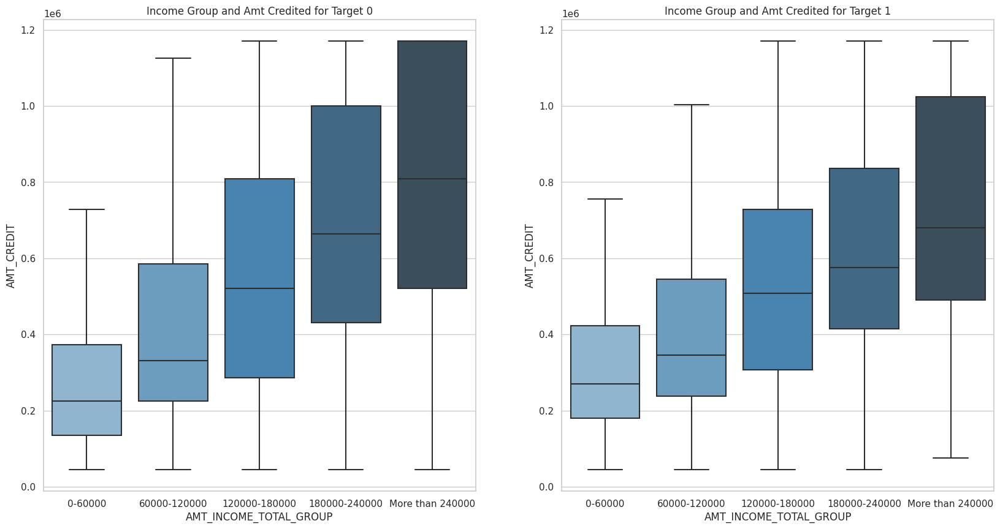

In [139]:

## Checking INCOME_GROUP vs AMT_CREDIT for both data frames

plt.figure(figsize = (20,10))
plt.subplot(1,2,1)
plt.title("Income Group and Amt Credited for Target 0")
sns.boxplot(x = 'AMT_INCOME_TOTAL_GROUP', y = 'AMT_CREDIT', data =app_df_0, showfliers=False, palette="Blues_d")

plt.subplot(1,2,2)
plt.title("Income Group and Amt Credited for Target 1")
sns.boxplot(x = 'AMT_INCOME_TOTAL_GROUP', y = 'AMT_CREDIT', data = app_df_1, showfliers=False, palette="Blues_d")
plt.show()


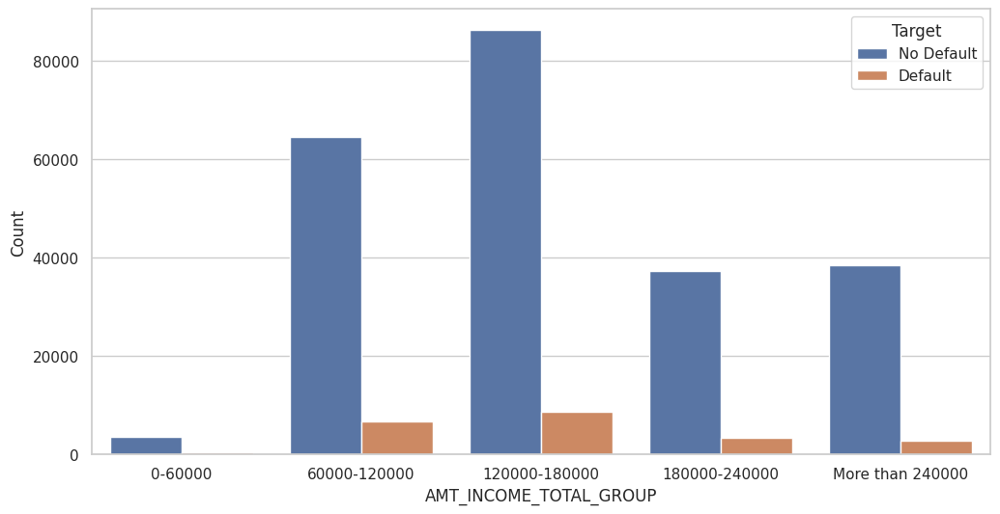

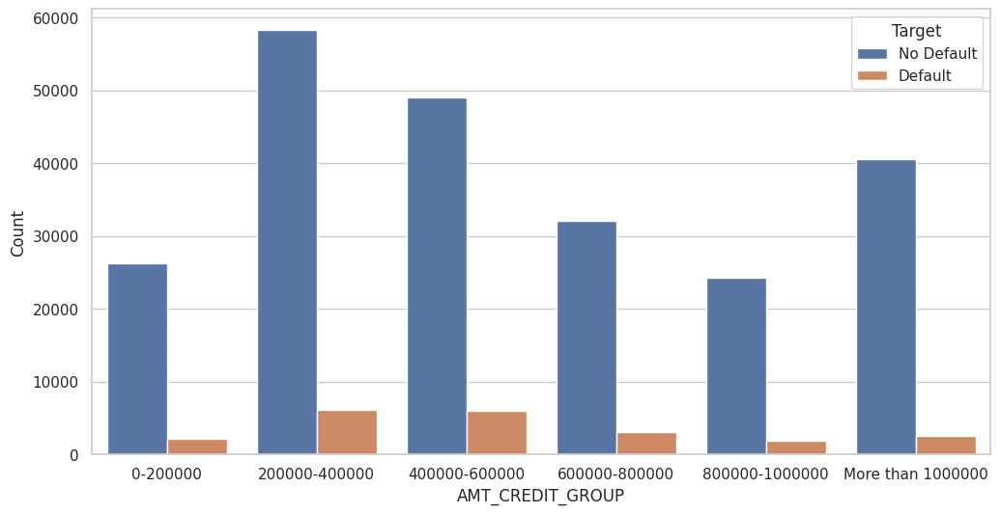

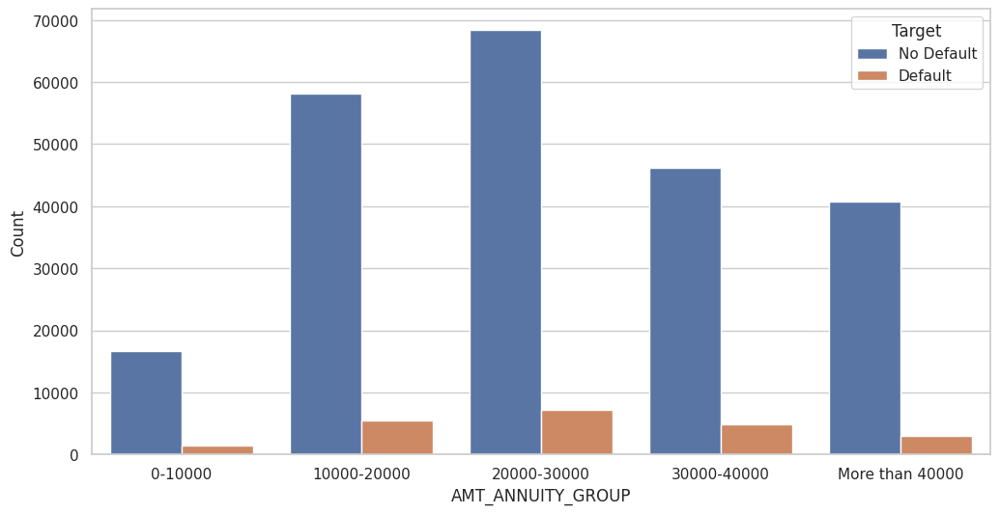

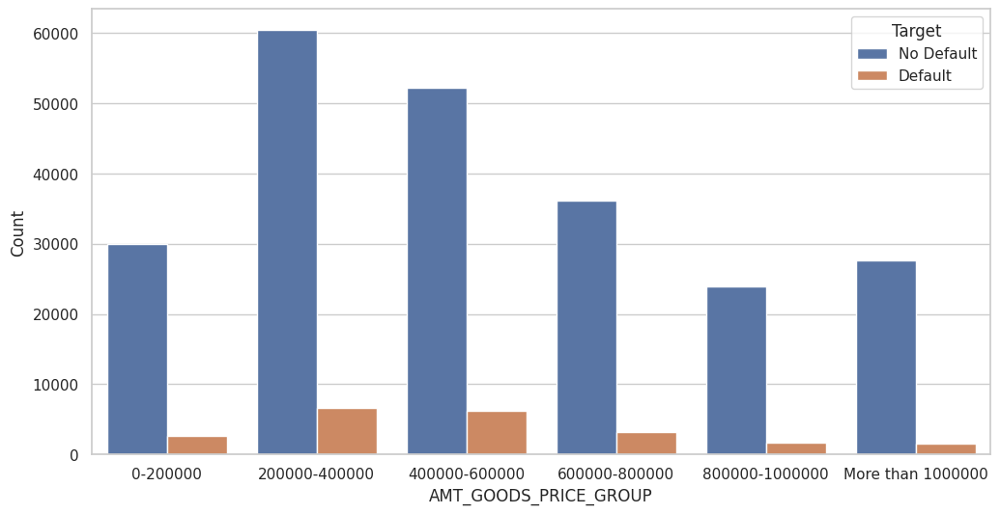

In [140]:
#Checking the same columns to see the affect of Very High Income group AMT_CREDIT
cols= ['AMT_INCOME_TOTAL_GROUP','AMT_CREDIT_GROUP', 'AMT_ANNUITY_GROUP', 'AMT_GOODS_PRICE_GROUP',]
for col in cols:
  plt.figure(figsize=(12, 6))
  # plt.title("AMT_INCOME_TOTAL _Group and Payment Difficulty")
  sns.countplot(x=col, hue='TARGET', data=app_df)
  plt.xlabel(col)
  plt.ylabel("Count")
  plt.legend(title='Target', labels=['No Default', 'Default'])
  plt.show()

Observations indicate that, across all numerical fields, "TARGET 0" exhibits the highest frequency or count, suggesting that a larger proportion of applicants fall into this category as compared to "TARGET 1."

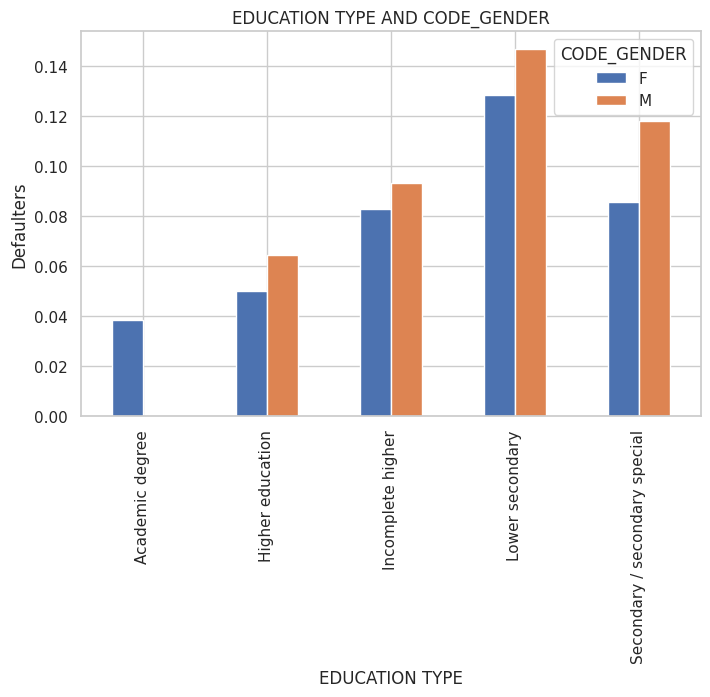

In [141]:

# Create a bar plot
plot_1 =app_df.pivot_table(values='TARGET',index='NAME_EDUCATION_TYPE',columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(8,5))

# Rotate x-axis labels for better readability
plot_1.set_xticklabels(plot_1.get_xticklabels(), rotation=90)

# Add title and labels
plt.title("EDUCATION TYPE AND CODE_GENDER")
plt.xlabel("EDUCATION TYPE")
plt.ylabel("Defaulters")

# Display the plot
plt.show()

Default rates are highest among males with lower secondary education, followed by those with secondary/secondary special education.

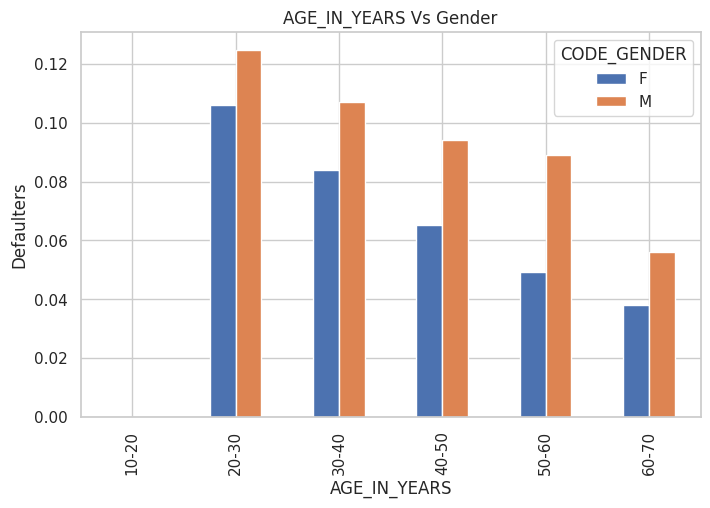

In [142]:
app_df.pivot_table(values='TARGET',index='AGE_IN_YEARS_GROUP',columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(8,5))
plt.xlabel('AGE_IN_YEARS')
plt.ylabel('Defaulters')
plt.title('AGE_IN_YEARS Vs Gender')
plt.show()

 Default rates are notably higher among males compared to females. Among males, the highest default rates are observed within the age range of 20 to 30 years.

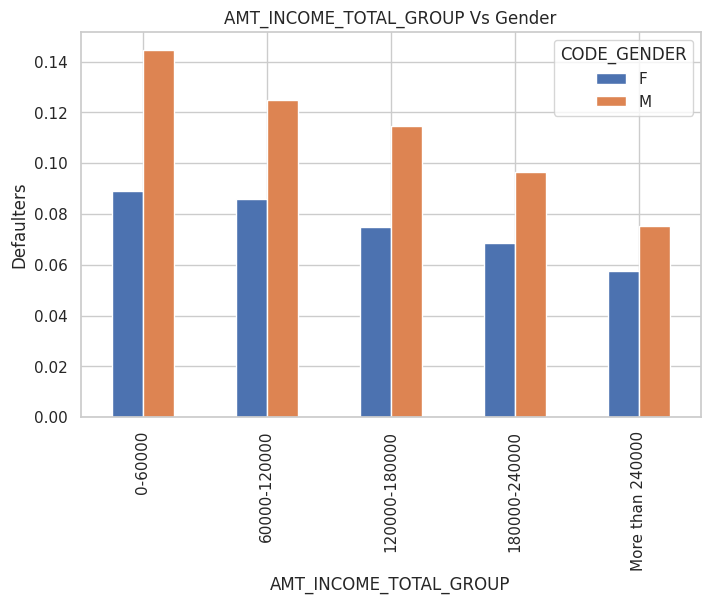

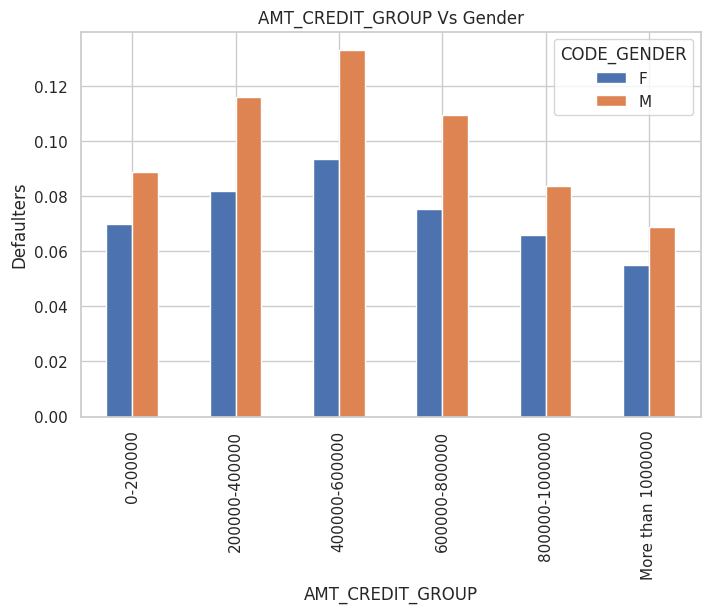

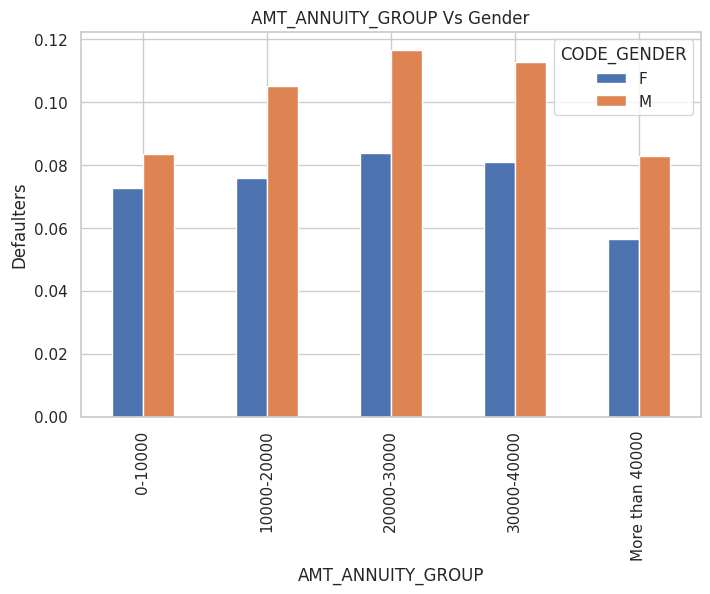

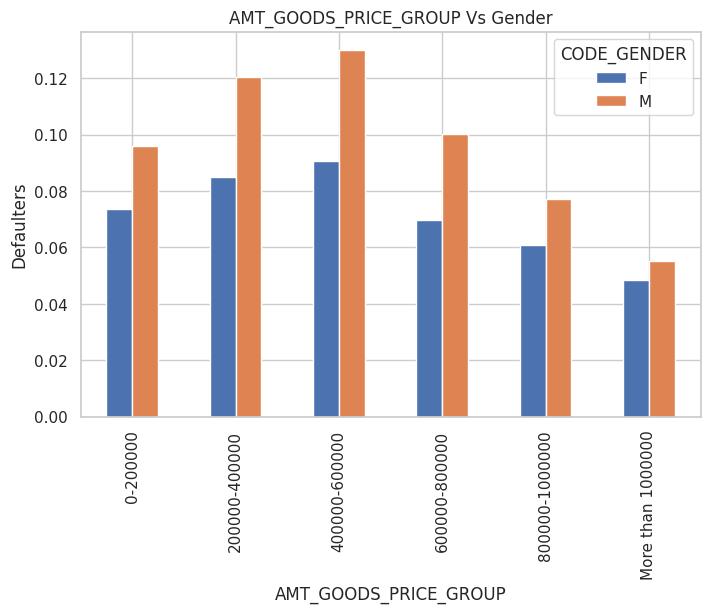

In [143]:
cols= ['AMT_INCOME_TOTAL_GROUP','AMT_CREDIT_GROUP', 'AMT_ANNUITY_GROUP', 'AMT_GOODS_PRICE_GROUP',]
for col in cols:
  app_df.pivot_table(values='TARGET',index=col,columns='CODE_GENDER',aggfunc='mean').plot.bar(figsize=(8,5))
  plt.xlabel(col)
  plt.ylabel('Defaulters')
  plt.title(col+' Vs Gender')
  plt.show()
  print("\n" + "="*150 + "\n")




1. Looking at the 'AMT_INCOME_TOTAL_GROUP' vs. Gender graph, it's evident that males have a higher default rate compared to females. Particularly, among males with a total income ranging from 0 to 60,000, the rate of default is notably pronounced.


2. Analyzing the 'AMT_CREDIT_GROUP' vs. Gender graph, a similar trend emerges with higher default rates among males compared to females. Specifically, among males obtaining credit amounts within the range of 400,000 to 600,000, the prevalence of defaults is notably elevated.

3. In the 'AMT_ANNUITY_GROUP' vs. Gender graph, once again, males exhibit a higher propensity for default compared to females. Among males with loan annuity amounts ranging from 10,000 to 40,000, the likelihood of defaults is notably pronounced.
4. Shifting focus to the 'AMT_GOODS_PRICE_GROUP' vs. Gender graph, the trend remains consistent—males show a higher default rate than females. Particularly, among males dealing with prices of the goods for which the loan is given in the range of 200,000 to 600,000, the prevalence of defaults is notably prominent.

**Conclusion:**
Across all financial aspects examined—total income, credit amount, loan annuity, and goods price—males consistently exhibit higher default rates compared to females. This trend is evident across varying ranges within each aspect.

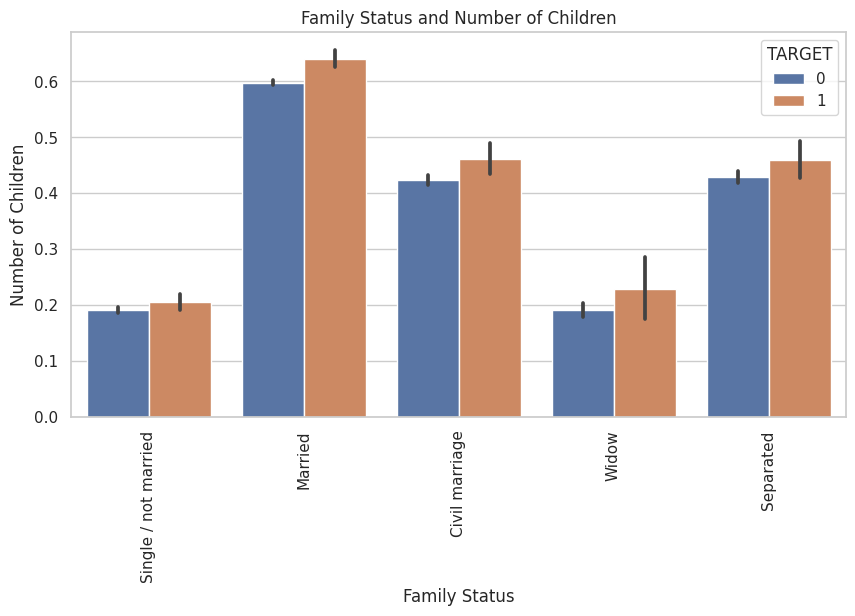

In [144]:

# Create a bar plot
f, ax = plt.subplots(figsize=(10, 5))
plot_1 = sns.barplot(x="NAME_FAMILY_STATUS", y="CNT_CHILDREN", data=app_df, hue="TARGET")

# Rotate x-axis labels for better readability
plot_1.set_xticklabels(plot_1.get_xticklabels(), rotation=90)

# Add title and labels
plt.title("Family Status and Number of Children")
plt.xlabel("Family Status")
plt.ylabel("Number of Children")

# Display the plot
plt.show()

 Married clients with five or more children have an elevated risk of defaulting, possibly stemming from their family's economic circumstances, which can be strained by the presence of multiple dependents.

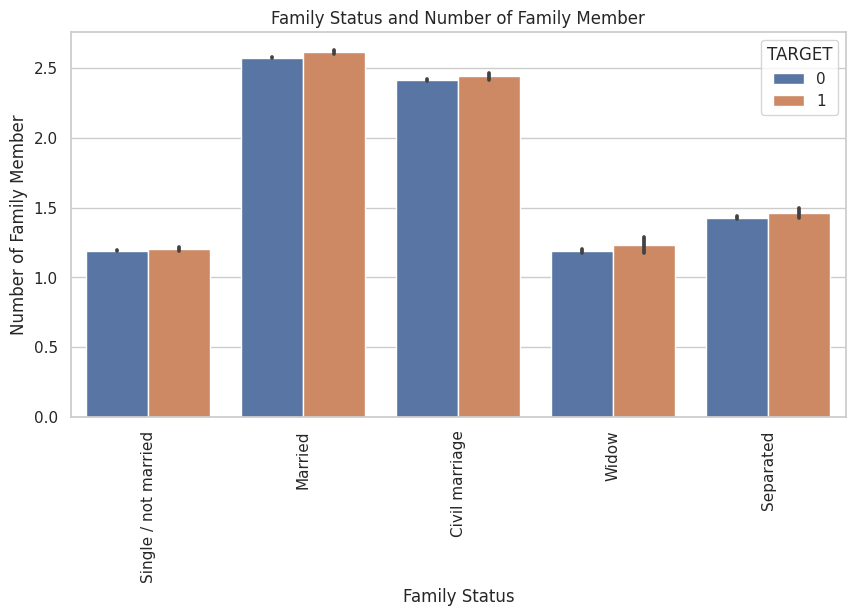

In [145]:
# Create a bar plot
f, ax = plt.subplots(figsize=(10, 5))
plot_1 = sns.barplot(x="NAME_FAMILY_STATUS", y="CNT_FAM_MEMBERS", data=app_df, hue="TARGET")

# Rotate x-axis labels for better readability
plot_1.set_xticklabels(plot_1.get_xticklabels(), rotation=90)

# Add title and labels
plt.title("Family Status and Number of Family Member")
plt.xlabel("Family Status")
plt.ylabel("Number of Family Member")

# Display the plot
plt.show()

 Married clients with larger family sizes exhibit an increased risk of both defaulting and non-defaulting. This trend might arise from the impact of additional family members on their economic situation. As a result, a thorough examination of such clients is warranted.

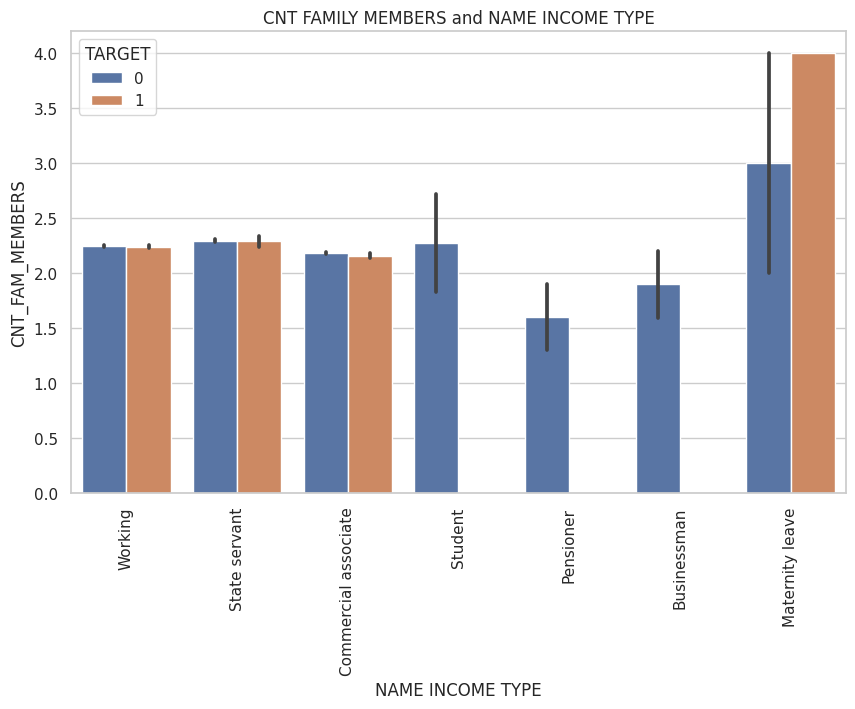

In [146]:
# Create a bar plot['AMT_INCOME_TOTAL_GROUP','AMT_CREDIT_GROUP', 'AMT_ANNUITY_GROUP', 'AMT_GOODS_PRICE_GROUP',]
f, ax = plt.subplots(figsize=(10, 6))
plot_1 = sns.barplot(x="NAME_INCOME_TYPE", y="CNT_FAM_MEMBERS", data=app_df, hue="TARGET")

# Rotate x-axis labels for better readability
plot_1.set_xticklabels(plot_1.get_xticklabels(), rotation=90)

# Add title and labels
plt.title("CNT FAMILY MEMBERS and NAME INCOME TYPE")
plt.ylabel("CNT_FAM_MEMBERS")
plt.xlabel("NAME INCOME TYPE")

# Display the plot
plt.show()

 Individuals who receive income via Maternity Leave tend to have a higher likelihood of defaulting when they have a greater number of family members.

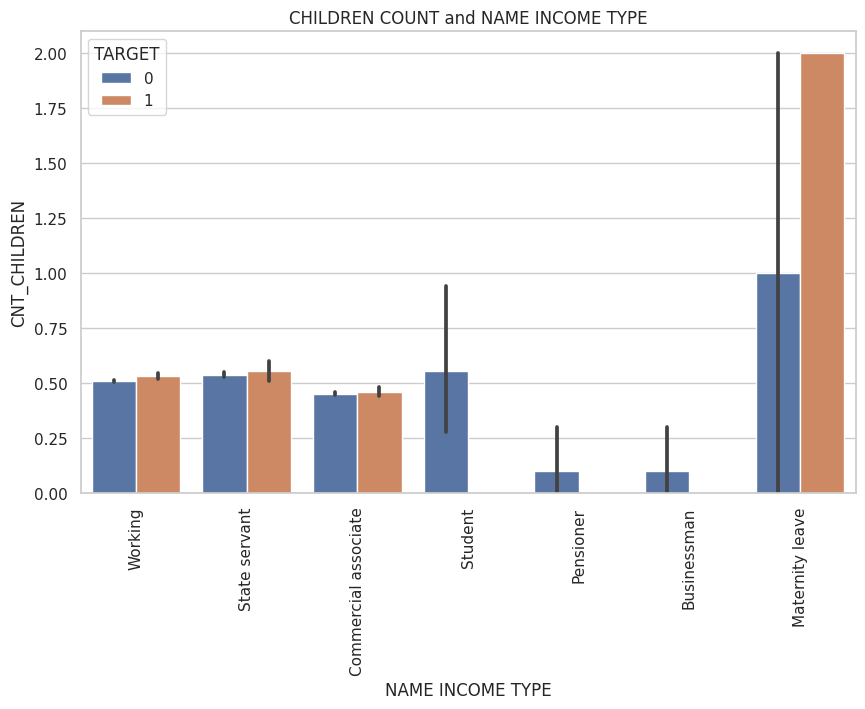

In [147]:
# Create a bar plot['AMT_INCOME_TOTAL_GROUP','AMT_CREDIT_GROUP', 'AMT_ANNUITY_GROUP', 'AMT_GOODS_PRICE_GROUP',]
f, ax = plt.subplots(figsize=(10, 6))
plot_1 = sns.barplot(x="NAME_INCOME_TYPE", y="CNT_CHILDREN", data=app_df, hue="TARGET")

# Rotate x-axis labels for better readability
plot_1.set_xticklabels(plot_1.get_xticklabels(), rotation=90)

# Add title and labels
plt.title("CHILDREN COUNT and NAME INCOME TYPE")
plt.ylabel("CNT_CHILDREN")
plt.xlabel("NAME INCOME TYPE")

# Display the plot
plt.show()

Individuals receiving income through Maternity Leave tend to have a higher tendency to default when they have a larger number of children.

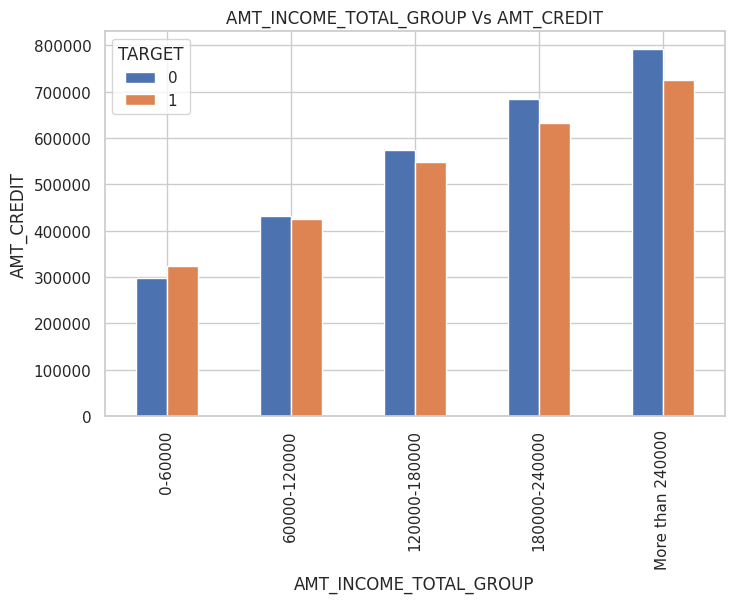

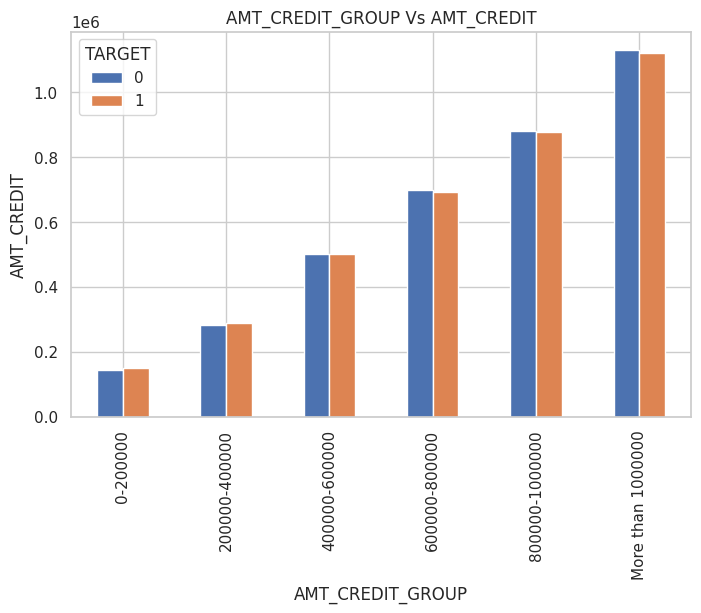

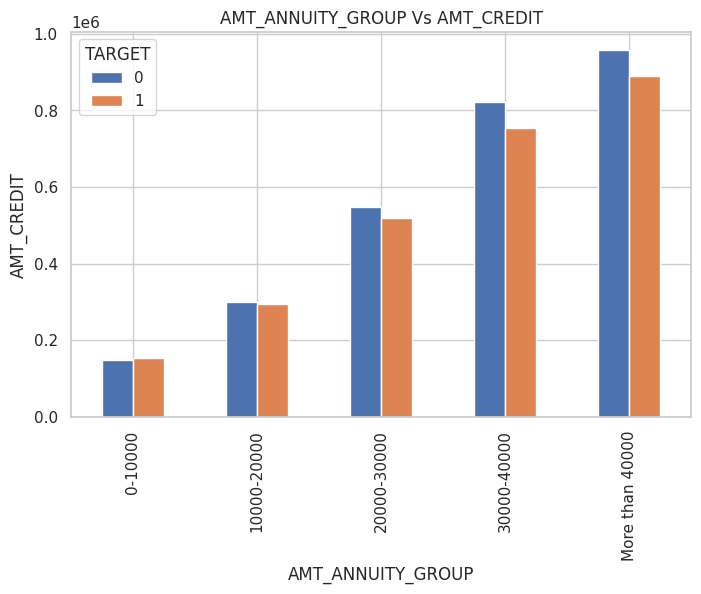

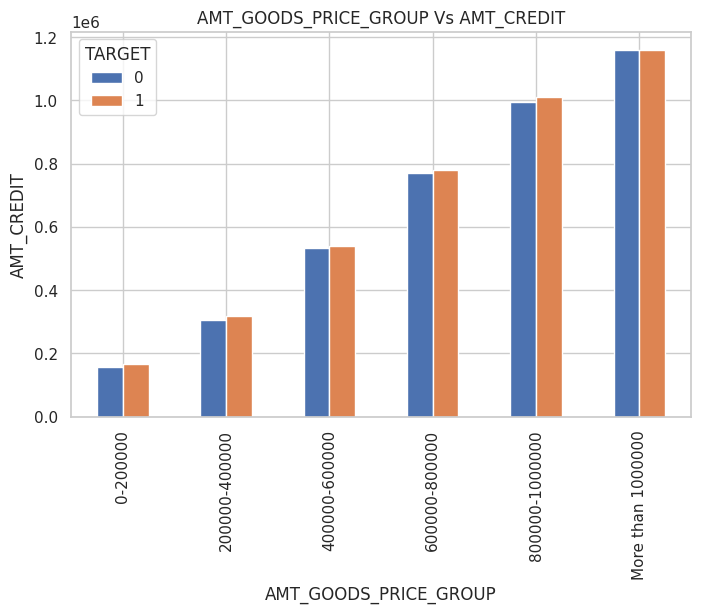

In [148]:
cols= ['AMT_INCOME_TOTAL_GROUP','AMT_CREDIT_GROUP', 'AMT_ANNUITY_GROUP', 'AMT_GOODS_PRICE_GROUP',]
for col in cols:
  app_df.pivot_table(values='AMT_CREDIT',index=col,columns='TARGET',aggfunc='mean').plot.bar(figsize=(8,5))
  plt.xlabel(col)
  plt.ylabel('AMT_CREDIT')
  plt.title(col+' Vs AMT_CREDIT')
  plt.show()
print("\n" + "="*150 + "\n")

 This graph illustrates a clear relationship: individuals with higher incomes tend to secure larger credit amounts for loans. However, a concerning trend accompanies this correlation—these borrowers, despite their larger incomes and credit amounts, display higher default rates. This insight underscores the importance of caution when considering higher credit amounts for loans.

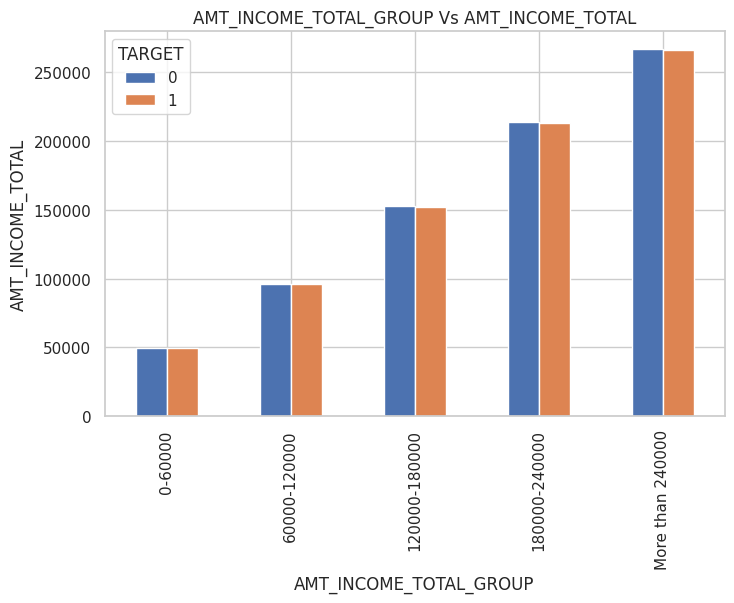

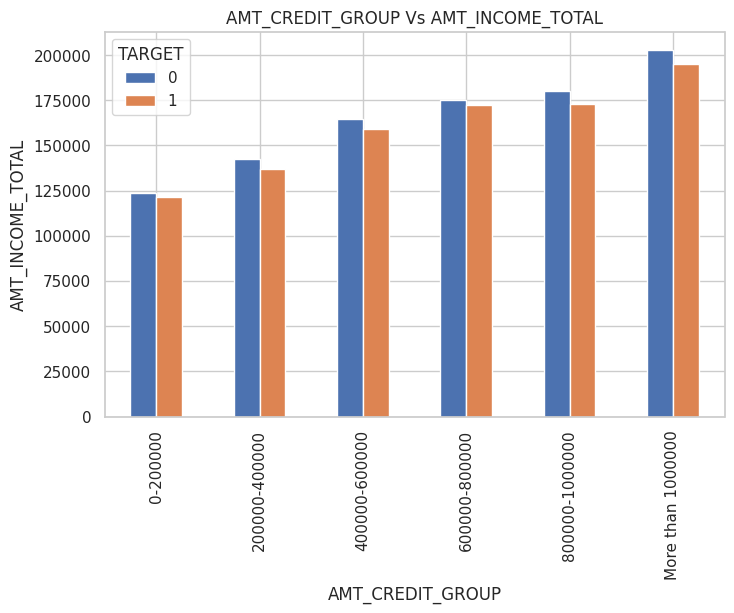

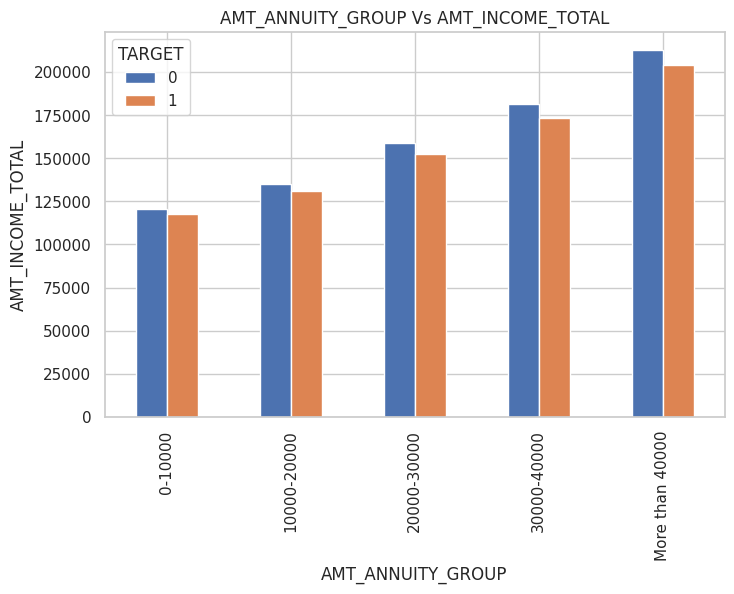

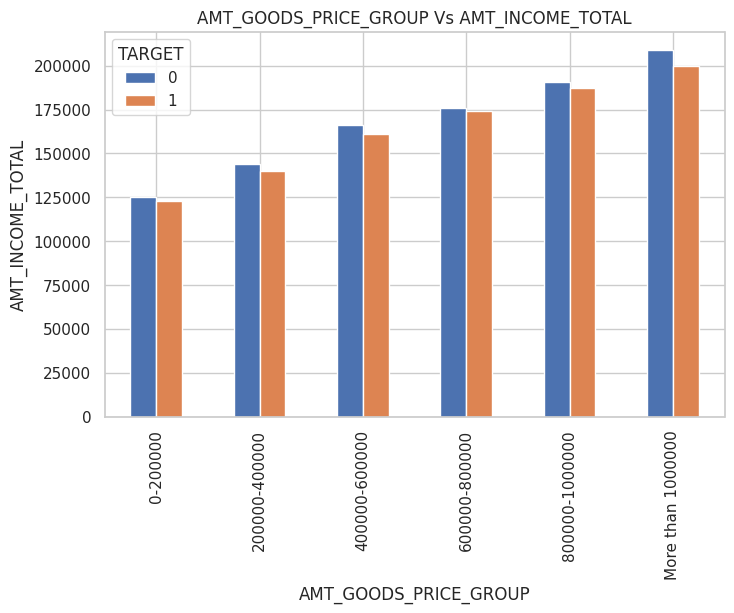

In [149]:
cols= ['AMT_INCOME_TOTAL_GROUP','AMT_CREDIT_GROUP', 'AMT_ANNUITY_GROUP', 'AMT_GOODS_PRICE_GROUP',]
for col in cols:
  app_df.pivot_table(values='AMT_INCOME_TOTAL',index=col,columns='TARGET',aggfunc='mean').plot.bar(figsize=(8,5))
  plt.xlabel(col)
  plt.ylabel('AMT_INCOME_TOTAL')
  plt.title(col+' Vs AMT_INCOME_TOTAL')
  plt.show()
print("\n" + "="*150 + "\n")

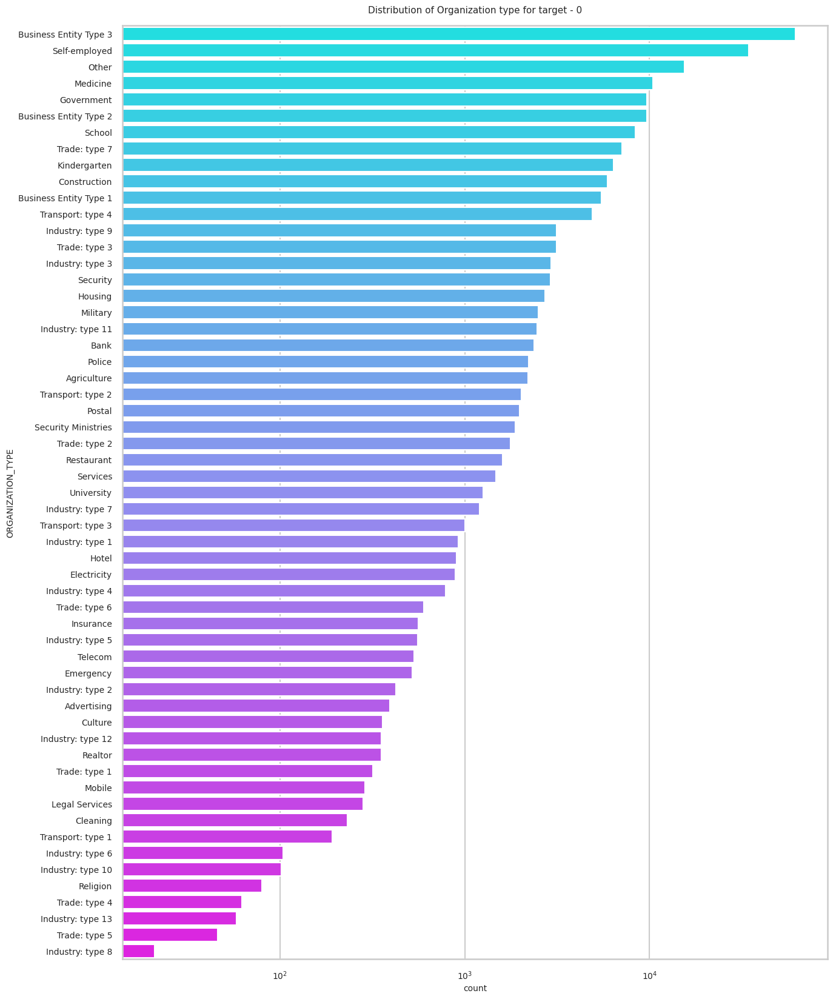

In [150]:
# Plotting for Organization type in logarithmic scale for target 0

sns.set_style('whitegrid')
sns.set_context('talk')
plt.figure(figsize=(15,20))
plt.rcParams["axes.labelsize"] = 10
plt.rcParams['axes.titlesize'] = 11
plt.rcParams['axes.titlepad'] = 15

plt.title("Distribution of Organization type for target - 0")

# plt.xticks(rotation=90)
plt.xscale('log')

plot_1 = sns.countplot(data=app_df_0,y='ORGANIZATION_TYPE',order=app_df_0['ORGANIZATION_TYPE'].value_counts().index,palette='cool')
plot_1.set_yticklabels(plot_1.get_yticklabels(), fontsize=10)
plot_1.set_xticklabels(plot_1.get_xticklabels(), fontsize=10)
plt.show()

The organization type "Business Entity Type 3" demonstrates a higher proportion of non-defaulters.






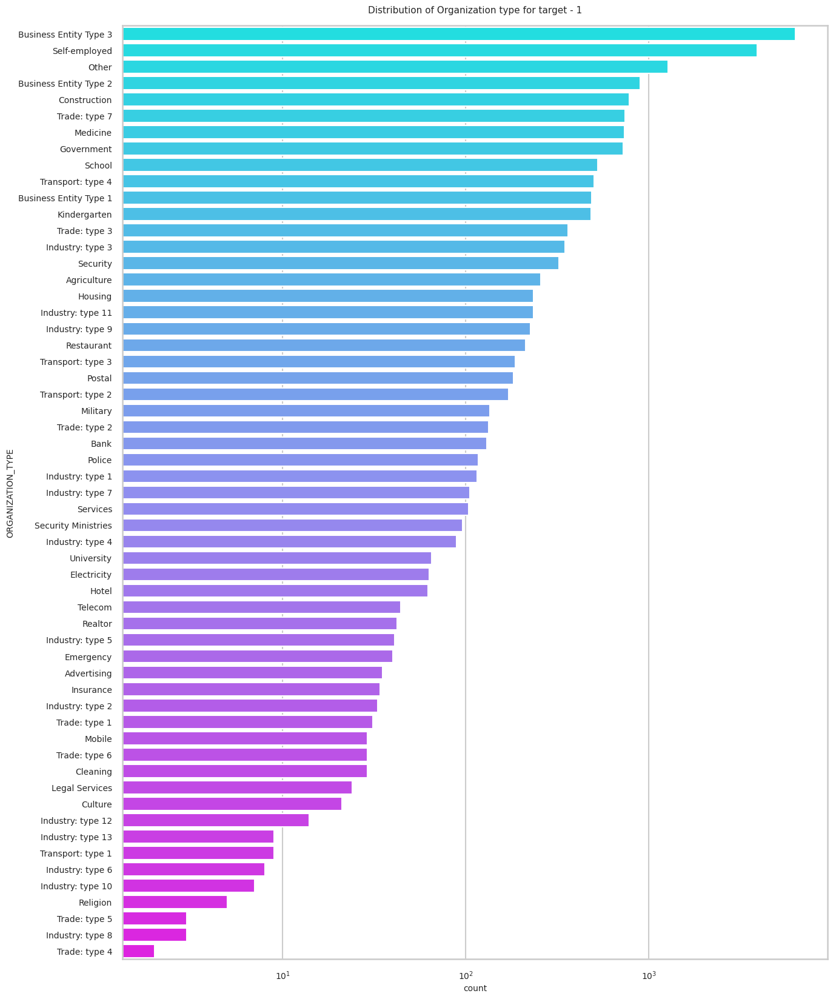

In [151]:
# Plotting for Organization type in logarithmic scale for Target 1

sns.set_style('whitegrid')
sns.set_context('talk')
plt.figure(figsize=(15,20))
plt.rcParams["axes.labelsize"] = 10
plt.rcParams['axes.titlesize'] = 11
plt.rcParams['axes.titlepad'] = 15
plt.title("Distribution of Organization type for target - 1")
plt.xscale('log')

plot_1 = sns.countplot(data=app_df_1,y='ORGANIZATION_TYPE',order=app_df_1['ORGANIZATION_TYPE'].value_counts().index,palette='cool')
plot_1.set_yticklabels(plot_1.get_yticklabels(), fontsize=10)
plot_1.set_xticklabels(plot_1.get_xticklabels(), fontsize=10)
plt.show()

Key observations from the graph are as follows:


1.   A significant number of clients applying for credits belong to organization types such as 'Business Entity Type 3', 'Self Employed', 'Other', 'Medicine', and 'Government'.
2.   Fewer clients come from organization types like Industry Type 8, Type 6, Type 10, Religion, and Trade Type 5, Type 4.
3. The distribution of organization types resembles that of Type 0.

These insights shed light on the distribution of clients across various organization types, highlighting the more prevalent as well as the less common categories.


In [152]:
correlation_app_df_0= app_df_0.drop(["HOUR_APPR_PROCESS_START","FLAG_MOBIL"],axis=1)
correlation_app_df_1= app_df_1.drop(["HOUR_APPR_PROCESS_START","FLAG_MOBIL"],axis=1)
app_df_0_corr =correlation_app_df_0.iloc[0:,2:]
app_df_1_corr =correlation_app_df_1.iloc[0:,2:]

target0=app_df_0_corr.corr(method='spearman')
target1=app_df_1_corr.corr(method='spearman')

**Correlation of defaulters**

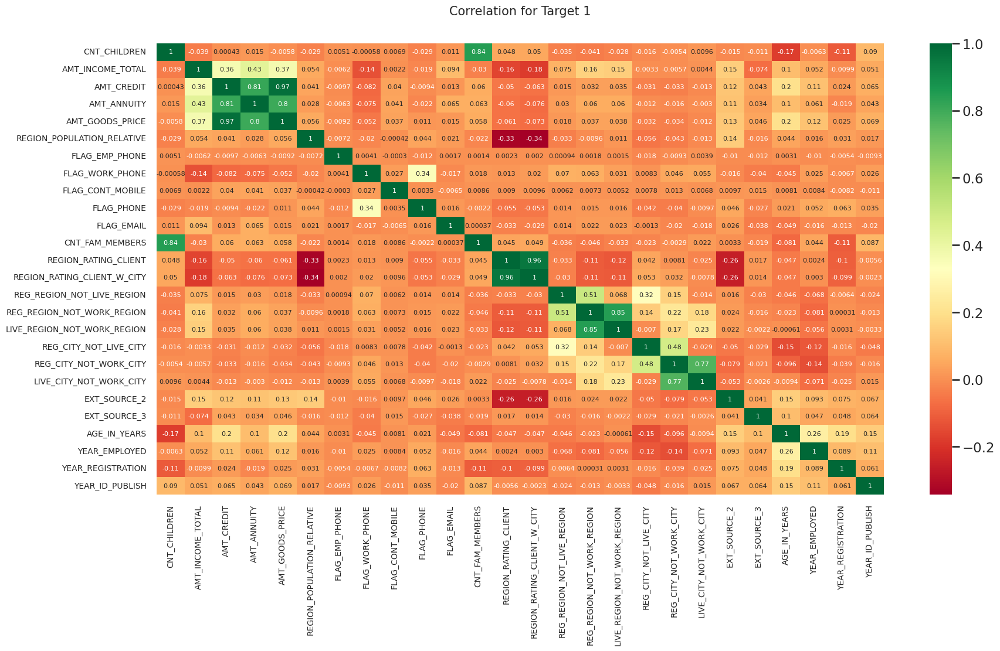

In [153]:
# Now, plotting the correlation with heat map as it is the best choice to visulaize

def target_correl(data,title):
  plt.figure(figsize=(20, 10))
  plt.rcParams['axes.titlesize'] = 15
  plt.rcParams['axes.titlepad'] = 35
  plot_1 = sns.heatmap(data, cmap="RdYlGn",annot=True,annot_kws={'size': 8})
  plot_1.set_yticklabels(plot_1.get_yticklabels(), fontsize=10)
  plot_1.set_xticklabels(plot_1.get_xticklabels(), fontsize=10)
  plt.title(title)
  plt.yticks(rotation=0)
  plt.show()


# For Target 1
target_correl(data=target1,title='Correlation for Target 1')

**Here are some highly Correlated Variables**

*   AMT_CREDIT and AMT_GOODS_PRICE =0.97
*   REGION_RATING_CLIENT_W_CITY and REGION_RATING_CLIENT = 0.96
*   CNT_FAM_MEMBERS and CNT_CHILDREN = 0.84
*   AMT_ANNUITY and AMT_CREDIT = 0.81

* Higher AMT_CREDIT is associated with clients having fewer children, and conversely, lower AMT_CREDIT is associated with clients having more children.

* More income is correlated with clients having fewer children, while less income is correlated with clients having more children.

* Higher income is linked to clients having fewer family members, and lower income is linked to clients having more family members.

* Clients tend to have fewer children in densely populated areas as CNT_CHILDREN is inversely proportional to REGION_POPULATION_RELATIVE.

* In densely populated areas, AMT_CREDIT tends to be higher, indicating a direct proportionality between AMT_CREDIT and REGION_POPULATION_RELATIVE.

* AMT_INCOME_TOTAL is typically higher in densely populated areas, implying an inverse relationship between income and REGION_POPULATION_RELATIVE.


In [154]:
# Listing the columns for finding corelation
corr_cols = ['AMT_INCOME_TOTAL','AMT_CREDIT','AMT_ANNUITY','AMT_GOODS_PRICE','AGE_IN_YEARS','EXT_SOURCE_2','REGION_RATING_CLIENT']

In [155]:
# Creating dataframe for numerical columns
corr_target_1 = app_df_1[corr_cols]
corr_target_1.head()

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,AGE_IN_YEARS,EXT_SOURCE_2,REGION_RATING_CLIENT
0,202500.0,406597.5,24700.5,351000.0,25,0.262949,2
26,112500.0,979992.0,27076.5,702000.0,51,0.548477,3
40,202500.0,1170000.0,35028.0,855000.0,47,0.306841,2
42,135000.0,288873.0,16258.5,238500.0,36,0.674203,3
94,270000.0,953460.0,46701.0,900000.0,27,0.432340,2


In [156]:
corr_target_1.corr()

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,AGE_IN_YEARS,EXT_SOURCE_2,REGION_RATING_CLIENT
AMT_INCOME_TOTAL,1.000000,0.358422,0.430438,0.362140,0.102363,0.149120,-0.175396
AMT_CREDIT,0.358422,1.000000,0.776992,0.978323,0.195883,0.123827,-0.059613
AMT_ANNUITY,0.430438,0.776992,1.000000,0.771501,0.095431,0.115208,-0.070225
AMT_GOODS_PRICE,0.362140,0.978323,0.771501,1.000000,0.192009,0.135600,-0.069994
AGE_IN_YEARS,0.102363,0.195883,0.095431,0.192009,1.000000,0.142296,-0.049192
EXT_SOURCE_2,0.149120,0.123827,0.115208,0.135600,0.142296,1.000000,-0.252941
REGION_RATING_CLIENT,-0.175396,-0.059613,-0.070225,-0.069994,-0.049192,-0.252941,1.000000


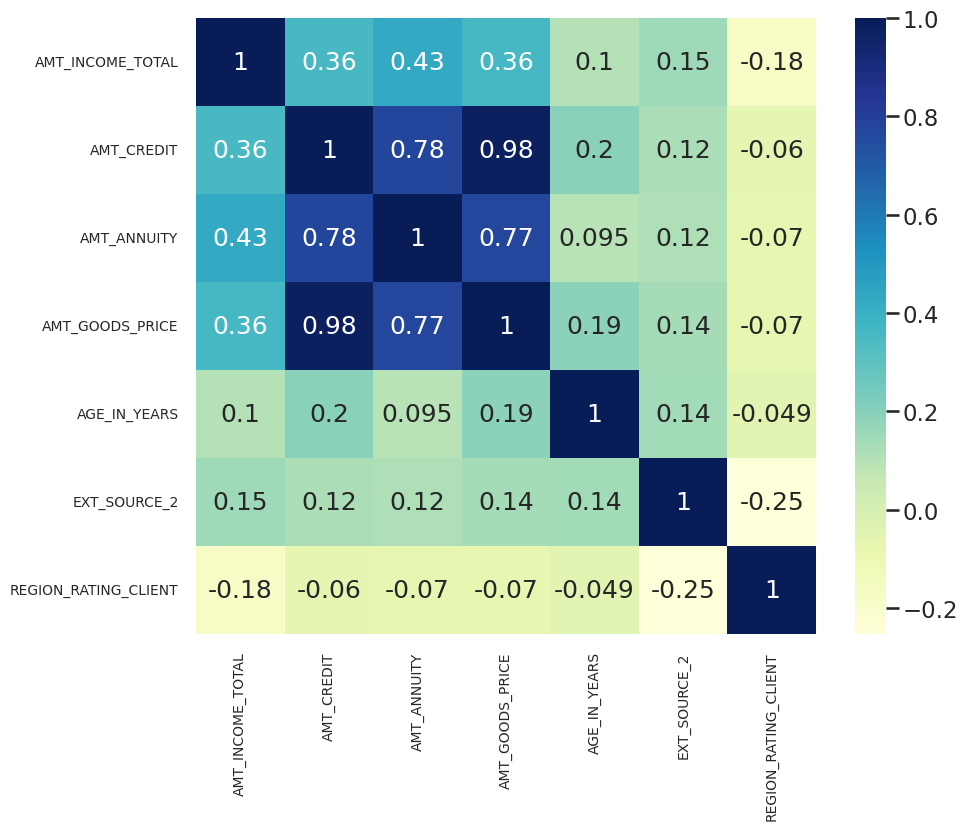

In [157]:
plt.figure(figsize=(10,8))
plot_1 = sns.heatmap(corr_target_1.corr(),cmap="YlGnBu",annot=True)
plot_1.set_yticklabels(plot_1.get_yticklabels(), fontsize=10)
plot_1.set_xticklabels(plot_1.get_xticklabels(), fontsize=10)
plt.show()


Strong correlations among columns for defaulters are evident:

1.   A notable correlation of 0.78 exists between 'AMT_CREDIT' and 'AMT_ANNUITY'.
2.   'AMT_CREDIT' and 'AMT_GOODS_PRICE' showcase a remarkably high correlation of 0.98.
3.   Similarly, 'AMT_ANNUITY' and 'AMT_GOODS_PRICE' demonstrate a substantial correlation of 0.77.

These correlations underscore the interrelationships between these columns, offering insights into potential patterns among defaulters.

### **Correlation of non defaulters**

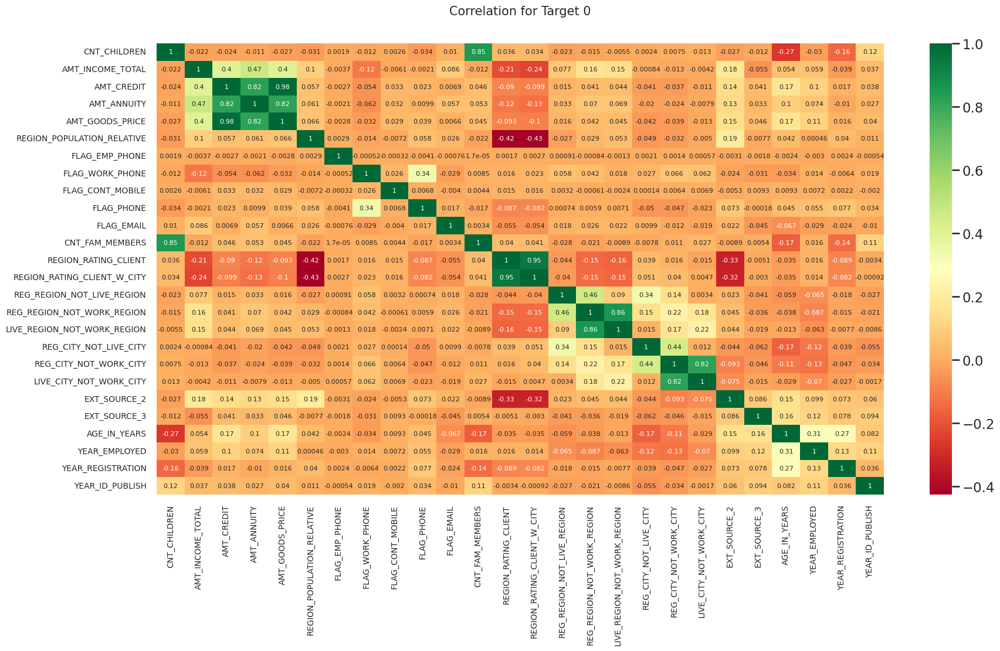

In [158]:
# Now, plotting the correlation with heat map as it is the best choice to visulaize

def target_correl(data,title):
  plt.figure(figsize=(20, 10))
  plt.rcParams['axes.titlesize'] = 15
  plt.rcParams['axes.titlepad'] = 35
  plot_1 = sns.heatmap(data, cmap="RdYlGn",annot=True,annot_kws={'size': 8})
  plot_1.set_yticklabels(plot_1.get_yticklabels(), fontsize=10)
  plot_1.set_xticklabels(plot_1.get_xticklabels(), fontsize=10)
  plt.title(title)
  plt.yticks(rotation=0)
  plt.show()


# For Target 0
target_correl(data=target0,title='Correlation for Target 0')

**Here are some highly Correlated Variables**


*   AMT_CREDIT and AMT_GOODS_PRICE =0.98
*   REGION_RATING_CLIENT_W_CITY and REGION_RATING_CLIENT = 0.95
*   CNT_FAM_MEMBERS and CNT_CHILDREN = 0.85
*   AMT_ANNUITY and AMT_CREDIT = 0.82

* Higher AMT_CREDIT is associated with clients having fewer children, and conversely, lower AMT_CREDIT is associated with clients having more children.

* More income is correlated with clients having fewer children, while less income is correlated with clients having more children.

* Higher income is linked to clients having fewer family members, and lower income is linked to clients having more family members.

* Clients tend to have fewer children in densely populated areas as CNT_CHILDREN is inversely proportional to REGION_POPULATION_RELATIVE.

* In densely populated areas, AMT_CREDIT tends to be higher, indicating a direct proportionality between AMT_CREDIT and REGION_POPULATION_RELATIVE.

* AMT_INCOME_TOTAL is typically higher in densely populated areas, implying an inverse relationship between income and REGION_POPULATION_RELATIVE.











The correlation graphs for both target 1 and target 0 display a strikingly similar pattern.

In [159]:
# Creating dataframe for numerical columns
corr_app_df_0 = app_df_0[corr_cols]
corr_app_df_0.head()

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,AGE_IN_YEARS,EXT_SOURCE_2,REGION_RATING_CLIENT
1,270000.0,1170000.0,35698.5,1125000.0,45,0.622246,1
2,67500.0,135000.0,6750.0,135000.0,52,0.555912,2
3,135000.0,312682.5,29686.5,297000.0,52,0.650442,2
4,121500.0,513000.0,21865.5,513000.0,54,0.322738,2
5,99000.0,490495.5,27517.5,454500.0,46,0.354225,2


In [160]:

corr_app_df_0.corr()

,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,AGE_IN_YEARS,EXT_SOURCE_2,REGION_RATING_CLIENT
AMT_INCOME_TOTAL,1.000000,0.395877,0.471095,0.402011,0.056199,0.173038,-0.222220
AMT_CREDIT,0.395877,1.000000,0.802885,0.983679,0.162036,0.131371,-0.093425
AMT_ANNUITY,0.471095,0.802885,1.000000,0.801629,0.098459,0.124836,-0.124086
AMT_GOODS_PRICE,0.402011,0.983679,0.801629,1.000000,0.157205,0.140097,-0.097793
AGE_IN_YEARS,0.056199,0.162036,0.098459,0.157205,1.000000,0.141990,-0.036917
EXT_SOURCE_2,0.173038,0.131371,0.124836,0.140097,0.141990,1.000000,-0.295313
REGION_RATING_CLIENT,-0.222220,-0.093425,-0.124086,-0.097793,-0.036917,-0.295313,1.000000


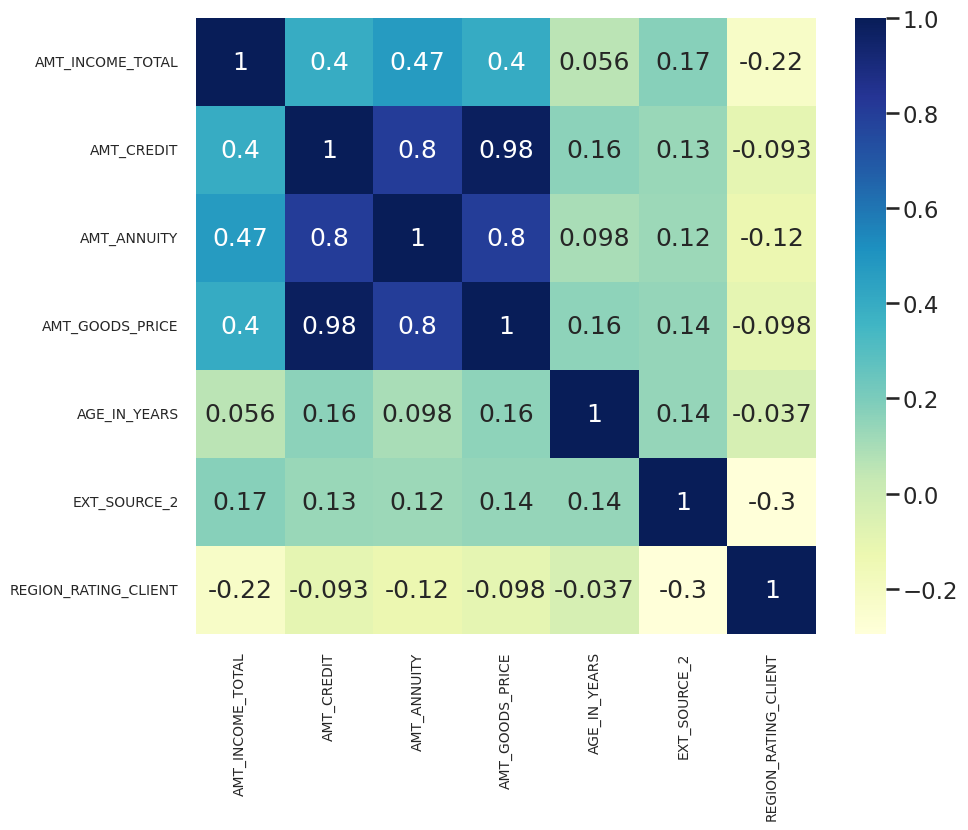

In [161]:
plt.figure(figsize=(10,8))
plot_1 = sns.heatmap(corr_app_df_0.corr(),cmap="YlGnBu",annot=True)
plot_1.set_yticklabels(plot_1.get_yticklabels(), fontsize=10)
plot_1.set_xticklabels(plot_1.get_xticklabels(), fontsize=10)
plt.show()


Strong correlations among columns are observed for non-defaulters as well:

*   Noteworthy correlation of 0.80 is evident between 'AMT_CREDIT' and 'AMT_ANNUITY'.
*   'AMT_CREDIT' and 'AMT_GOODS_PRICE' display a remarkably high correlation of 0.98.


*   Additionally, 'AMT_ANNUITY' and 'AMT_GOODS_PRICE' present a significant correlation of 0.80.

This consistency in correlations across defaulters and non-defaulters suggests a pattern of interdependence between these pairs of columns.

#**Previous application**

In [162]:
pre_app_df = pd.read_csv('previous_application.csv')
pre_app_df.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [163]:
pre_app_df.tail()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
1670209,2300464,352015,Consumer loans,14704.290,267295.5,311400.0,0.0,267295.5,WEDNESDAY,12,Y,1,0.000000,NaN,NaN,XAP,Approved,-544,Cash through the bank,XAP,NaN,Refreshed,Furniture,POS,XNA,Stone,43,Furniture,30.0,low_normal,POS industry with interest,365243.0,-508.0,362.0,-358.0,-351.0,0.0
1670210,2357031,334635,Consumer loans,6622.020,87750.0,64291.5,29250.0,87750.0,TUESDAY,15,Y,1,0.340554,NaN,NaN,XAP,Approved,-1694,Cash through the bank,XAP,Unaccompanied,New,Furniture,POS,XNA,Stone,43,Furniture,12.0,middle,POS industry with interest,365243.0,-1604.0,-1274.0,-1304.0,-1297.0,0.0
1670211,2659632,249544,Consumer loans,11520.855,105237.0,102523.5,10525.5,105237.0,MONDAY,12,Y,1,0.101401,NaN,NaN,XAP,Approved,-1488,Cash through the bank,XAP,"Spouse, partner",Repeater,Consumer Electronics,POS,XNA,Country-wide,1370,Consumer electronics,10.0,low_normal,POS household with interest,365243.0,-1457.0,-1187.0,-1187.0,-1181.0,0.0
1670212,2785582,400317,Cash loans,18821.520,180000.0,191880.0,NaN,180000.0,WEDNESDAY,9,Y,1,NaN,NaN,NaN,XNA,Approved,-1185,Cash through the bank,XAP,Family,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),-1,XNA,12.0,low_normal,Cash X-Sell: low,365243.0,-1155.0,-825.0,-825.0,-817.0,1.0
1670213,2418762,261212,Cash loans,16431.300,360000.0,360000.0,NaN,360000.0,SUNDAY,10,Y,1,NaN,NaN,NaN,XNA,Approved,-1193,Cash through the bank,XAP,Family,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),-1,XNA,48.0,middle,Cash X-Sell: middle,365243.0,-1163.0,247.0,-443.0,-423.0,0.0


In [164]:
pre_app_df.shape

(1670214, 37)

#### ***Calculating Missing Values***

In [165]:
missing_percentage_pre_app_df = round((pre_app_df.isnull().sum()/len(pre_app_df))*100,2)
missing_percentage_pre_app_df

SK_ID_PREV                      0.00
SK_ID_CURR                      0.00
NAME_CONTRACT_TYPE              0.00
AMT_ANNUITY                    22.29
AMT_APPLICATION                 0.00
AMT_CREDIT                      0.00
AMT_DOWN_PAYMENT               53.64
AMT_GOODS_PRICE                23.08
WEEKDAY_APPR_PROCESS_START      0.00
HOUR_APPR_PROCESS_START         0.00
FLAG_LAST_APPL_PER_CONTRACT     0.00
NFLAG_LAST_APPL_IN_DAY          0.00
RATE_DOWN_PAYMENT              53.64
RATE_INTEREST_PRIMARY          99.64
RATE_INTEREST_PRIVILEGED       99.64
NAME_CASH_LOAN_PURPOSE          0.00
NAME_CONTRACT_STATUS            0.00
DAYS_DECISION                   0.00
NAME_PAYMENT_TYPE               0.00
CODE_REJECT_REASON              0.00
NAME_TYPE_SUITE                49.12
NAME_CLIENT_TYPE                0.00
NAME_GOODS_CATEGORY             0.00
NAME_PORTFOLIO                  0.00
NAME_PRODUCT_TYPE               0.00
CHANNEL_TYPE                    0.00
SELLERPLACE_AREA                0.00
N

In [166]:
pre_app_df.replace('XNA',np.nan,inplace=True)
pre_app_df.replace('XAP',np.nan,inplace=True)

In [167]:
missing_percentage_pre_app_df = round((pre_app_df.isnull().sum()/len(pre_app_df))*100,2)
missing_percentage_pre_app_df

SK_ID_PREV                      0.00
SK_ID_CURR                      0.00
NAME_CONTRACT_TYPE              0.02
AMT_ANNUITY                    22.29
AMT_APPLICATION                 0.00
AMT_CREDIT                      0.00
AMT_DOWN_PAYMENT               53.64
AMT_GOODS_PRICE                23.08
WEEKDAY_APPR_PROCESS_START      0.00
HOUR_APPR_PROCESS_START         0.00
FLAG_LAST_APPL_PER_CONTRACT     0.00
NFLAG_LAST_APPL_IN_DAY          0.00
RATE_DOWN_PAYMENT              53.64
RATE_INTEREST_PRIMARY          99.64
RATE_INTEREST_PRIVILEGED       99.64
NAME_CASH_LOAN_PURPOSE         95.83
NAME_CONTRACT_STATUS            0.00
DAYS_DECISION                   0.00
NAME_PAYMENT_TYPE              37.56
CODE_REJECT_REASON             81.33
NAME_TYPE_SUITE                49.12
NAME_CLIENT_TYPE                0.12
NAME_GOODS_CATEGORY            56.93
NAME_PORTFOLIO                 22.29
NAME_PRODUCT_TYPE              63.68
CHANNEL_TYPE                    0.00
SELLERPLACE_AREA                0.00
N

In [168]:
missing_percentage_pre_app_df[missing_percentage_pre_app_df > 30]

AMT_DOWN_PAYMENT             53.64
RATE_DOWN_PAYMENT            53.64
RATE_INTEREST_PRIMARY        99.64
RATE_INTEREST_PRIVILEGED     99.64
NAME_CASH_LOAN_PURPOSE       95.83
NAME_PAYMENT_TYPE            37.56
CODE_REJECT_REASON           81.33
NAME_TYPE_SUITE              49.12
NAME_GOODS_CATEGORY          56.93
NAME_PRODUCT_TYPE            63.68
NAME_SELLER_INDUSTRY         51.23
NAME_YIELD_GROUP             30.97
DAYS_FIRST_DRAWING           40.30
DAYS_FIRST_DUE               40.30
DAYS_LAST_DUE_1ST_VERSION    40.30
DAYS_LAST_DUE                40.30
DAYS_TERMINATION             40.30
NFLAG_INSURED_ON_APPROVAL    40.30
dtype: float64

## **Data Cleaning and Manipulation**

In [169]:
#Excluding columns with missing value rates exceeding 30%
pre_app_df.drop(columns = missing_percentage_pre_app_df[missing_percentage_pre_app_df > 30].index, axis=1,inplace=True)

We've completed a thorough data preprocessing procedure to improve the dataset's quality. Our main objective was addressing missing values, particularly those exceeding 30% in each column. We meticulously removed columns that surpassed this 30% missing value threshold.

In [170]:
pre_app_df.shape

(1670214, 19)

In [171]:
pre_app_df.info(verbose=True, null_counts=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 19 columns):
 #   Column                       Dtype  
---  ------                       -----  
 0   SK_ID_PREV                   int64  
 1   SK_ID_CURR                   int64  
 2   NAME_CONTRACT_TYPE           object 
 3   AMT_ANNUITY                  float64
 4   AMT_APPLICATION              float64
 5   AMT_CREDIT                   float64
 6   AMT_GOODS_PRICE              float64
 7   WEEKDAY_APPR_PROCESS_START   object 
 8   HOUR_APPR_PROCESS_START      int64  
 9   FLAG_LAST_APPL_PER_CONTRACT  object 
 10  NFLAG_LAST_APPL_IN_DAY       int64  
 11  NAME_CONTRACT_STATUS         object 
 12  DAYS_DECISION                int64  
 13  NAME_CLIENT_TYPE             object 
 14  NAME_PORTFOLIO               object 
 15  CHANNEL_TYPE                 object 
 16  SELLERPLACE_AREA             int64  
 17  CNT_PAYMENT                  float64
 18  PRODUCT_COMBINATION          object 
dtype

In [172]:
missing_percentage_pre_app_df = round((pre_app_df.isnull().sum()/len(pre_app_df))*100,2)
missing_percentage_pre_app_df

SK_ID_PREV                      0.00
SK_ID_CURR                      0.00
NAME_CONTRACT_TYPE              0.02
AMT_ANNUITY                    22.29
AMT_APPLICATION                 0.00
AMT_CREDIT                      0.00
AMT_GOODS_PRICE                23.08
WEEKDAY_APPR_PROCESS_START      0.00
HOUR_APPR_PROCESS_START         0.00
FLAG_LAST_APPL_PER_CONTRACT     0.00
NFLAG_LAST_APPL_IN_DAY          0.00
NAME_CONTRACT_STATUS            0.00
DAYS_DECISION                   0.00
NAME_CLIENT_TYPE                0.12
NAME_PORTFOLIO                 22.29
CHANNEL_TYPE                    0.00
SELLERPLACE_AREA                0.00
CNT_PAYMENT                    22.29
PRODUCT_COMBINATION             0.02
dtype: float64

### **Handling Missing Values**
Inspecting and addressing individual columns with missing data in a sequential manner.

#### **AMT_ANNUITY Column**

In [173]:
#Checking and Handling null value in AMT_ANNUITY column
pre_app_df['AMT_ANNUITY'].describe().apply(lambda x: '%.2f' % x)


count    1297979.00
mean       15955.12
std        14782.14
min            0.00
25%         6321.78
50%        11250.00
75%        20658.42
max       418058.15
Name: AMT_ANNUITY, dtype: object

In [174]:
pre_app_df['AMT_ANNUITY'].value_counts(dropna=False)

NaN           372235
2250.000       31865
11250.000      13974
6750.000       13442
9000.000       12496
22500.000      11903
4500.000       10597
13500.000       7171
3375.000        4806
7875.000        4674
38250.000       4129
5625.000        3993
45000.000       3604
10125.000       2558
16875.000       2436
18000.000       1861
29250.000       1662
0.000           1637
12375.000       1634
20250.000       1621
33750.000       1412
15750.000       1370
27000.000       1075
14625.000        864
10492.020        841
36000.000        816
27449.820        731
21709.125        728
5246.010         665
7869.015         653
19151.100        639
25996.365        568
14746.455        564
19125.000        544
24172.650        537
39474.000        532
9830.970         529
9842.400         519
11386.170        514
17079.255        501
40783.995        499
15737.985        496
21375.000        494
24750.000        488
8981.820         486
52788.780        481
9426.240         481
18235.080    

In [175]:
pre_app_df.dropna(subset=['AMT_ANNUITY'], inplace=True)

In [176]:
pre_app_df['AMT_ANNUITY'].isnull().sum()

0

#### ***AMT_GOODS_PRICE***

In [177]:
#Checking and Handling null value in AMT_GOODS_PRICE column
pre_app_df['AMT_GOODS_PRICE'].describe().apply(lambda x: '%.2f' % x)

count    1246320.00
mean      232624.01
std       318672.92
min            0.00
25%        52200.00
50%       112500.00
75%       247500.00
max      5850000.00
Name: AMT_GOODS_PRICE, dtype: object

In [178]:
pre_app_df['AMT_GOODS_PRICE'].value_counts(dropna=False)

NaN            51659
45000.000      47772
225000.000     43351
135000.000     40553
450000.000     38857
90000.000      29275
180000.000     24699
270000.000     20545
675000.000     20152
67500.000      16829
900000.000     15569
112500.000     14355
315000.000     11910
229500.000     10756
337500.000     10531
360000.000     10270
157500.000     10189
1350000.000     8434
202500.000      7928
247500.000      7160
454500.000      7039
1129500.000     6928
540000.000      6837
1125000.000     6390
405000.000      5869
0.000           5579
765000.000      5124
585000.000      4767
292500.000      3786
495000.000      3748
810000.000      3485
630000.000      2872
720000.000      2756
1800000.000     2531
382500.000      2480
22455.000       2421
31455.000       2409
472500.000      2300
184500.000      2221
44955.000       2215
26955.000       2175
1354500.000     2159
679500.000      2130
35955.000       2081
2250000.000     2031
1215000.000     2026
62955.000       1980
238500.000   

In [179]:
pre_app_df.dropna(subset=['AMT_GOODS_PRICE'], inplace=True)

In [180]:
pre_app_df['AMT_GOODS_PRICE'].isnull().sum()

0

#### ***CNT_PAYMENT***

In [181]:
#Check Null in CNT_PAYMENT
pre_app_df['CNT_PAYMENT'].isnull().sum()

0

#### ***PRODUCT_COMBINATION***

In [182]:
#Check Null in PRODUCT_COMBINATION
pre_app_df['PRODUCT_COMBINATION'].isnull().sum()

0

#### ***NAME_CLIENT_TYPE***

In [183]:
pre_app_df['NAME_CLIENT_TYPE'].isnull().sum()

901

In [184]:
# NAME_CLIENT_TYPE
pre_app_df.dropna(subset=['NAME_CLIENT_TYPE'], inplace=True)

In [185]:
#Again checking null value in Previous application
pre_app_df.isnull().sum()

SK_ID_PREV                     0
SK_ID_CURR                     0
NAME_CONTRACT_TYPE             0
AMT_ANNUITY                    0
AMT_APPLICATION                0
AMT_CREDIT                     0
AMT_GOODS_PRICE                0
WEEKDAY_APPR_PROCESS_START     0
HOUR_APPR_PROCESS_START        0
FLAG_LAST_APPL_PER_CONTRACT    0
NFLAG_LAST_APPL_IN_DAY         0
NAME_CONTRACT_STATUS           0
DAYS_DECISION                  0
NAME_CLIENT_TYPE               0
NAME_PORTFOLIO                 0
CHANNEL_TYPE                   0
SELLERPLACE_AREA               0
CNT_PAYMENT                    0
PRODUCT_COMBINATION            0
dtype: int64

In [186]:
pre_app_df.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_CLIENT_TYPE,NAME_PORTFOLIO,CHANNEL_TYPE,SELLERPLACE_AREA,CNT_PAYMENT,PRODUCT_COMBINATION
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,17145.0,SATURDAY,15,Y,1,Approved,-73,Repeater,POS,Country-wide,35,12.0,POS mobile with interest
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,607500.0,THURSDAY,11,Y,1,Approved,-164,Repeater,Cash,Contact center,-1,36.0,Cash X-Sell: low
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,112500.0,TUESDAY,11,Y,1,Approved,-301,Repeater,Cash,Credit and cash offices,-1,12.0,Cash X-Sell: high
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,450000.0,MONDAY,7,Y,1,Approved,-512,Repeater,Cash,Credit and cash offices,-1,12.0,Cash X-Sell: middle
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,337500.0,THURSDAY,9,Y,1,Refused,-781,Repeater,Cash,Credit and cash offices,-1,24.0,Cash Street: high


#### ***DAYS_DECISION(MONTHS_DECISION)***

In [187]:
# DAYS_DECISION
pre_app_df['DAYS_DECISION'].value_counts()

-364     1258
-329     1217
-238     1204
-352     1203
-245     1195
-240     1180
-259     1180
-294     1174
-365     1168
-273     1167
-350     1166
-239     1165
-336     1164
-231     1162
-308     1160
-360     1158
-358     1156
-300     1152
-252     1151
-343     1148
-315     1139
-355     1133
-196     1133
-280     1132
-270     1132
-328     1131
-224     1128
-287     1126
-183     1123
-301     1121
-330     1119
-230     1118
-344     1118
-182     1116
-321     1116
-260     1116
-210     1116
-357     1115
-266     1115
-268     1114
-356     1106
-265     1104
-359     1104
-293     1103
-244     1098
-272     1094
-276     1093
-232     1090
-322     1088
-371     1088
-209     1086
-279     1084
-211     1083
-363     1083
-367     1080
-334     1078
-372     1075
-269     1074
-295     1074
-243     1074
-181     1072
-203     1071
-354     1069
-267     1068
-296     1067
-237     1064
-236     1063
-332     1063
-175     1062
-327     1062
-217     1060
-216  

In [188]:
# converting all DAYS columns to month columns
pre_app_df['DAYS_DECISION'] = abs(pre_app_df['DAYS_DECISION'] // 30)

In [189]:
pre_app_df['DAYS_DECISION'].value_counts()

12    31857
9     31506
10    31372
11    31330
8     30457
13    30025
7     29613
14    28266
15    27225
16    27087
17    26735
18    25999
6     25569
19    24540
21    23567
20    23120
22    22616
23    22322
24    22283
25    22117
5     20562
26    20095
27    18874
28    18022
29    17040
30    16341
4     15832
31    15729
1     15410
32    14912
33    14501
34    13829
35    13589
37    13359
36    13090
2     11727
38    11694
39    10950
3     10294
40     9934
41     9509
42     9280
51     9269
43     9237
50     9222
46     8954
49     8939
45     8842
52     8830
47     8669
48     8648
44     8630
53     8523
82     8025
83     7962
54     7946
86     7936
85     7919
84     7813
87     7661
58     7508
55     7486
57     7391
88     7345
81     7293
59     7215
60     7206
79     7109
61     7024
80     6959
56     6958
78     6882
89     6838
75     6805
77     6783
76     6730
74     6597
73     6500
90     6498
72     6369
62     6358
63     6332
65     6286
64  

#### ***Removing columns that lack significance***

In [190]:
# dropping columns which are not significant for the analysis.
cols_to_be_deleted = ['WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START','FLAG_LAST_APPL_PER_CONTRACT',
                      'NFLAG_LAST_APPL_IN_DAY','SELLERPLACE_AREA','PRODUCT_COMBINATION']

pre_app_df = pre_app_df.drop(cols_to_be_deleted, axis = 1)

In [191]:
pre_app_df.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
       'NAME_CONTRACT_STATUS', 'DAYS_DECISION', 'NAME_CLIENT_TYPE',
       'NAME_PORTFOLIO', 'CHANNEL_TYPE', 'CNT_PAYMENT'],
      dtype='object')

We have successfully eliminated all null values within each column of the dataset.

### **Outliers**

#### **Detecting outliers in numerical variables through the utilization of box plots**

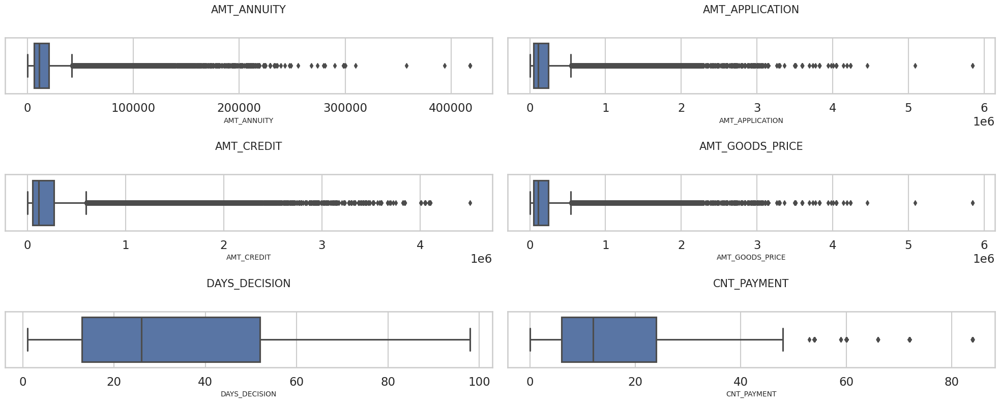

In [192]:
fig = plt.figure(figsize=(20, 40))
outlier_col_pre_app_df = pre_app_df.select_dtypes(include=['number']).columns.tolist()
outlier_col_pre_app_df.remove('SK_ID_PREV')
outlier_col_pre_app_df.remove('SK_ID_CURR')
a = 15
b = 2
c = 1

# Loop through columns and create box plots
for i in outlier_col_pre_app_df:
    plt.subplot(a, b, c)
    plt.title('{}'.format(i))
    sns.boxplot(x=pre_app_df[i])  # Use 'x' parameter to specify the column for box plot
    c = c + 1

fig.tight_layout()
plt.show()

Upon plotting the box plots, it becomes evident that outliers exist in every column. To address this issue, we are taking measures to handle the outliers in each column individually.

In [193]:
outlier_col_pre_app_df

['AMT_ANNUITY',
 'AMT_APPLICATION',
 'AMT_CREDIT',
 'AMT_GOODS_PRICE',
 'DAYS_DECISION',
 'CNT_PAYMENT']

### **Managing columns with outliers**

#### ***AMT_ANNUITY***

In [194]:
pre_app_df['AMT_ANNUITY'].describe(percentiles = [0.75,0.85,0.90,0.95,0.99]).apply(lambda x: '%.2f' % x)

count    1245419.00
mean       16058.26
std        14930.02
min            0.00
50%        11250.00
75%        20608.76
85%        28263.11
90%        34849.85
95%        45864.36
99%        70224.30
max       418058.15
Name: AMT_ANNUITY, dtype: object

In [195]:
q3=pre_app_df["AMT_ANNUITY"].quantile(0.90)
pre_app_df["AMT_ANNUITY"] =  pre_app_df.AMT_ANNUITY.apply(lambda x: q3 if x>q3 else x)

In [196]:
pre_app_df['AMT_ANNUITY'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean       14451.04
std        10165.92
min            0.00
25%         6327.52
50%        11250.00
75%        20608.76
max        34849.85
Name: AMT_ANNUITY, dtype: object

#### ***AMT_APPLICATION***

In [197]:
pre_app_df['AMT_APPLICATION'].describe(percentiles = [0.75,0.85,0.90,0.95,0.99]).apply(lambda x: '%.2f' % x)

count    1245419.00
mean      232545.74
std       318628.60
min            0.00
50%       112500.00
75%       247500.00
85%       450000.00
90%       630000.00
95%       900000.00
99%      1438159.50
max      5850000.00
Name: AMT_APPLICATION, dtype: object

In [198]:
q3=pre_app_df["AMT_APPLICATION"].quantile(0.75)
pre_app_df["AMT_APPLICATION"] =  pre_app_df.AMT_APPLICATION.apply(lambda x: q3 if x>q3 else x)

In [199]:
pre_app_df['AMT_APPLICATION'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean      132765.81
std        85018.64
min            0.00
25%        52195.50
50%       112500.00
75%       247500.00
max       247500.00
Name: AMT_APPLICATION, dtype: object

#### ***AMT_CREDIT***

In [200]:
pre_app_df['AMT_CREDIT'].describe(percentiles = [0.75,0.85,0.90,0.95,0.99]).apply(lambda x: '%.2f' % x)

count    1245419.00
mean      249219.19
std       346553.44
min            0.00
50%       116131.50
75%       270000.00
85%       481185.00
90%       675000.00
95%      1004544.00
99%      1575000.00
max      4509688.50
Name: AMT_CREDIT, dtype: object

In [201]:
q3=pre_app_df["AMT_CREDIT"].quantile(0.75)
pre_app_df["AMT_CREDIT"] =  pre_app_df.AMT_CREDIT.apply(lambda x: q3 if x>q3 else x)

In [202]:
pre_app_df['AMT_CREDIT'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean      140731.54
std        94484.58
min            0.00
25%        51561.00
50%       116131.50
75%       270000.00
max       270000.00
Name: AMT_CREDIT, dtype: object

#### ***AMT_GOODS_PRICE***

In [203]:
pre_app_df['AMT_GOODS_PRICE'].describe(percentiles = [0.75,0.85,0.90,0.95,0.99]).apply(lambda x: '%.2f' % x)

count    1245419.00
mean      232575.55
std       318647.08
min            0.00
50%       112500.00
75%       247500.00
85%       450000.00
90%       630000.00
95%       900000.00
99%      1438159.50
max      5850000.00
Name: AMT_GOODS_PRICE, dtype: object

In [204]:
q3=pre_app_df["AMT_GOODS_PRICE"].quantile(0.75)
pre_app_df["AMT_GOODS_PRICE"] =  pre_app_df.AMT_GOODS_PRICE.apply(lambda x: q3 if x>q3 else x)

In [205]:
pre_app_df['AMT_GOODS_PRICE'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean      132771.95
std        85019.80
min            0.00
25%        52197.86
50%       112500.00
75%       247500.00
max       247500.00
Name: AMT_GOODS_PRICE, dtype: object

#### ***CNT_PAYMENT***

In [206]:
pre_app_df['CNT_PAYMENT'].describe(percentiles = [0.75,0.85,0.90,0.95,0.99]).apply(lambda x: '%.2f' % x)

count    1245419.00
mean          16.72
std           14.48
min            0.00
50%           12.00
75%           24.00
85%           30.00
90%           36.00
95%           48.00
99%           60.00
max           84.00
Name: CNT_PAYMENT, dtype: object

In [207]:
q3=pre_app_df["CNT_PAYMENT"].quantile(0.90)
pre_app_df["CNT_PAYMENT"] =  pre_app_df.CNT_PAYMENT.apply(lambda x: q3 if x>q3 else x)

In [208]:
pre_app_df['CNT_PAYMENT'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean          15.16
std           10.77
min            0.00
25%            6.00
50%           12.00
75%           24.00
max           36.00
Name: CNT_PAYMENT, dtype: object

#### ***DAYS_DECISION***

In [209]:
# DAYS_DECISION
pre_app_df['DAYS_DECISION'].describe(percentiles = [0.75,0.85,0.90,0.95,0.99]).apply(lambda x: '%.2f' % x)

count    1245419.00
mean          34.57
std           26.21
min            1.00
50%           26.00
75%           52.00
85%           70.00
90%           79.00
95%           87.00
99%           95.00
max           98.00
Name: DAYS_DECISION, dtype: object

In [210]:
q3=pre_app_df["DAYS_DECISION"].quantile(0.90)
pre_app_df["DAYS_DECISION"] =  pre_app_df.DAYS_DECISION.apply(lambda x: q3 if x>q3 else x)

In [211]:
pre_app_df['DAYS_DECISION'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean          33.70
std           24.49
min            1.00
25%           13.00
50%           26.00
75%           52.00
max           79.00
Name: DAYS_DECISION, dtype: object

#### ***Revisiting the box plots to assess the presence of outliers***

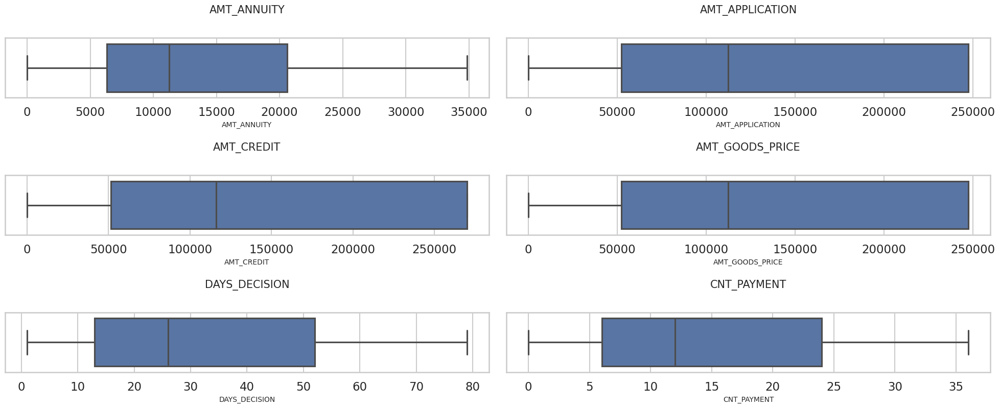

In [212]:

a = 15
b = 2
c = 1
fig = plt.figure(figsize=(20, 40))
# Loop through columns and create box plots
for i in outlier_col_pre_app_df:
    plt.subplot(a, b, c)
    plt.title('{}'.format(i))
    sns.boxplot(x=pre_app_df[i])  # Use 'x' parameter to specify the column for box plot
    c = c + 1

fig.tight_layout()
plt.show()

After examining the box plots of the numerical columns, it's clear that there are no visible outliers present.

#### **Checking if any duplicate values in SK_ID_CURR**

In [213]:
#checking if any duplicate values in SK_ID_PREV
duplicate = pre_app_df[pre_app_df.duplicated(subset='SK_ID_CURR')]
duplicate.shape

(907957, 13)

The presence of duplicates in the 'SK_ID_CURR' column of the pre_app_df suggests that there is a one-to-many relationship between the app_df and pre_app_df.

#### ***Retrieving columns with object data type from the pre_app_df dataset.***

In [214]:
object_columns_pre_app_df = pre_app_df.select_dtypes(include=['object']).columns
print(object_columns_pre_app_df)

Index(['NAME_CONTRACT_TYPE', 'NAME_CONTRACT_STATUS', 'NAME_CLIENT_TYPE',
       'NAME_PORTFOLIO', 'CHANNEL_TYPE'],
      dtype='object')


In [215]:
#checking value counts in list of Object columns
for col in object_columns_pre_app_df:
  print(pre_app_df[col].value_counts(normalize=True))
  print("===================\n")

Consumer loans     0.554801
Cash loans         0.370348
Revolving loans    0.074851
Name: NAME_CONTRACT_TYPE, dtype: float64

Approved        0.797611
Refused         0.193242
Canceled        0.008417
Unused offer    0.000730
Name: NAME_CONTRACT_STATUS, dtype: float64

Repeater     0.677556
New          0.236505
Refreshed    0.085939
Name: NAME_CLIENT_TYPE, dtype: float64

POS      0.554460
Cash     0.370348
Cards    0.074851
Cars     0.000341
Name: NAME_PORTFOLIO, dtype: float64

Country-wide                  0.359321
Credit and cash offices       0.317915
Stone                         0.166672
Regional / Local              0.085018
AP+ (Cash loan)               0.038087
Contact center                0.027812
Channel of corporate sales    0.004812
Car dealer                    0.000363
Name: CHANNEL_TYPE, dtype: float64



#### ***Generate both count bar charts and pie charts for columns with categorical data***

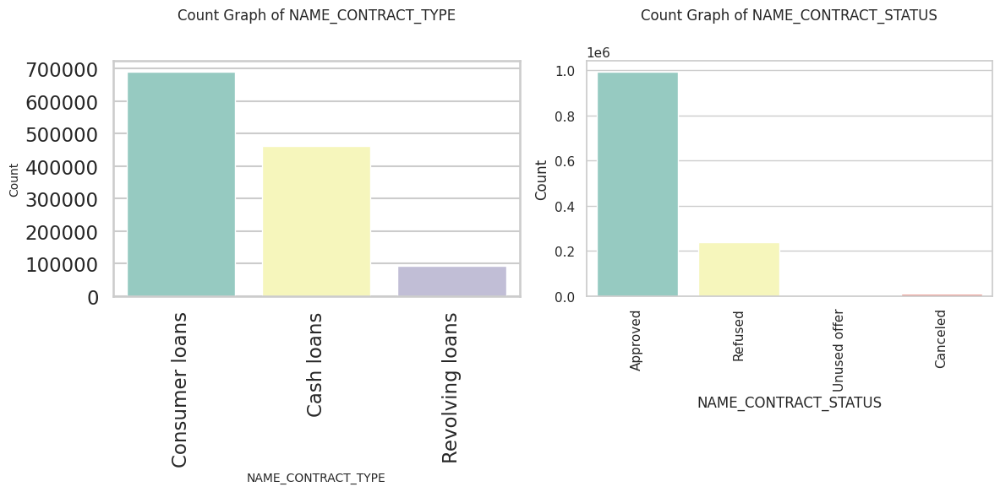

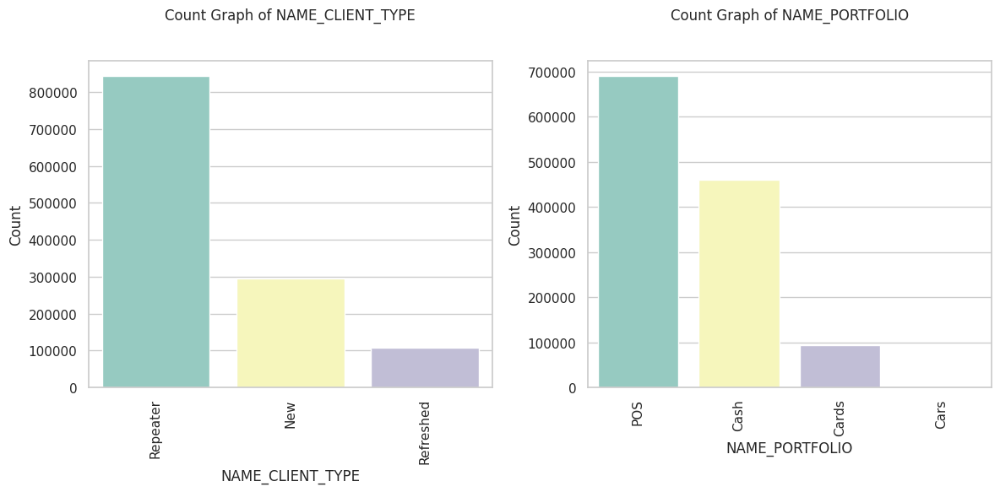

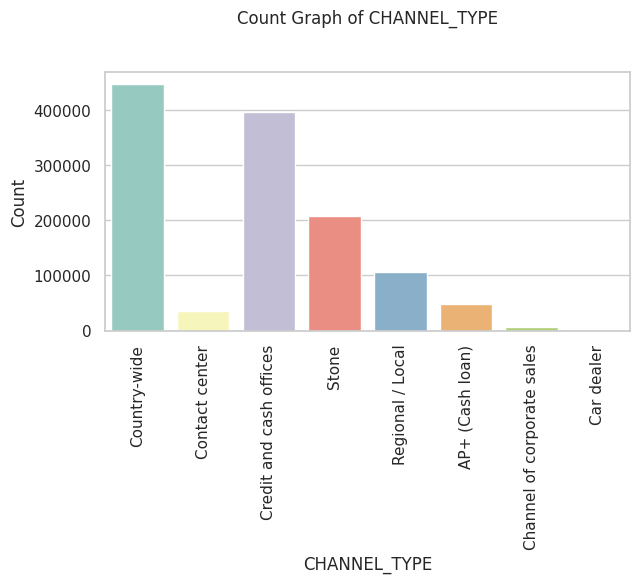

In [216]:
num_cols = 2
num_rows = (len(object_columns_pre_app_df) + num_cols - 1) // num_cols

for idx, col in enumerate(object_columns_pre_app_df):

    if idx % num_cols == 0:
        plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, (idx % num_cols) + 1)
    sns.set(style="whitegrid")

    sns.countplot(data=pre_app_df, x=col, palette="Set3")
    plt.xlabel(col)
    plt.ylabel("Count")
    plt.title("Count Graph of " + col)
    plt.xticks(rotation=90)  # Rotate x-axis labels for better readability


    if (idx + 1) % num_cols == 0 or idx == len(object_columns_pre_app_df) - 1:
        plt.tight_layout()  # Adjust subplot layout
        plt.show()

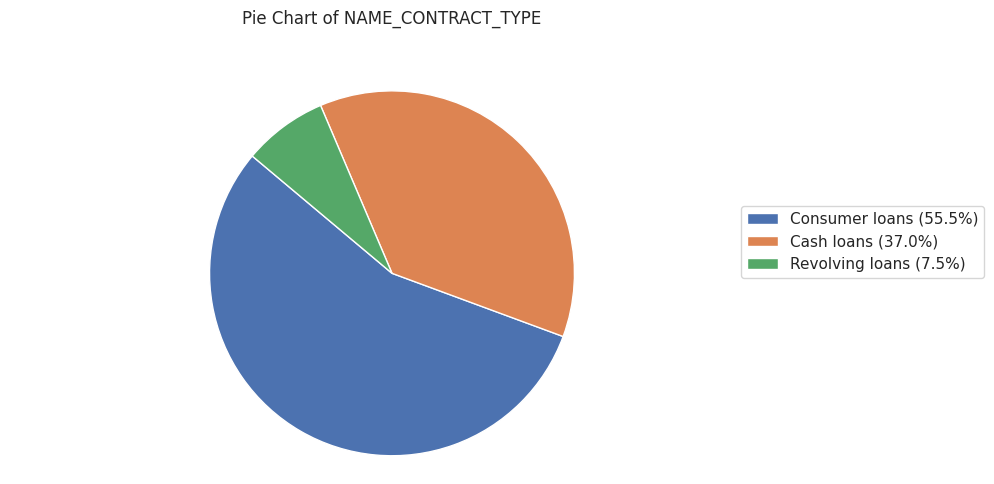

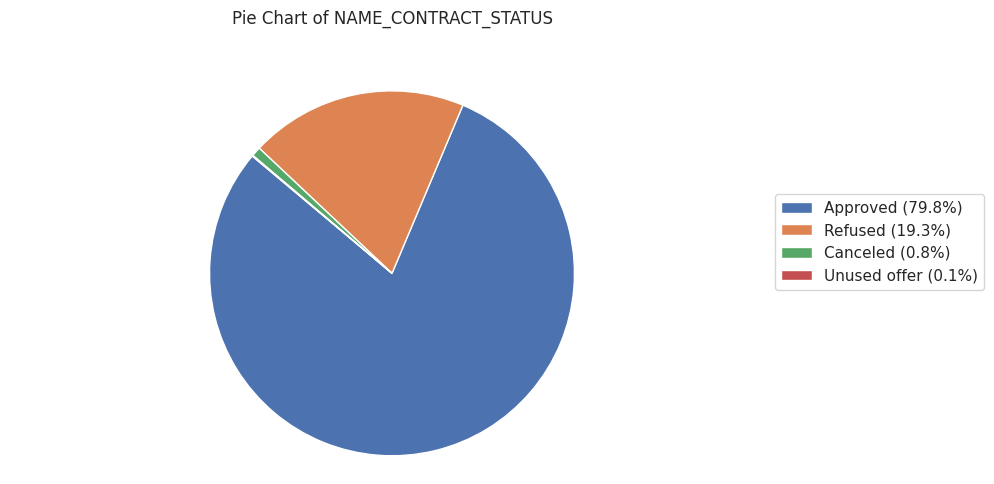

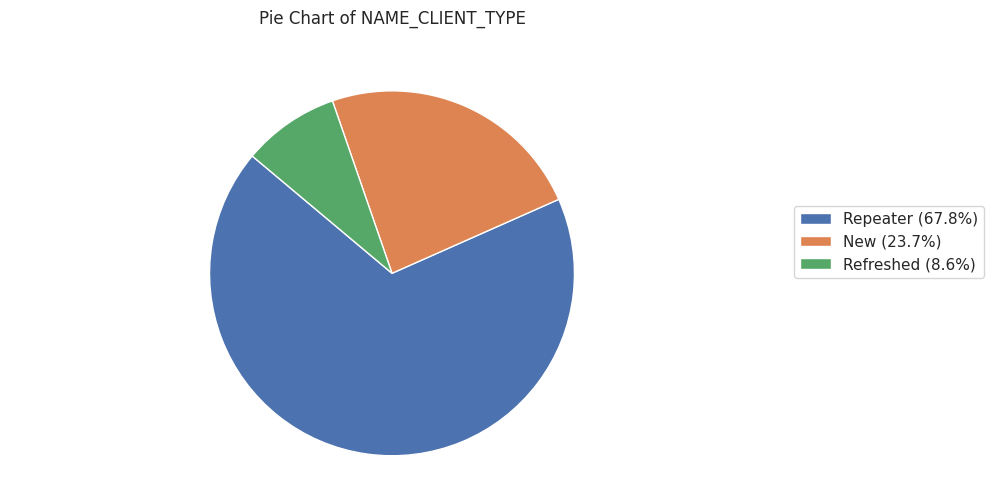

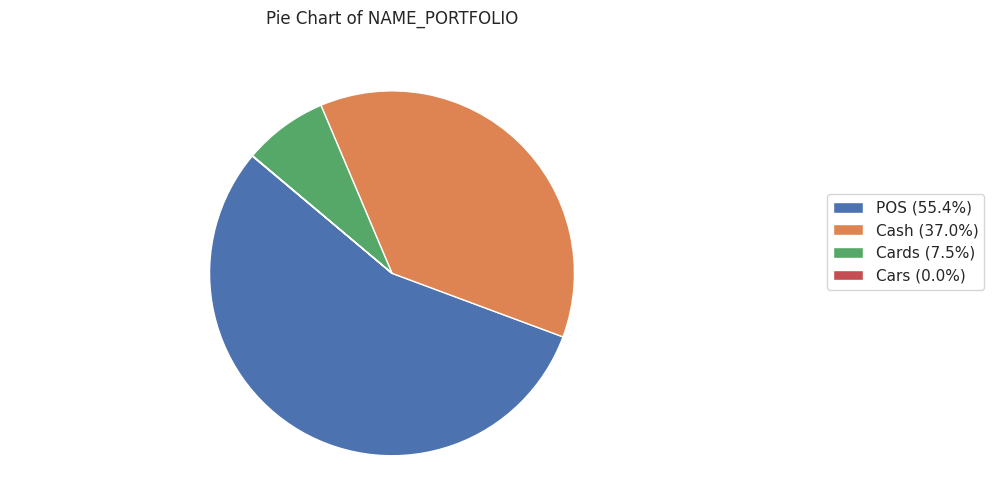

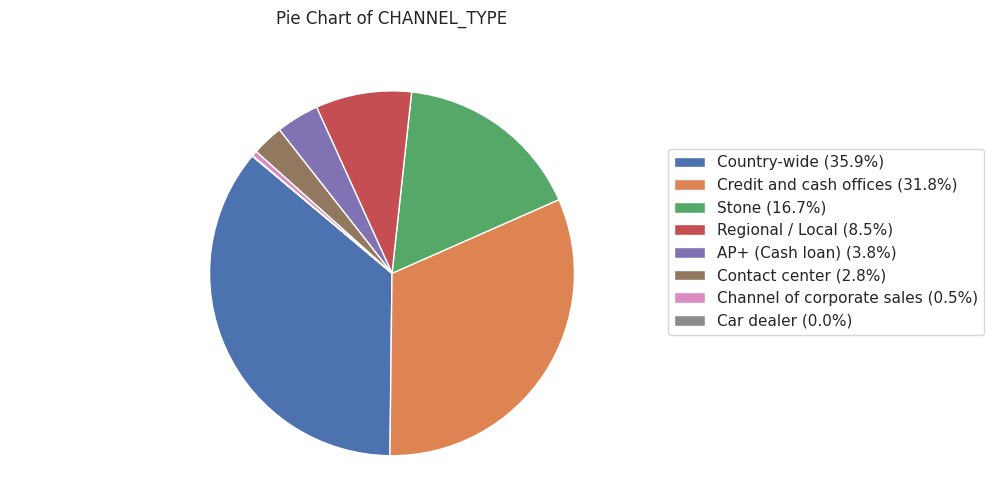

In [217]:
for col in object_columns_pre_app_df:
    # Extract the data for the current column
    col_values = pre_app_df[col].value_counts()

    fig, ax = plt.subplots(figsize=(8, 5))

    # Create a pie chart
    wedges, texts, autotexts = ax.pie(col_values, labels=None, autopct='', startangle=140,
                                       textprops={'fontsize': 12})
    ax.axis('equal')
    ax.set_title("Pie Chart of " + col)

    # Print percentages outside the pie chart
    for autotext in autotexts:
        autotext.set(size=10)

    # Add a legend outside the figure (right side)
    legend_labels = [f'{label} ({value:.1f}%)' for label, value in zip(col_values.index, col_values / col_values.sum() * 100)]
    fig.legend(legend_labels, loc='center right', bbox_to_anchor=(1.25, 0.5))

    plt.tight_layout()
    plt.show()


**NAME_CONTRACT_TYPE Count Graph:**

* The distribution of contract types reveals that the count for "Consumer loans" is the highest among all contract types, followed by "Cash loans" and "Revolving loans."
* "Cash loans" outnumber "Revolving loans" in the distribution graph.

**NAME_CONTRACT_STATUS Count Graph:**

* Among various contract statuses, "Approved" has a significantly higher frequency compared to the other contract status values.
*The distribution suggests a lack of "Used offer" contract statuses, and the number of "Canceled" contract statuses is quite minimal.
* Approximately 79% of the loans have been approved, while the remaining percentage corresponds to loans that were either refused, cancelled, or left unused. This indicates an **imbalance** in the dataset.

**NAME_CLIENT_TYPE Count Graph:**

* The distribution of client types highlights that "Repeater" clients are predominant compared to other types of clients.
* Repeater clients constitute around 67% of the total count.
* A notably lower frequency is observed for "Refreshed" client types.

**NAME_PORTFOLIO Distribution Graph:**

* In the portfolio distribution, the count for "POS" portfolio is the highest, surpassing other portfolio types.
* A majority of approximately 55% of applicants have availed loans for the purpose of POS purchases.
* "Cash" portfolio has a higher frequency compared to "Revolving" and "Cards" portfolios.
* "Car" portfolio has no frequency recorded.

**CHANNEL_TYPE Count Graph:**

* The distribution of channel types shows that "Country-wide" channels have the highest frequency, followed by "Credit and cash offices."
*While "Corporate sales" channel is less frequent, it's notable that it's not entirely absent. Additionally, there is no recorded frequency for the "Car dealer" channel.

These insights provide a comprehensive overview of the distribution patterns across different categorical variables in the dataset.

## **Produce various visualizations for columns that hold numerical data and categorical data in order to conduct the analysis**

#### ***Bar Plot for numerical columns (Univariate Analysis)***

In [218]:
numberic_col_pre_app_df = outlier_col_pre_app_df
numberic_col_pre_app_df

['AMT_ANNUITY',
 'AMT_APPLICATION',
 'AMT_CREDIT',
 'AMT_GOODS_PRICE',
 'DAYS_DECISION',
 'CNT_PAYMENT']

##### ***AMT_ANNUITY***

In [219]:
pre_app_df['AMT_ANNUITY'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean       14451.04
std        10165.92
min            0.00
25%         6327.52
50%        11250.00
75%        20608.76
max        34849.85
Name: AMT_ANNUITY, dtype: object

In [220]:
# Creating bins for AMT_ANNUITY_GROUP
bins = list(range(0, 35001, 5000))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 30000"
pre_app_df['AMT_ANNUITY_GROUP']= pd.cut(pre_app_df.AMT_ANNUITY,bins=bins, labels=labels,include_lowest=True)

pre_app_df['AMT_ANNUITY_GROUP'].value_counts()


5000-10000         335738
10000-15000        235972
0-5000             214008
More than 30000    165349
15000-20000        135198
20000-25000         92005
25000-30000         67149
Name: AMT_ANNUITY_GROUP, dtype: int64

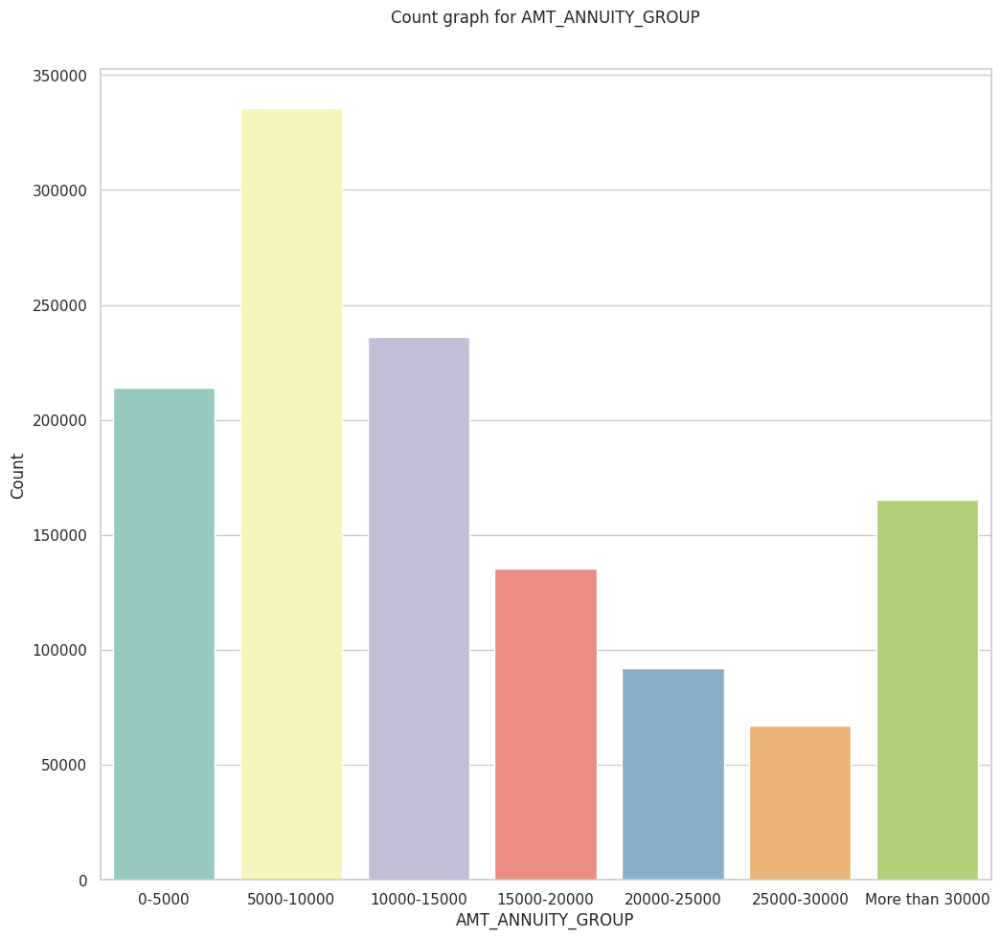

In [221]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(12, 11))
sns.countplot(data=pre_app_df, x='AMT_ANNUITY_GROUP', palette="Set3")

plt.xlabel("AMT_ANNUITY_GROUP")
plt.ylabel("Count")
plt.title("Count graph for AMT_ANNUITY_GROUP")
plt.show()

##### ***AMT_APPLICATION***

In [222]:
pre_app_df['AMT_APPLICATION'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean      132765.81
std        85018.64
min            0.00
25%        52195.50
50%       112500.00
75%       247500.00
max       247500.00
Name: AMT_APPLICATION, dtype: object

In [223]:
# Creating bins for AMT_APPLICATION
bins = list(range(0, 250001, 50000))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 200000"
pre_app_df['AMT_APPLICATION_GROUP']= pd.cut(pre_app_df.AMT_APPLICATION,bins=bins, labels=labels,include_lowest=True)

pre_app_df['AMT_APPLICATION_GROUP'].value_counts()


More than 200000    398607
0-50000             300120
50000-100000        271882
100000-150000       185167
150000-200000        89643
Name: AMT_APPLICATION_GROUP, dtype: int64

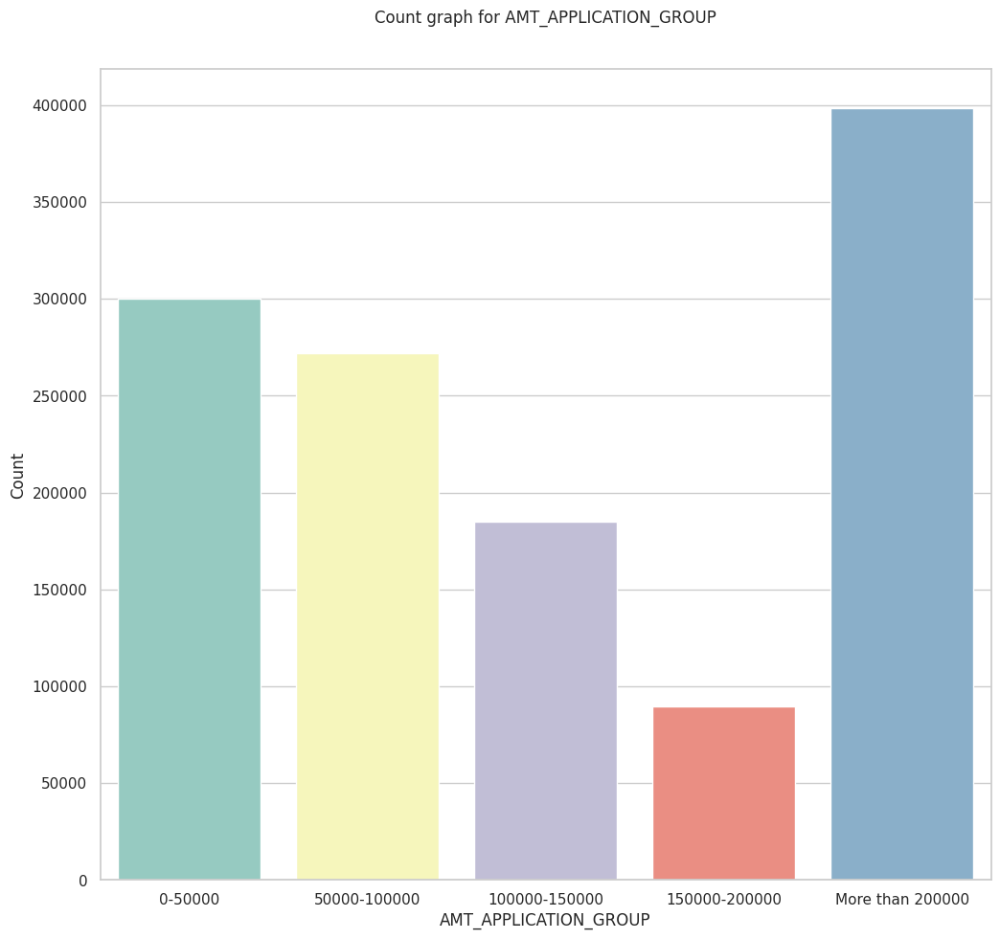

In [224]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(12, 11))
sns.countplot(data=pre_app_df, x='AMT_APPLICATION_GROUP', palette="Set3")

plt.xlabel("AMT_APPLICATION_GROUP")
plt.ylabel("Count")
plt.title("Count graph for AMT_APPLICATION_GROUP")
plt.show()

##### ***AMT_CREDIT***

In [225]:
pre_app_df['AMT_CREDIT'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean      140731.54
std        94484.58
min            0.00
25%        51561.00
50%       116131.50
75%       270000.00
max       270000.00
Name: AMT_CREDIT, dtype: object

In [226]:
# Creating bins for AMT_CREDIT
bins = list(range(0, 300001, 50000))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 250000"
pre_app_df['AMT_CREDIT_GROUP']= pd.cut(pre_app_df.AMT_CREDIT,bins=bins, labels=labels,include_lowest=True)

pre_app_df['AMT_CREDIT_GROUP'].value_counts()


More than 250000    338623
0-50000             302420
50000-100000        259346
100000-150000       173891
150000-200000        97071
200000-250000        74068
Name: AMT_CREDIT_GROUP, dtype: int64

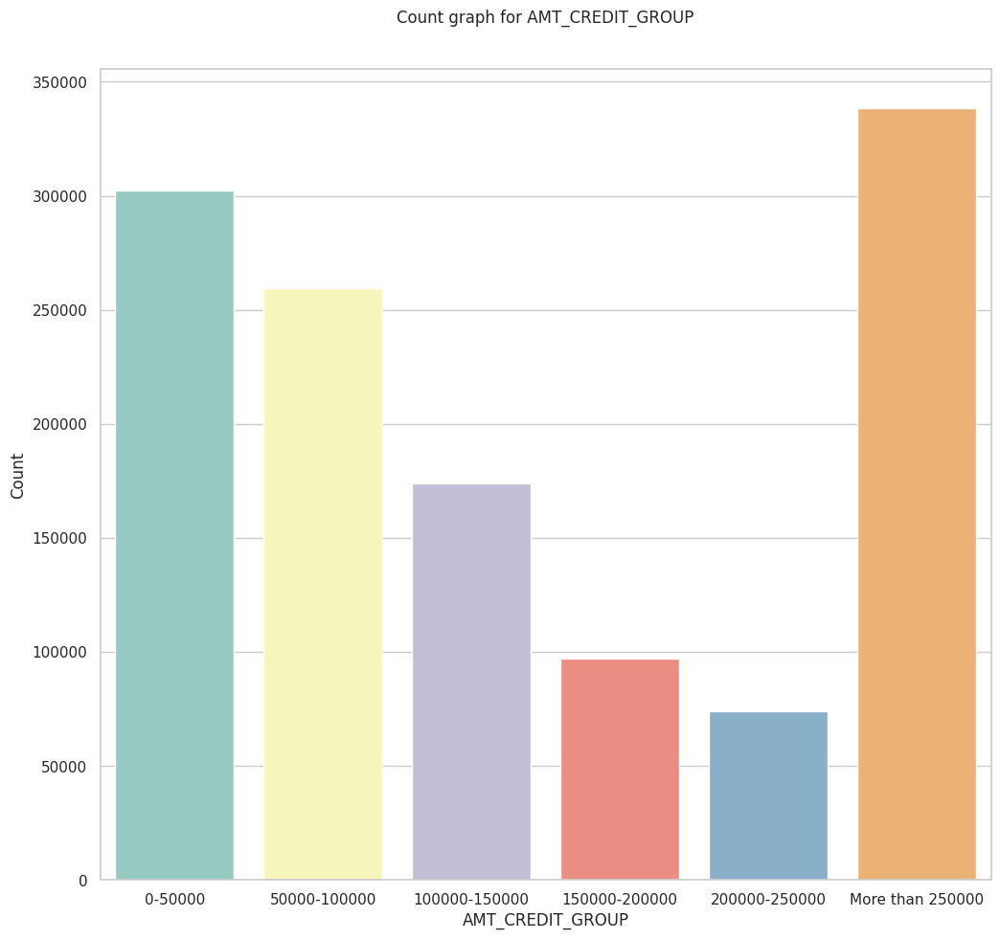

In [227]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(12, 11))
sns.countplot(data=pre_app_df, x='AMT_CREDIT_GROUP', palette="Set3")

plt.xlabel("AMT_CREDIT_GROUP")
plt.ylabel("Count")
plt.title("Count graph for AMT_CREDIT_GROUP")
plt.show()

##### ***AMT_GOODS_PRICE***

In [228]:
pre_app_df['AMT_GOODS_PRICE'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean      132771.95
std        85019.80
min            0.00
25%        52197.86
50%       112500.00
75%       247500.00
max       247500.00
Name: AMT_GOODS_PRICE, dtype: object

In [229]:
# Creating bins for AMT_GOODS_PRICE
bins = list(range(0, 250001, 50000))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 200000"
pre_app_df['AMT_GOODS_PRICE_GROUP']= pd.cut(pre_app_df.AMT_GOODS_PRICE,bins=bins, labels=labels,include_lowest=True)

pre_app_df['AMT_GOODS_PRICE_GROUP'].value_counts()


More than 200000    398650
0-50000             300102
50000-100000        271878
100000-150000       185150
150000-200000        89639
Name: AMT_GOODS_PRICE_GROUP, dtype: int64

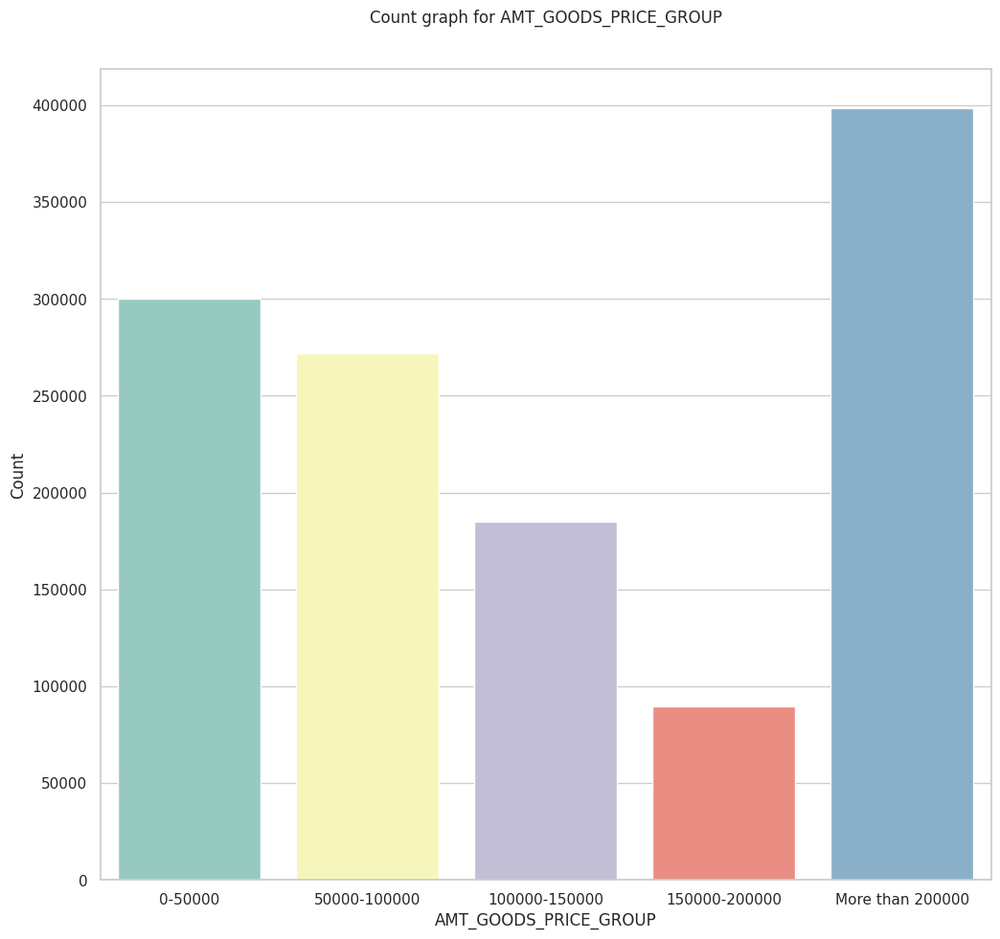

In [230]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(12, 11))
sns.countplot(data=pre_app_df, x='AMT_GOODS_PRICE_GROUP', palette="Set3")

plt.xlabel("AMT_GOODS_PRICE_GROUP")
plt.ylabel("Count")
plt.title("Count graph for AMT_GOODS_PRICE_GROUP")
plt.show()

##### ***CNT_PAYMENT***

In [231]:
pre_app_df['CNT_PAYMENT'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean          15.16
std           10.77
min            0.00
25%            6.00
50%           12.00
75%           24.00
max           36.00
Name: CNT_PAYMENT, dtype: object

In [232]:
# Creating bins for CNT_PAYMENT
bins = list(range(0, 37, 6))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 30"
pre_app_df['CNT_PAYMENT_GROUP']= pd.cut(pre_app_df.CNT_PAYMENT,bins=bins, labels=labels,include_lowest=True)

pre_app_df['CNT_PAYMENT_GROUP'].value_counts()


6-12            498268
0-6             315536
More than 30    182761
18-24           139533
12-18            92368
24-30            16953
Name: CNT_PAYMENT_GROUP, dtype: int64

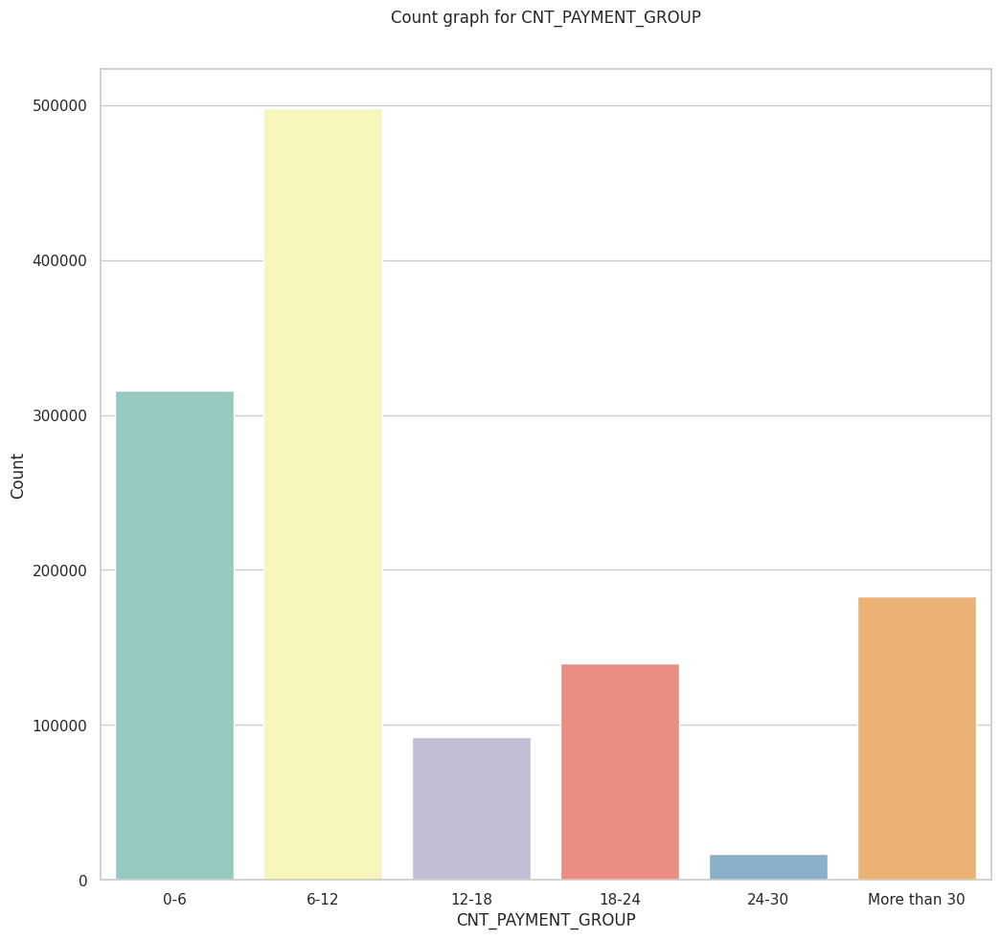

In [233]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(12, 11))
sns.countplot(data=pre_app_df, x='CNT_PAYMENT_GROUP', palette="Set3")

plt.xlabel("CNT_PAYMENT_GROUP")
plt.ylabel("Count")
plt.title("Count graph for CNT_PAYMENT_GROUP")
plt.show()

##### ***DAYS_DECISION***

In [234]:
pre_app_df['DAYS_DECISION'].describe().apply(lambda x: '%.2f' % x)

count    1245419.00
mean          33.70
std           24.49
min            1.00
25%           13.00
50%           26.00
75%           52.00
max           79.00
Name: DAYS_DECISION, dtype: object

In [235]:
# Creating bins for DAYS_DECISION
bins = list(range(0, 81, 10))
labels = ['{}-{}'.format(bins[i], bins[i+1]) for i in range(len(bins)-1)]
labels[-1] = "More than 60"
pre_app_df['DAYS_DECISION_GROUP']= pd.cut(pre_app_df.DAYS_DECISION,bins=bins, labels=labels,include_lowest=True)

pre_app_df['DAYS_DECISION_GROUP'].value_counts()


10-20           276184
0-10            222342
20-30           203277
More than 60    181429
30-40           131587
40-50            89930
50-60            78332
60-70            62338
Name: DAYS_DECISION_GROUP, dtype: int64

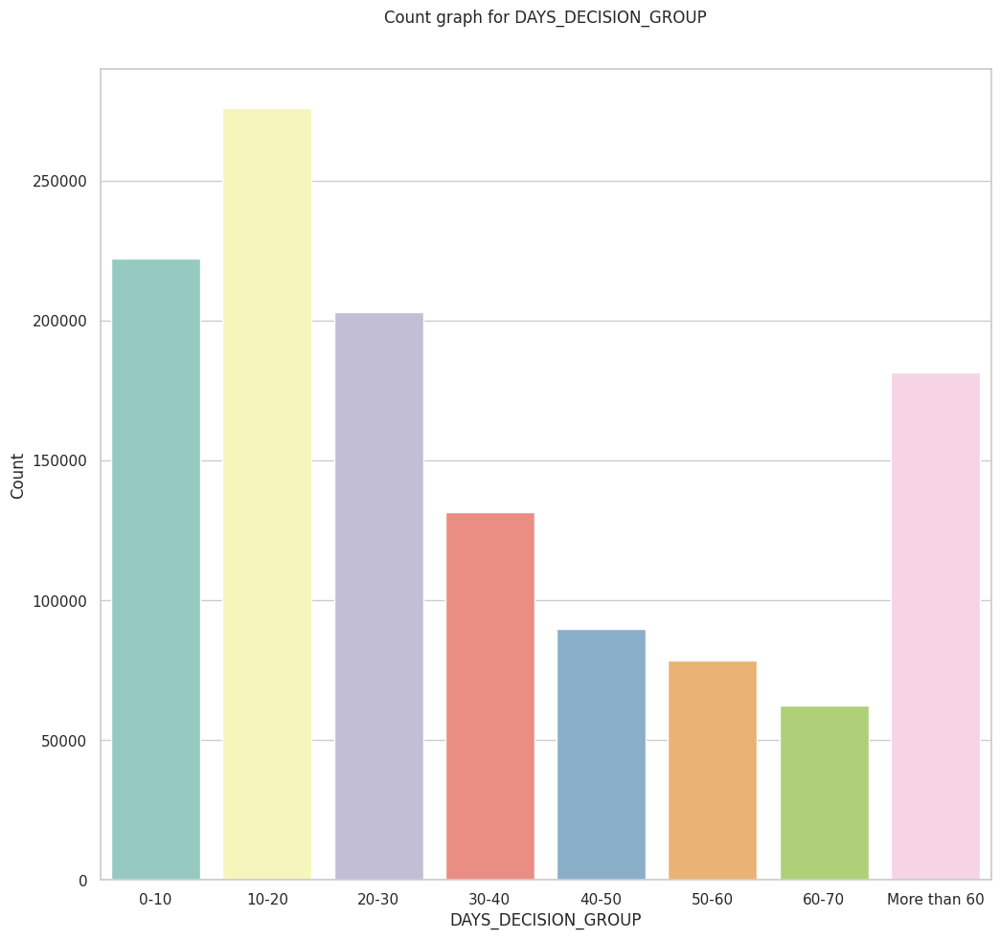

In [236]:
# Create a bar plot using seaborn
sns.set(style="whitegrid")
plt.figure(figsize=(12, 11))
sns.countplot(data=pre_app_df, x='DAYS_DECISION_GROUP', palette="Set3")

plt.xlabel("DAYS_DECISION_GROUP")
plt.ylabel("Count")
plt.title("Count graph for DAYS_DECISION_GROUP")
plt.show()

#### ***Distplot graph for numerical columns(Univariate Analysis)***

Creating histograms for numerical columns of datasets, and noting that they exhibit different density distributions.

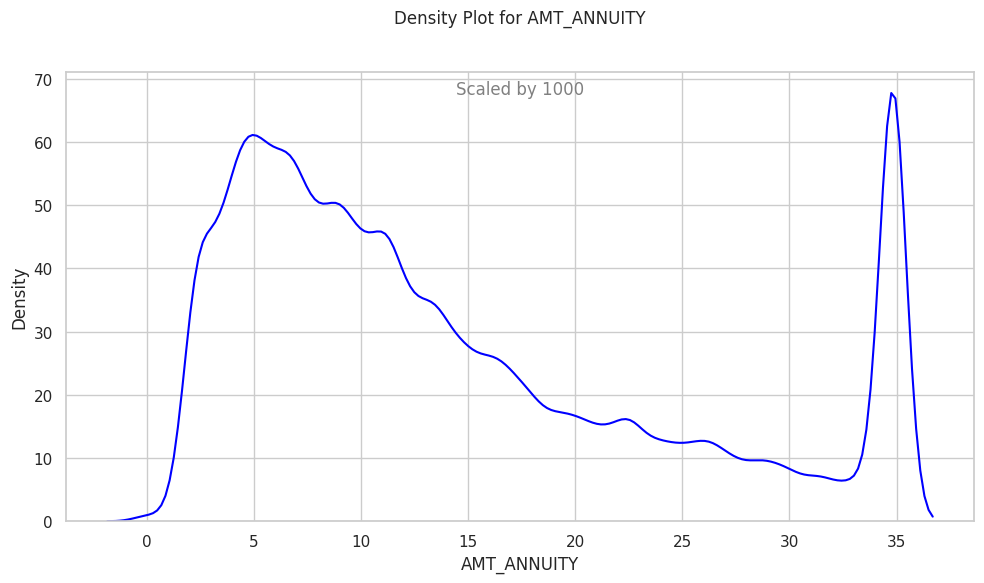

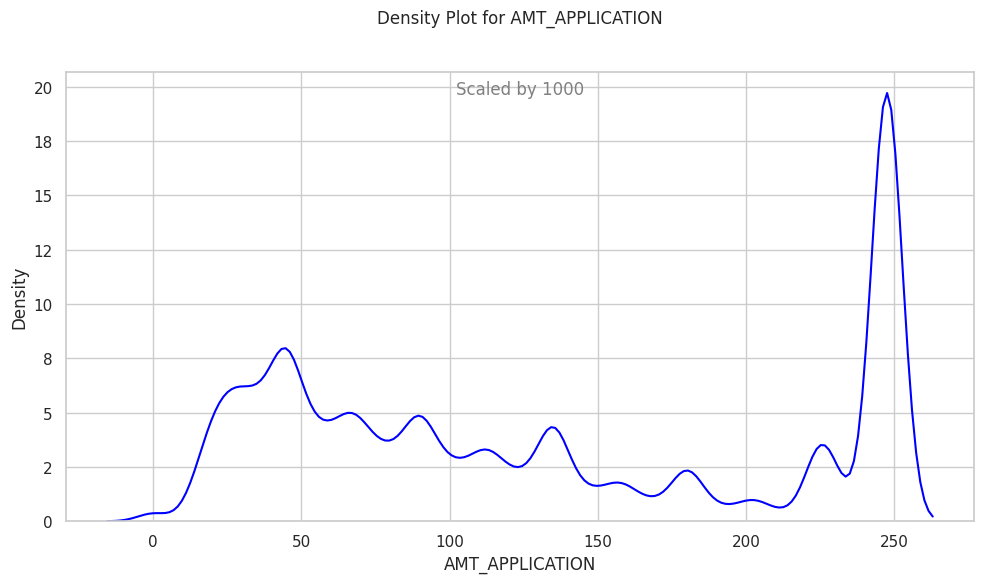

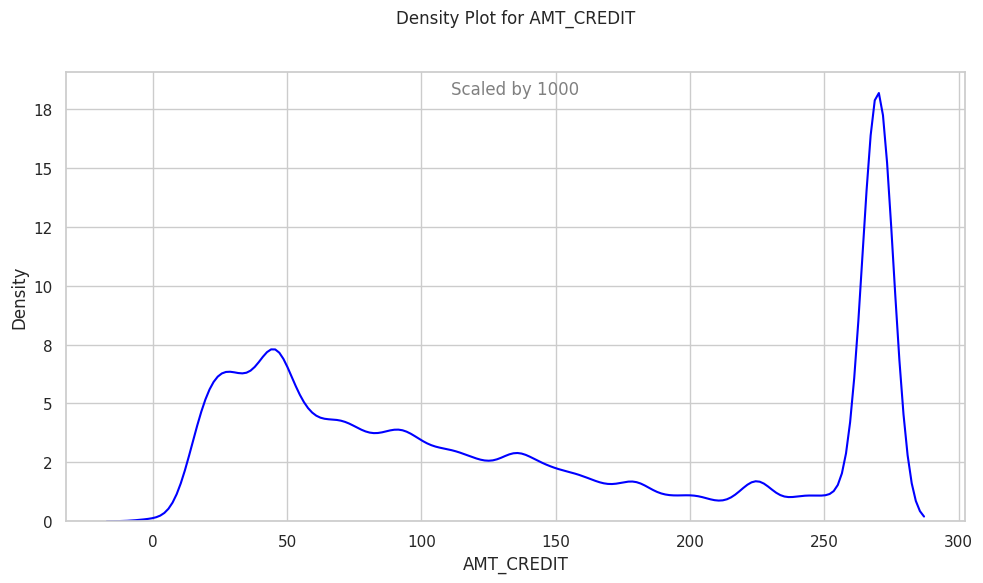

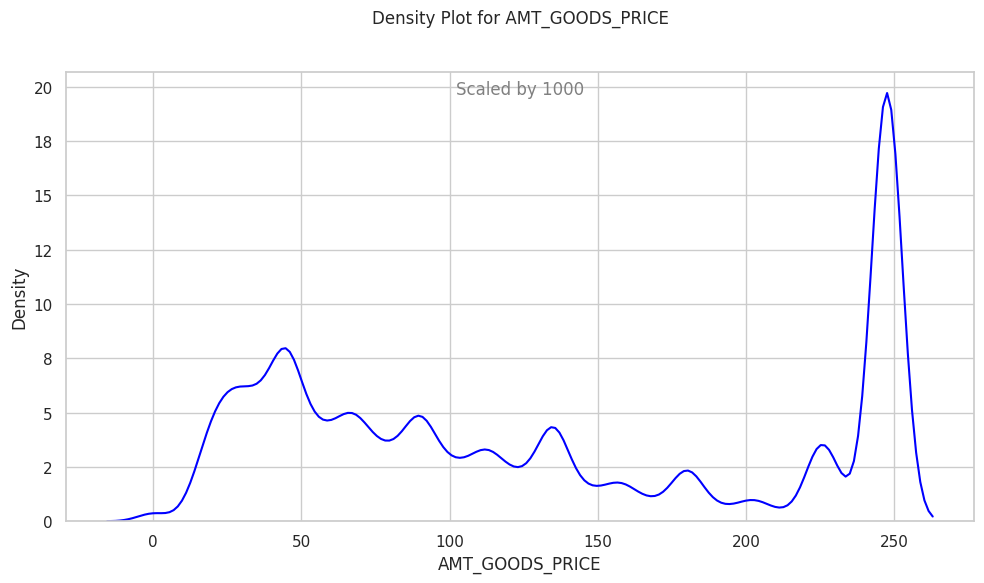

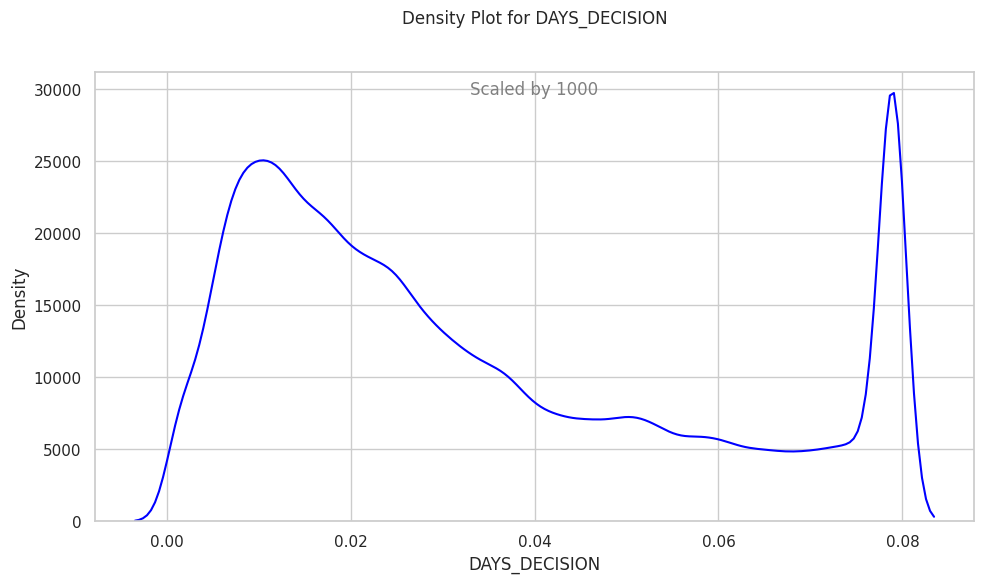

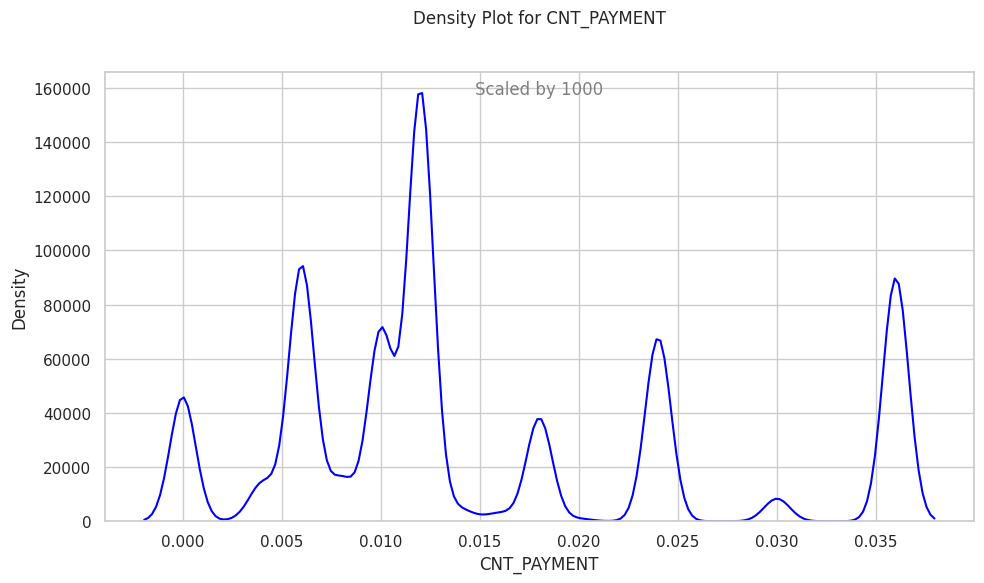

In [237]:

cols = numberic_col_pre_app_df
scaling_factor = 1000
for col in cols:
    sns.set(style="whitegrid")
    fig, axes = plt.subplots(1, 1, figsize=(10, 6))
    sns.distplot(pre_app_df[col] / scaling_factor, hist=False, ax=axes, color='blue')
    axes.set_title('Density Plot for ' + col )
    # Update y-axis tick labels to show scaled values
    y_ticks = [tick * scaling_factor for tick in axes.get_yticks()]
    axes.set_yticklabels(['{:.0f}'.format(tick) for tick in y_ticks])

    # Add scaling factor annotation
    axes.annotate('Scaled by {}'.format(scaling_factor), xy=(0.5, 0.95), xycoords='axes fraction',
                  fontsize=12, ha='center', color='gray')
    plt.tight_layout()
    plt.show()

#### ***Bar Plot: AMT_CREDIT vs AMT_GOODS_PRICE_GROUP Across Different Object Type Columns(Bivariate analysis)***

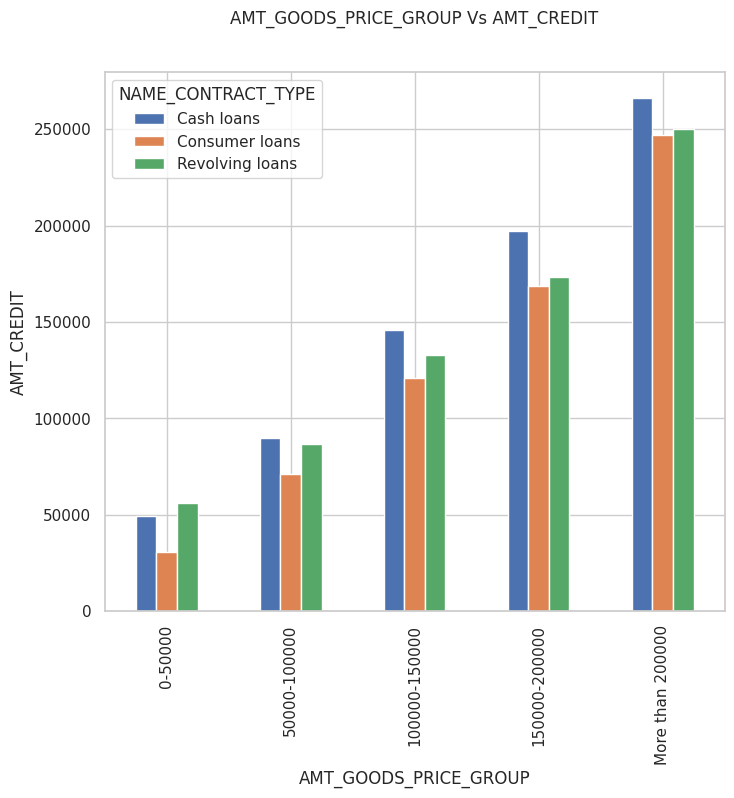

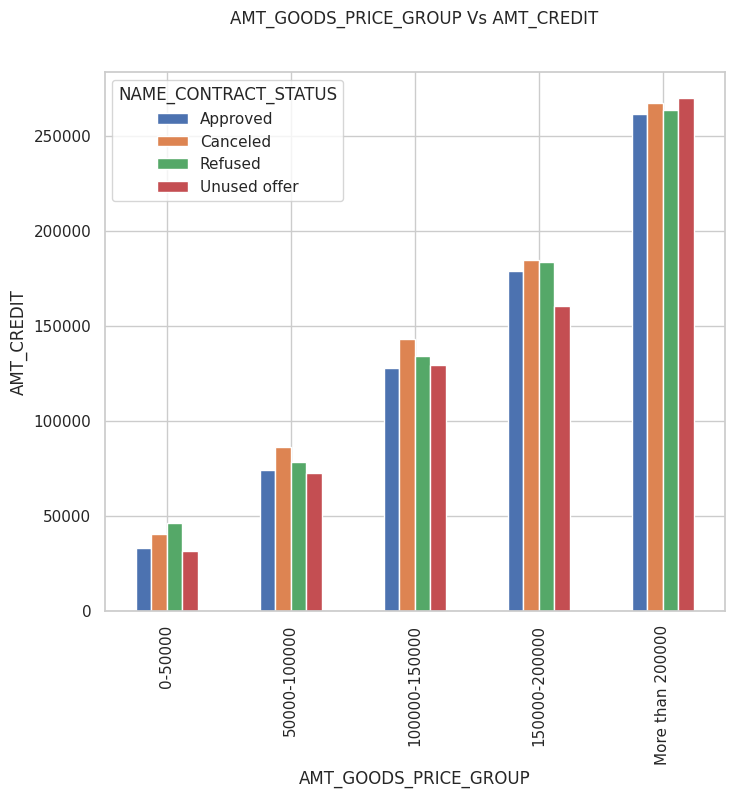

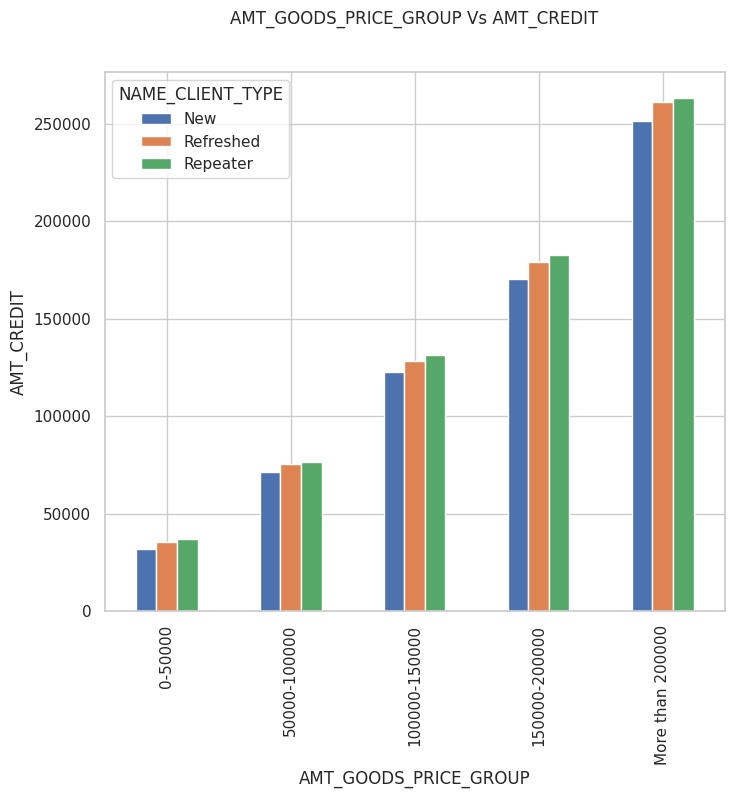

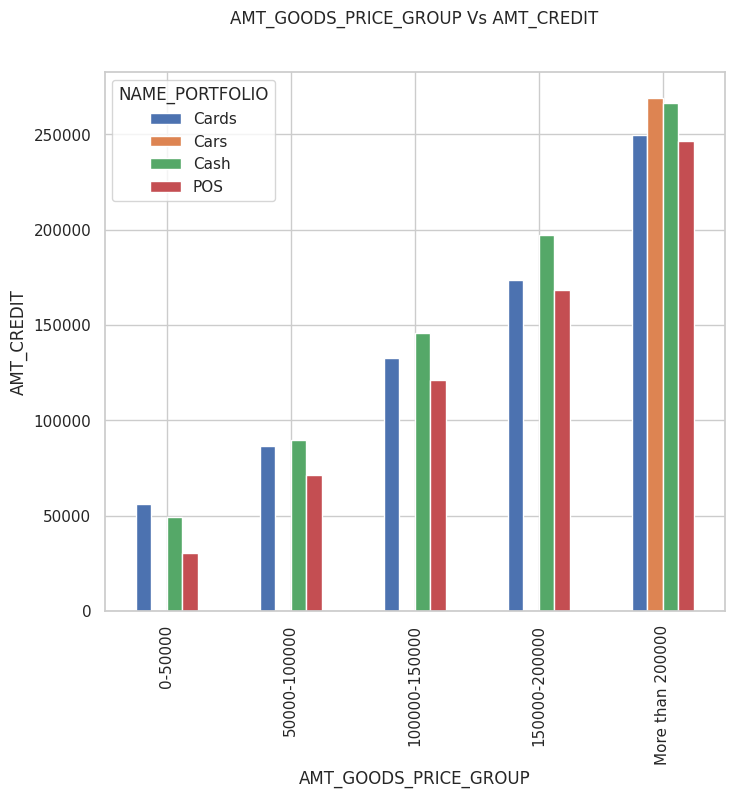

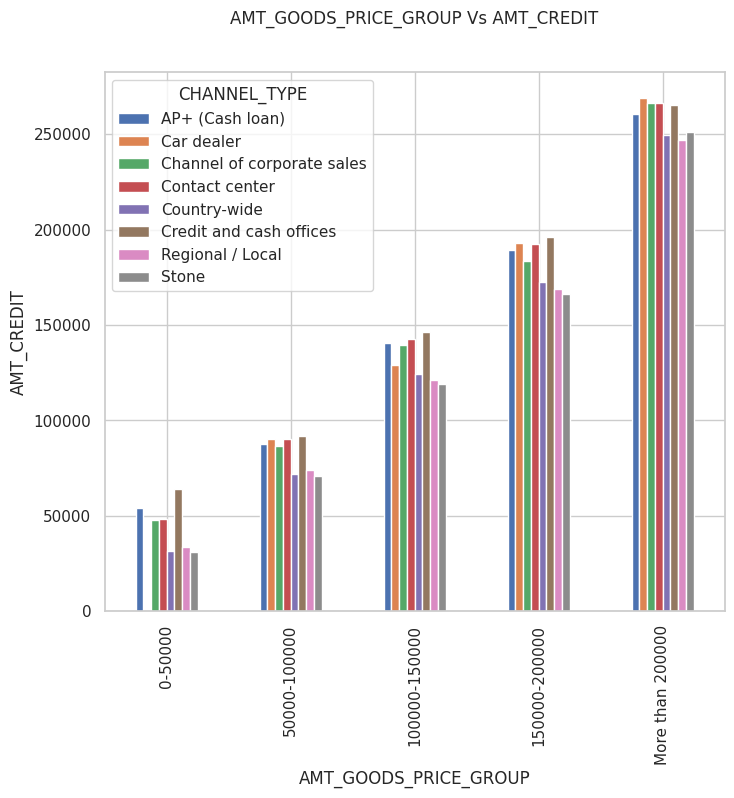

In [238]:
# cols= ['CNT_PAYMENT_GROUP','AMT_CREDIT_GROUP', 'AMT_ANNUITY_GROUP', 'AMT_GOODS_PRICE_GROUP',]
# CNT_PAYMENT: "Term of previous credit at application of the previous application" refers to the length of time that a previous loan or credit agreement was taken for, measured in some unit of time (like days, months, or years)
#  AMT_ANNUITY The "annuity of previous application" is the fixed amount of money that someone had to pay regularly to repay a loan or credit they took out in a previous instance.
for col in object_columns_pre_app_df:
  pre_app_df.pivot_table(values='AMT_CREDIT',index="AMT_GOODS_PRICE_GROUP",columns=col,aggfunc='mean').plot.bar(figsize=(8,7))
  plt.xlabel("AMT_GOODS_PRICE_GROUP")
  plt.ylabel('AMT_CREDIT')
  plt.title('AMT_GOODS_PRICE_GROUP'+' Vs AMT_CREDIT')
  plt.show()
  print("\n" + "="*170 + "\n")



***Notable Point***

In the bar graphs comparing "AMT_CREDIT" and "AMT_GOODS_PRICE_GROUP" across different categorical columns, a consistent trend is observed: as you move towards the right side of the graphs, there is a noticeable increase in the values represented by the bars.

#### ***Scatter plot: Between Numerical Type Columns Across Object Type Column(Bivariate analysis)***

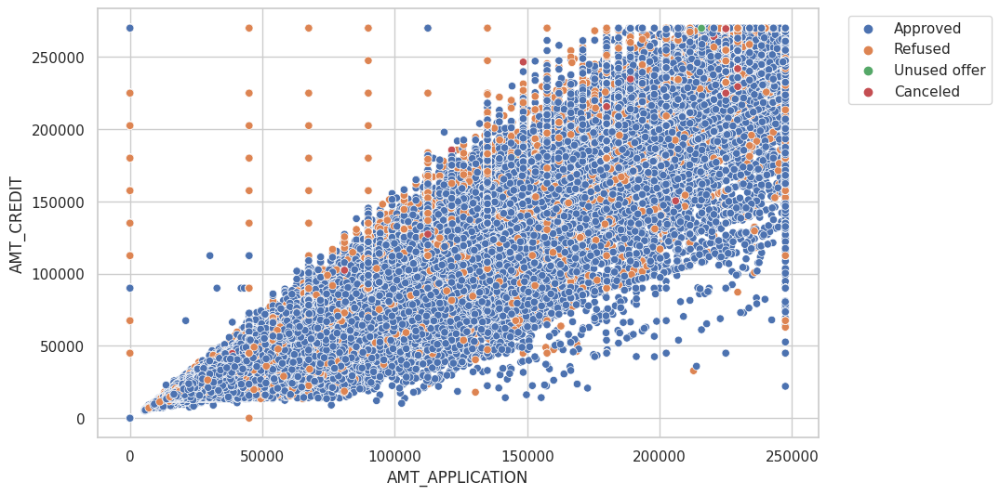

In [239]:
plt.figure(figsize=(10, 6))
ax = sns.scatterplot(x='AMT_APPLICATION', y='AMT_CREDIT', hue='NAME_CONTRACT_STATUS', data=pre_app_df)
# Move the legend outside the plot for better visibility
ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1))
plt.show()

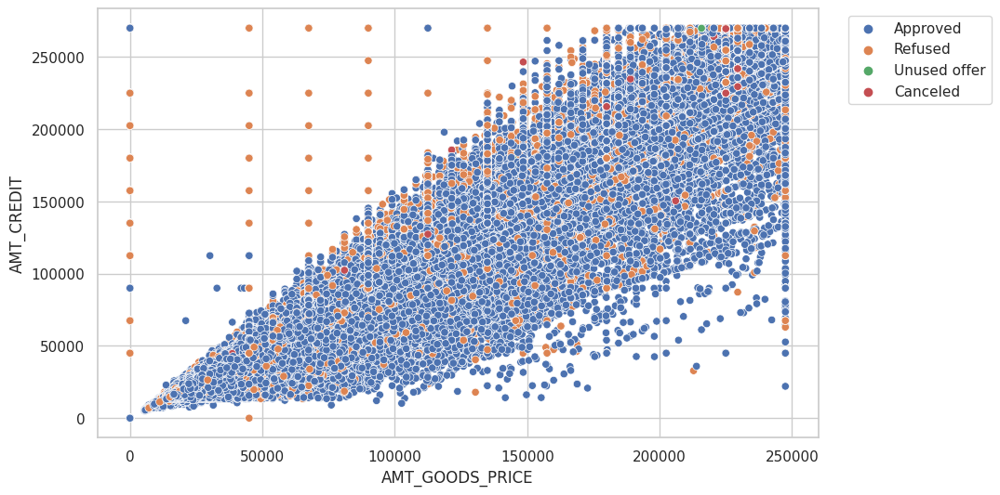

In [240]:
plt.figure(figsize=(10, 6))
ax = sns.scatterplot(x='AMT_GOODS_PRICE', y='AMT_CREDIT', hue='NAME_CONTRACT_STATUS', data=pre_app_df)
# Move the legend outside the plot for better visibility
ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1))
plt.show()

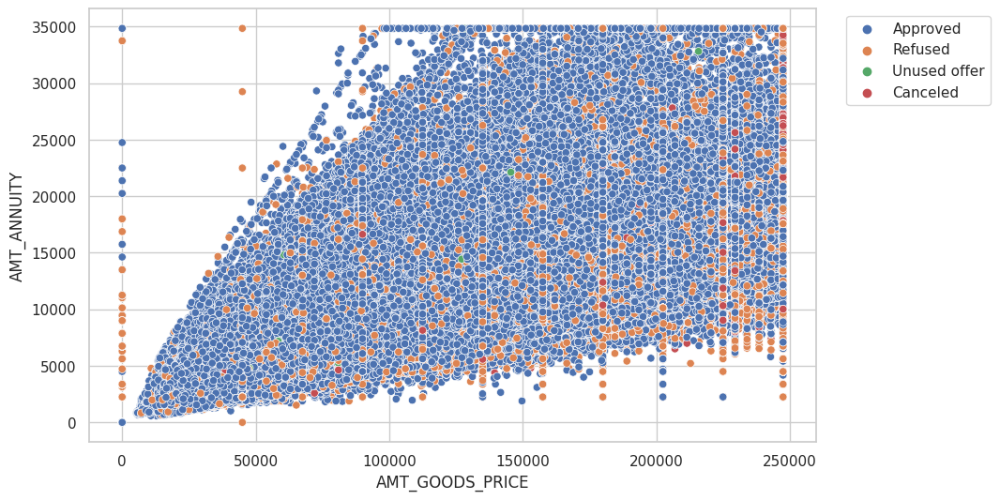

In [241]:
plt.figure(figsize=(10, 6))
ax = sns.scatterplot(x='AMT_GOODS_PRICE', y='AMT_ANNUITY', hue='NAME_CONTRACT_STATUS', data=pre_app_df)
# Move the legend outside the plot for better visibility
ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1))
plt.show()

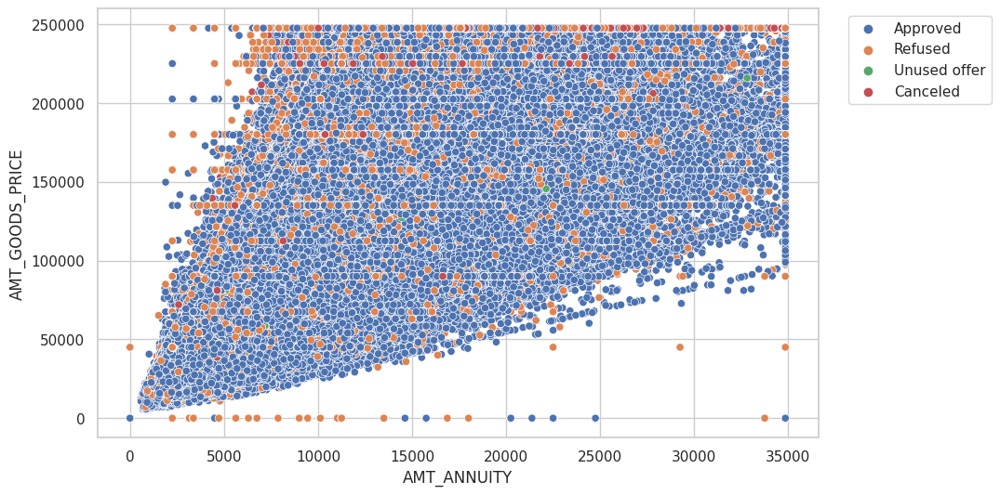

In [242]:
plt.figure(figsize=(10, 6))
ax = sns.scatterplot(x='AMT_ANNUITY', y='AMT_GOODS_PRICE', hue='NAME_CONTRACT_STATUS', data=pre_app_df)
# Move the legend outside the plot for better visibility
ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1))
plt.show()

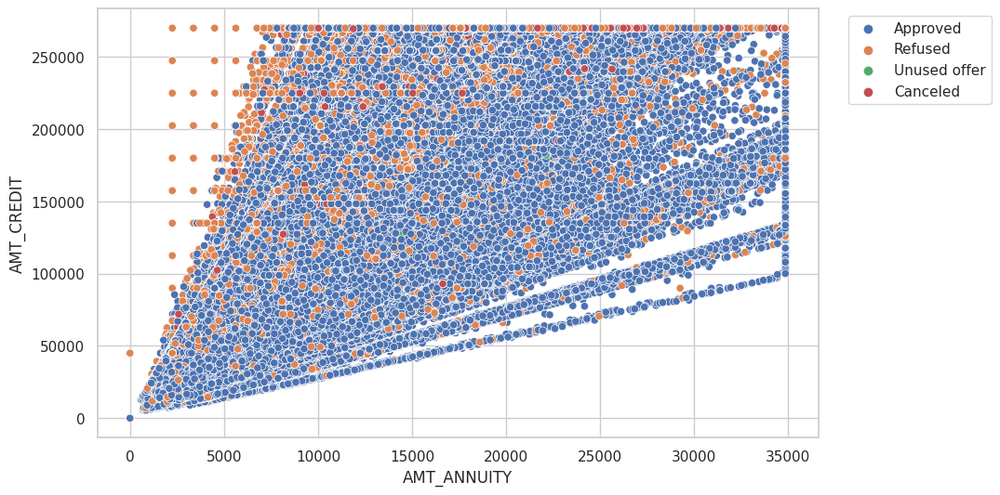

In [243]:
plt.figure(figsize=(10, 6))
ax = sns.scatterplot(x='AMT_ANNUITY', y='AMT_CREDIT', hue='NAME_CONTRACT_STATUS', data=pre_app_df)
# Move the legend outside the plot for better visibility
ax.legend(loc='upper right', bbox_to_anchor=(1.25, 1))
plt.show()

***Notable Point***

All scatter plots of numerical fields exhibit a linear relationship, it suggests that there is a consistent pattern of correlation or association between the variables being compared across NAME_CONTRACT_STATUS field.In all scatter plots, a significant proportion of the data points correspond to approved loans.

In [244]:
pre_app_df.columns

Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
       'NAME_CONTRACT_STATUS', 'DAYS_DECISION', 'NAME_CLIENT_TYPE',
       'NAME_PORTFOLIO', 'CHANNEL_TYPE', 'CNT_PAYMENT', 'AMT_ANNUITY_GROUP',
       'AMT_APPLICATION_GROUP', 'AMT_CREDIT_GROUP', 'AMT_GOODS_PRICE_GROUP',
       'CNT_PAYMENT_GROUP', 'DAYS_DECISION_GROUP'],
      dtype='object')

####***Count Graph Between Numerical values across different categorical values***

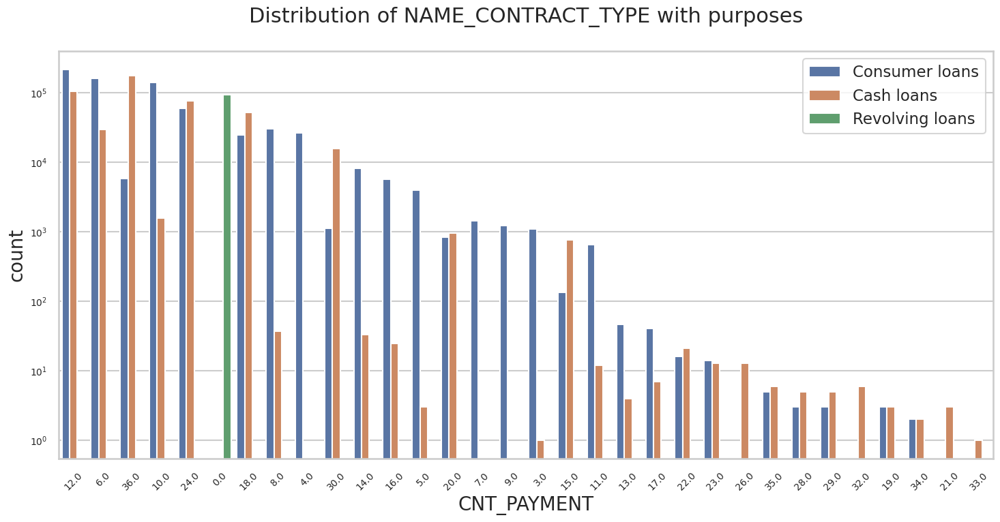

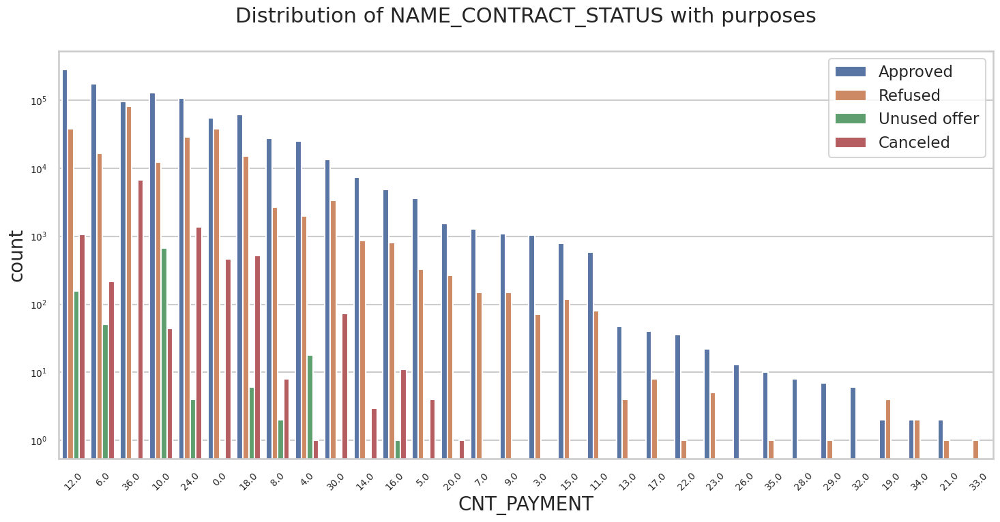

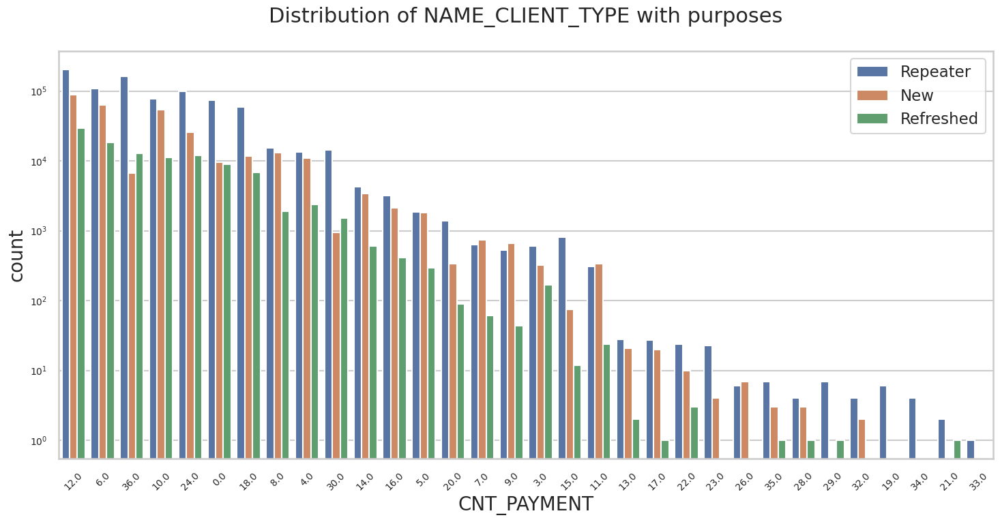

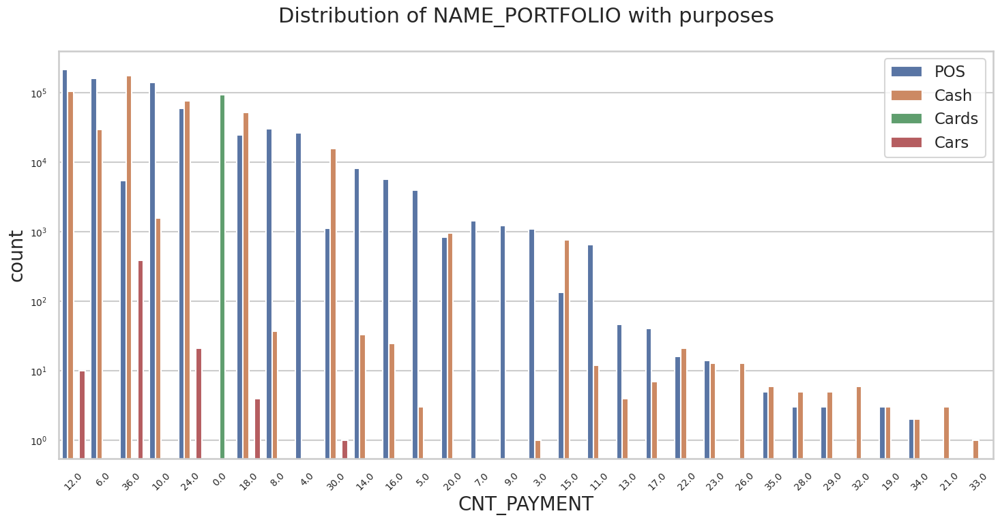

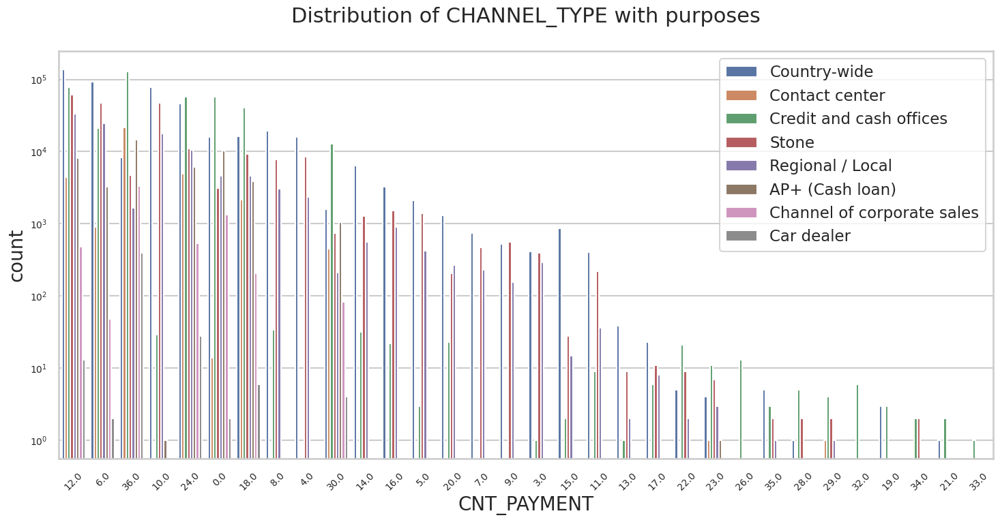

In [245]:
for col_for_obj in object_columns_pre_app_df:
  # Distribution of contract status in logarithmic scale
  sns.set_style('whitegrid')
  sns.set_context('talk')

  plt.figure(figsize=(15, 8))
  plt.rcParams["axes.labelsize"] = 20
  plt.rcParams['axes.titlesize'] = 22
  plt.rcParams['axes.titlepad'] = 30

  # Rotate x-axis labels for better readability
  plt.xticks(rotation=45)

  # Set the y-axis scale to logarithmic
  plt.yscale('log')
  plt.xticks(fontsize=10)  # Adjust fontsize as needed
  plt.yticks(fontsize=10)
  plt.title('Distribution of '+col_for_obj+' with purposes')
  ax = sns.countplot(data=pre_app_df, x='CNT_PAYMENT',
                    order=pre_app_df['CNT_PAYMENT'].value_counts().index, hue=col_for_obj)

  # Move the legend outside the plot for better visibility
  ax.legend(loc='upper right', bbox_to_anchor=(1, 1))

  plt.tight_layout()
  plt.show()

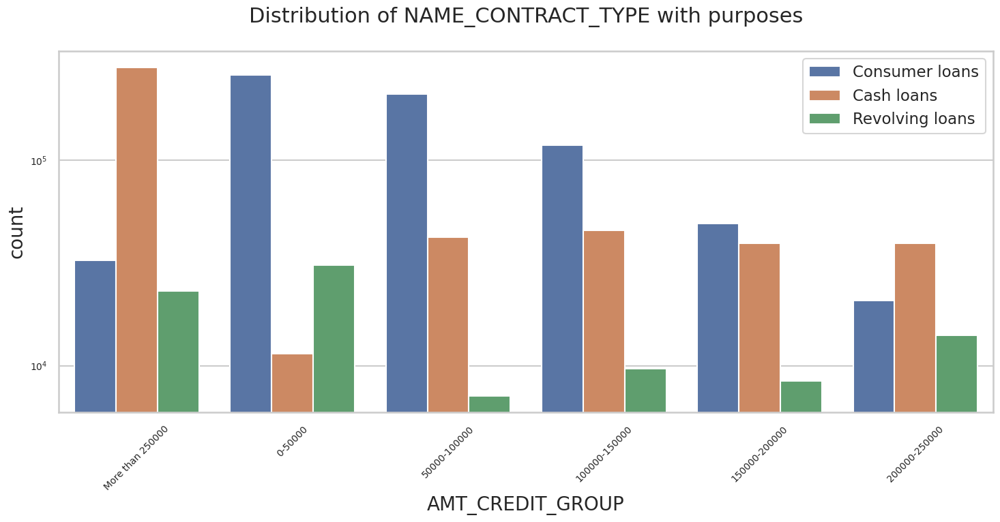

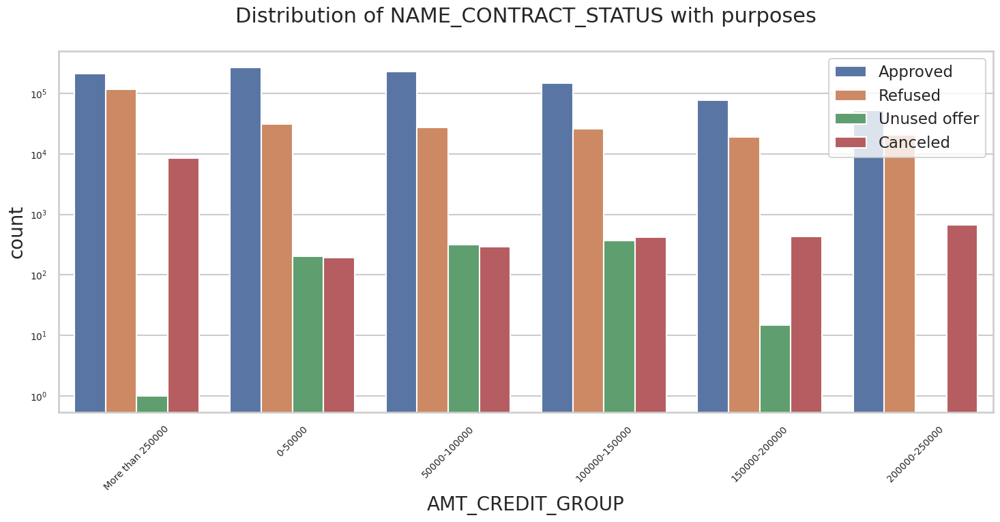

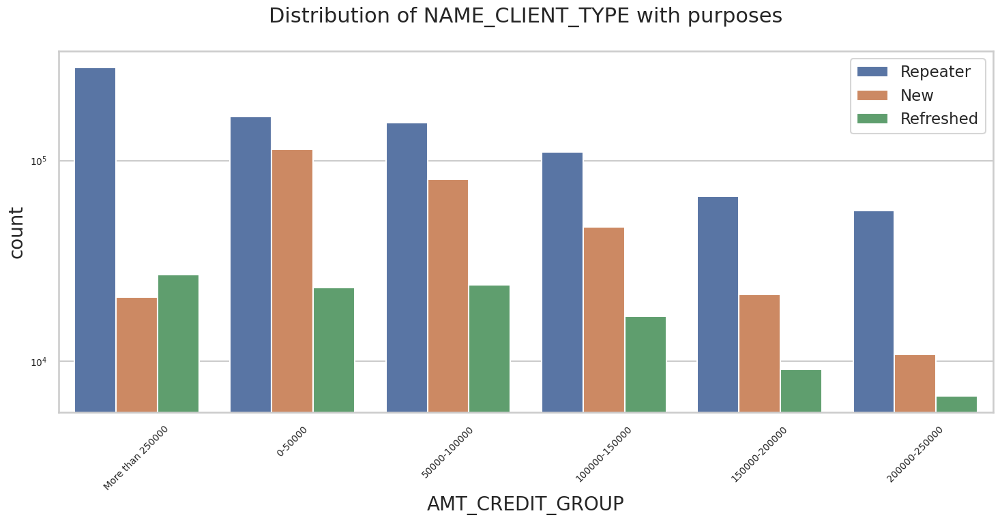

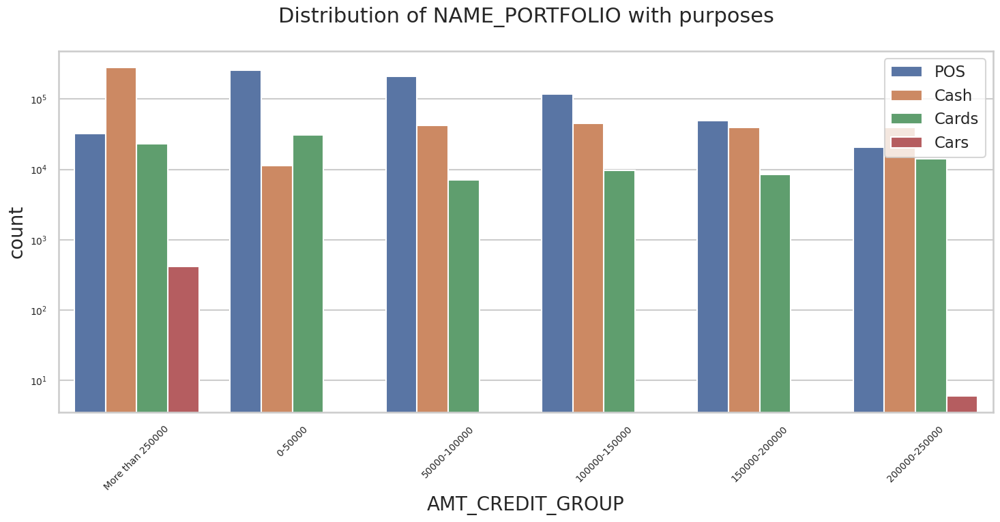

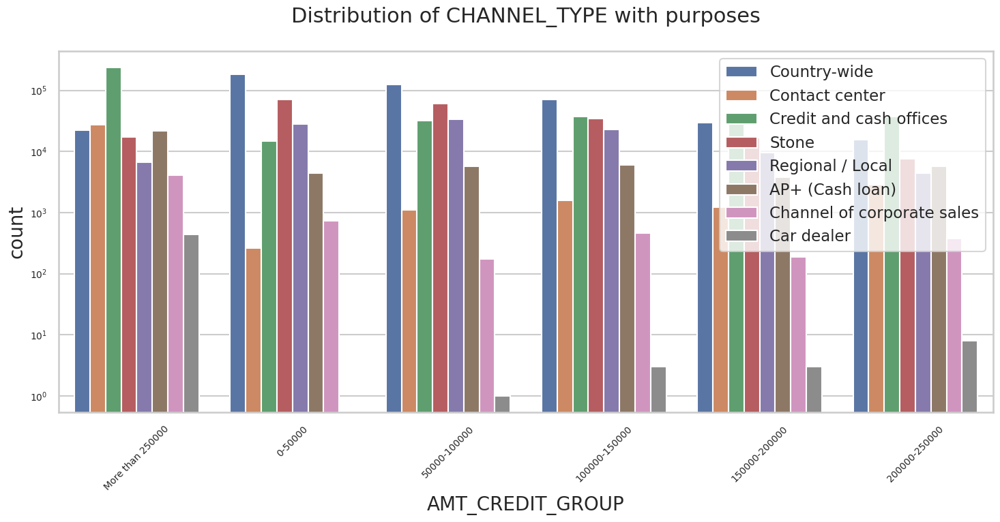

In [246]:
for col_for_obj in object_columns_pre_app_df:
  # Distribution of contract status in logarithmic scale
  sns.set_style('whitegrid')
  sns.set_context('talk')

  plt.figure(figsize=(15, 8))  # Adjusted figure size
  plt.rcParams["axes.labelsize"] = 20
  plt.rcParams['axes.titlesize'] = 22
  plt.rcParams['axes.titlepad'] = 30

  # Rotate x-axis labels for better readability
  plt.xticks(rotation=45)  # Adjust rotation angle as needed

  # Set the y-axis scale to logarithmic
  plt.yscale('log')
  plt.xticks(fontsize=10)  # Adjust fontsize as needed
  plt.yticks(fontsize=10)  # Adjust fontsize as needed
  plt.title('Distribution of '+col_for_obj+' with purposes')
  ax = sns.countplot(data=pre_app_df, x='AMT_CREDIT_GROUP',
                    order=pre_app_df['AMT_CREDIT_GROUP'].value_counts().index, hue=col_for_obj)

  # Move the legend outside the plot for better visibility
  ax.legend(loc='upper right', bbox_to_anchor=(1, 1))

  # Adjust layout
  plt.tight_layout()

  plt.show()

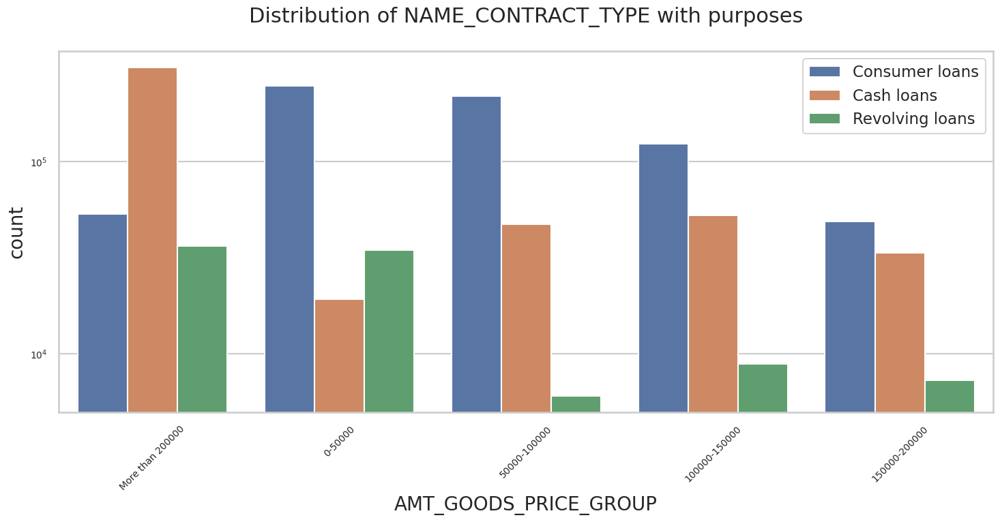

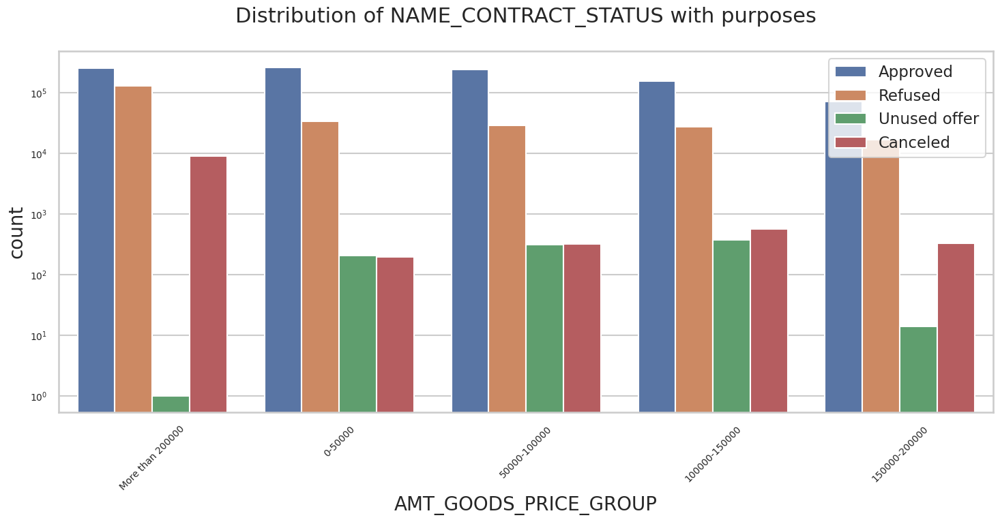

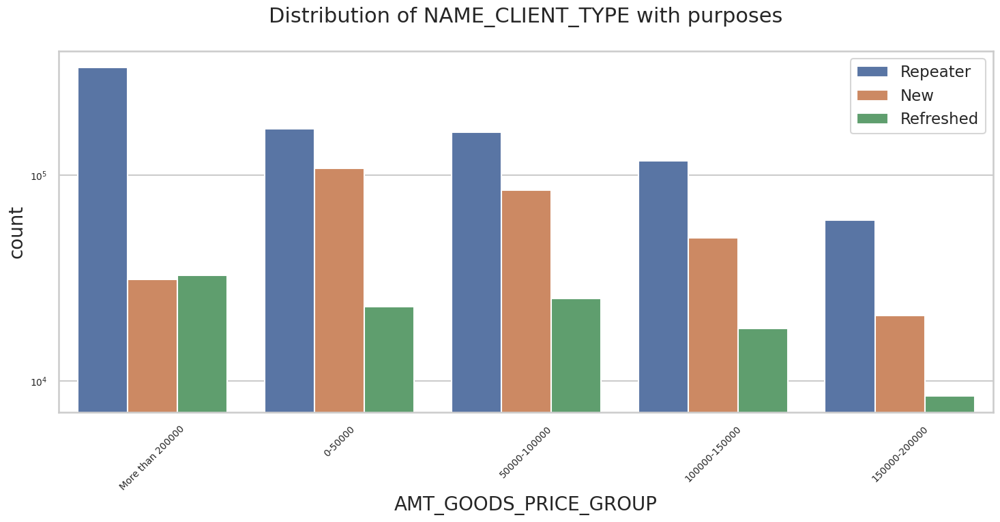

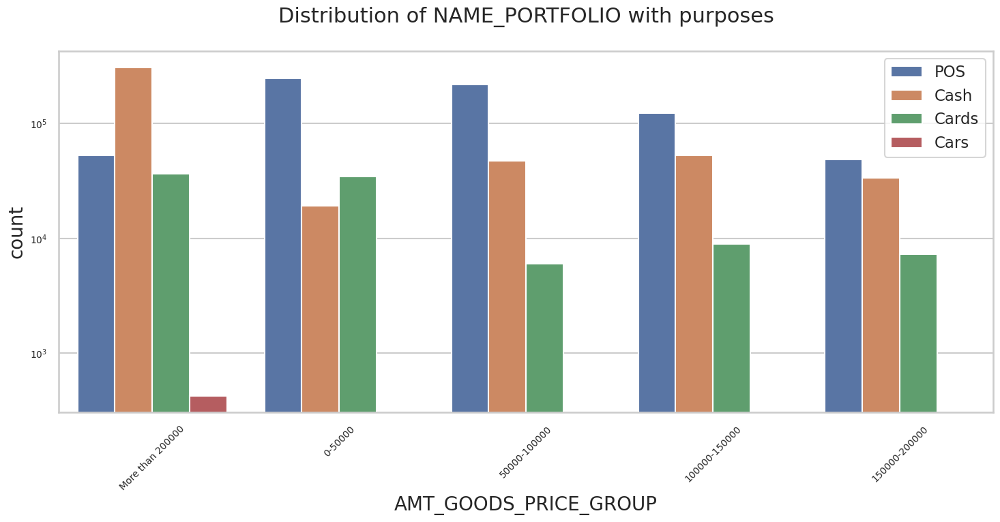

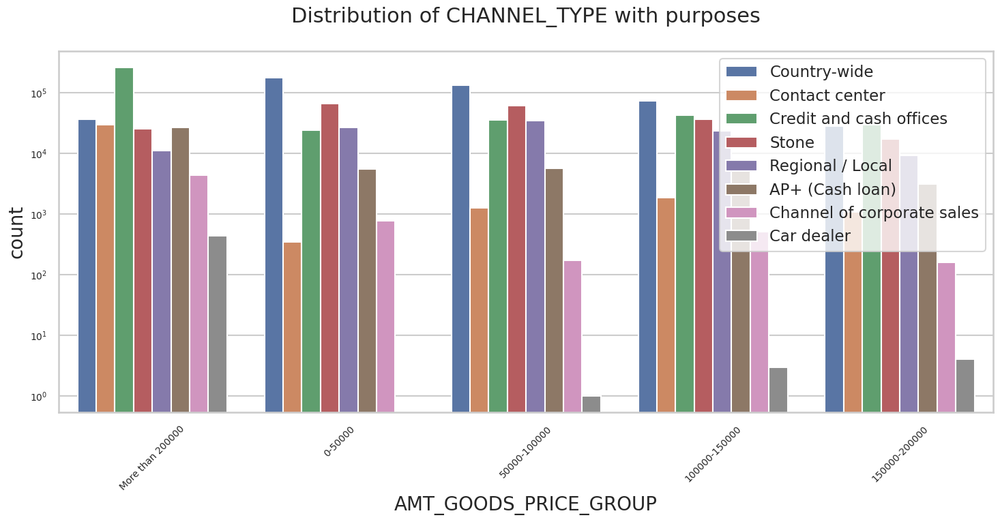

In [247]:
for col_for_obj in object_columns_pre_app_df:
  # Distribution of contract status in logarithmic scale
  sns.set_style('whitegrid')
  sns.set_context('talk')

  plt.figure(figsize=(15, 8))  # Adjusted figure size
  plt.rcParams["axes.labelsize"] = 20
  plt.rcParams['axes.titlesize'] = 22
  plt.rcParams['axes.titlepad'] = 30

  # Rotate x-axis labels for better readability
  plt.xticks(rotation=45)  # Adjust rotation angle as needed

  # Set the y-axis scale to logarithmic
  plt.yscale('log')
  plt.xticks(fontsize=10)  # Adjust fontsize as needed
  plt.yticks(fontsize=10)  # Adjust fontsize as needed
  plt.title('Distribution of '+col_for_obj+' with purposes')
  ax = sns.countplot(data=pre_app_df, x='AMT_GOODS_PRICE_GROUP',
                    order=pre_app_df['AMT_GOODS_PRICE_GROUP'].value_counts().index, hue=col_for_obj)

  # Move the legend outside the plot for better visibility
  ax.legend(loc='upper right', bbox_to_anchor=(1, 1))

  # Adjust layout
  plt.tight_layout()

  plt.show()

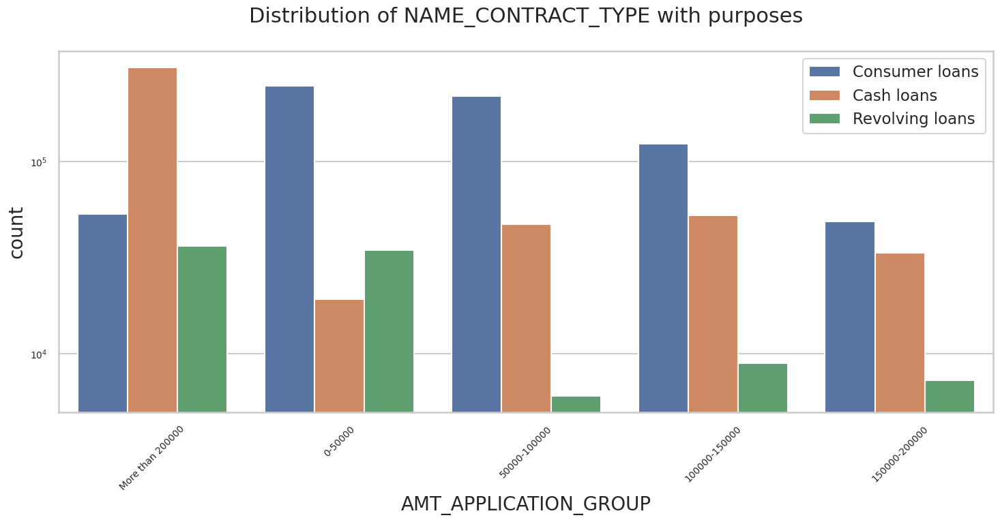

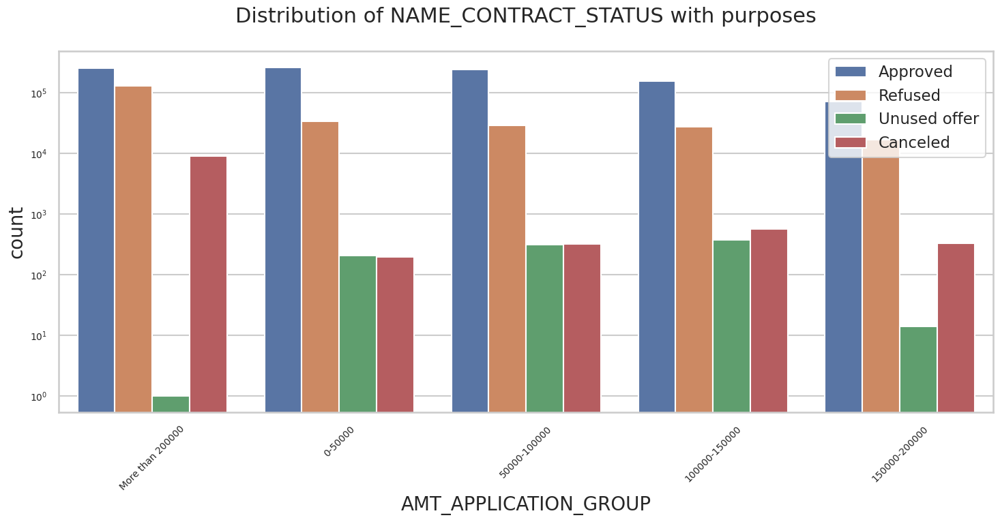

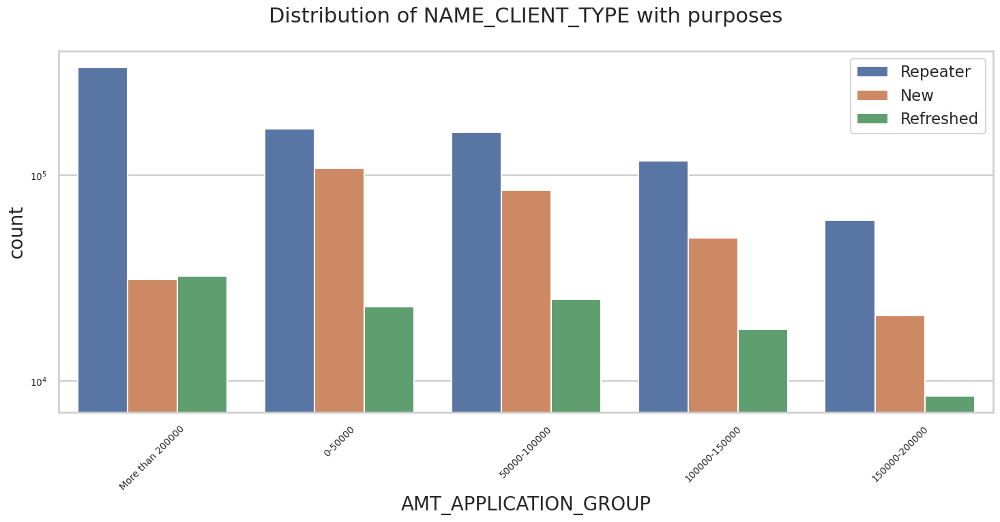

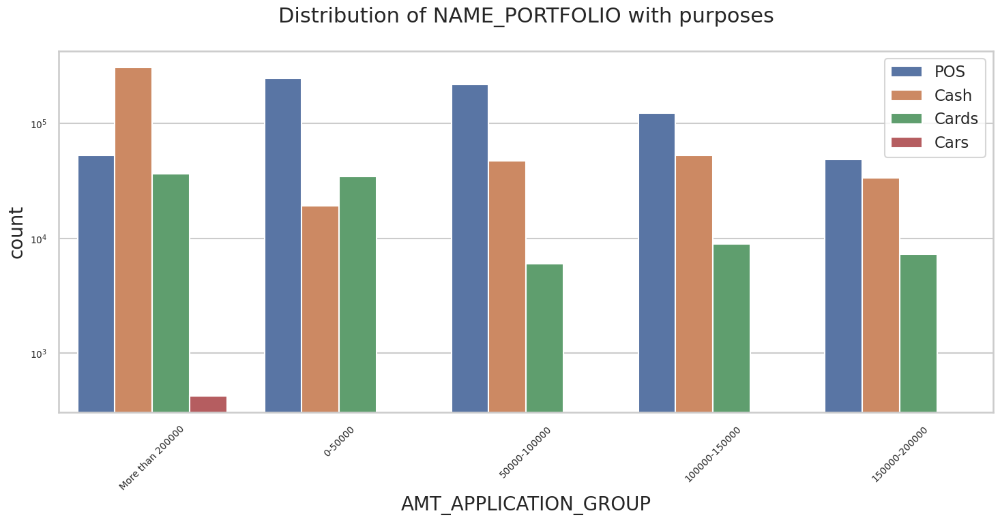

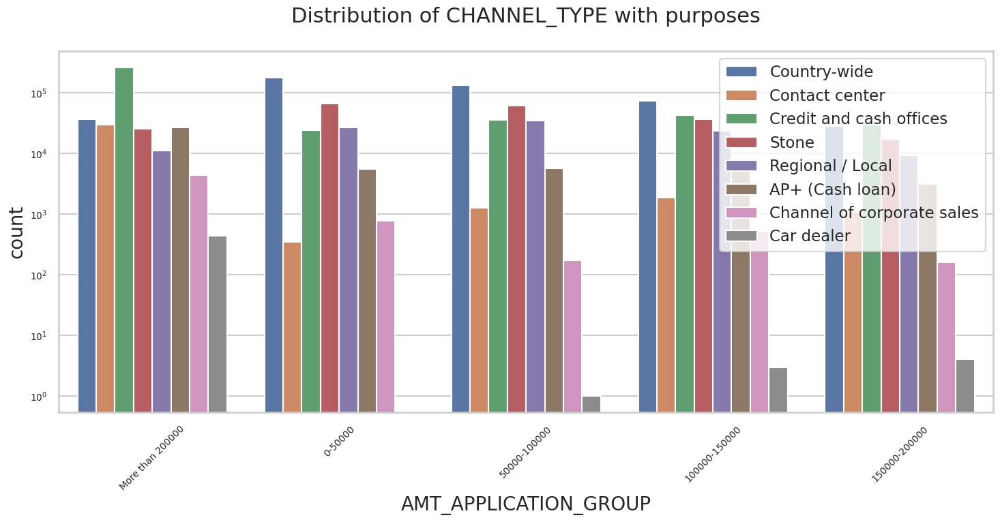

In [248]:
#AMT_APPLICATION_GROUP
for col_for_obj in object_columns_pre_app_df:
  # Distribution of contract status in logarithmic scale
  sns.set_style('whitegrid')
  sns.set_context('talk')

  plt.figure(figsize=(15, 8))  # Adjusted figure size
  plt.rcParams["axes.labelsize"] = 20
  plt.rcParams['axes.titlesize'] = 22
  plt.rcParams['axes.titlepad'] = 30

  # Rotate x-axis labels for better readability
  plt.xticks(rotation=45)  # Adjust rotation angle as needed

  # Set the y-axis scale to logarithmic
  plt.yscale('log')
  plt.xticks(fontsize=10)  # Adjust fontsize as needed
  plt.yticks(fontsize=10)  # Adjust fontsize as needed
  plt.title('Distribution of '+col_for_obj+' with purposes')
  ax = sns.countplot(data=pre_app_df, x='AMT_APPLICATION_GROUP',
                    order=pre_app_df['AMT_APPLICATION_GROUP'].value_counts().index, hue=col_for_obj)

  # Move the legend outside the plot for better visibility
  ax.legend(loc='upper right', bbox_to_anchor=(1, 1))

  # Adjust layout
  plt.tight_layout()

  plt.show()

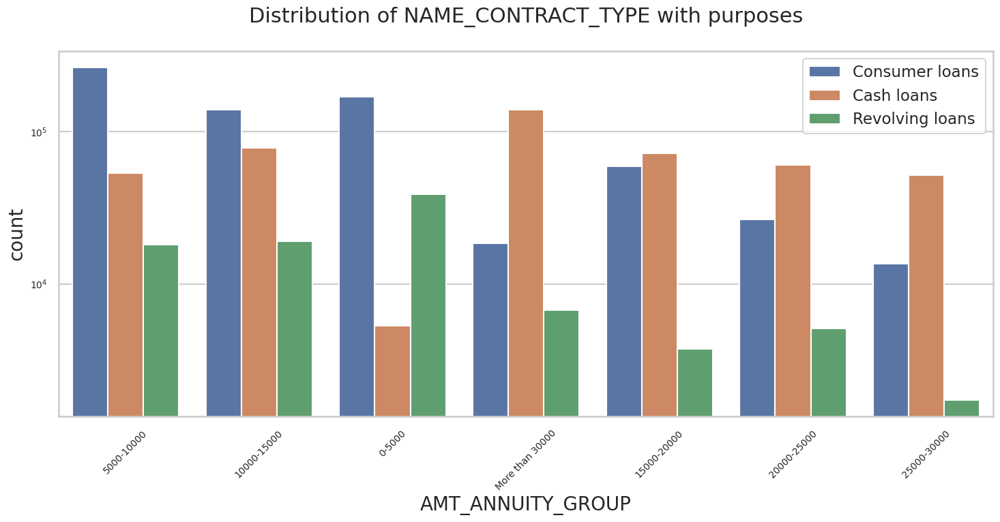

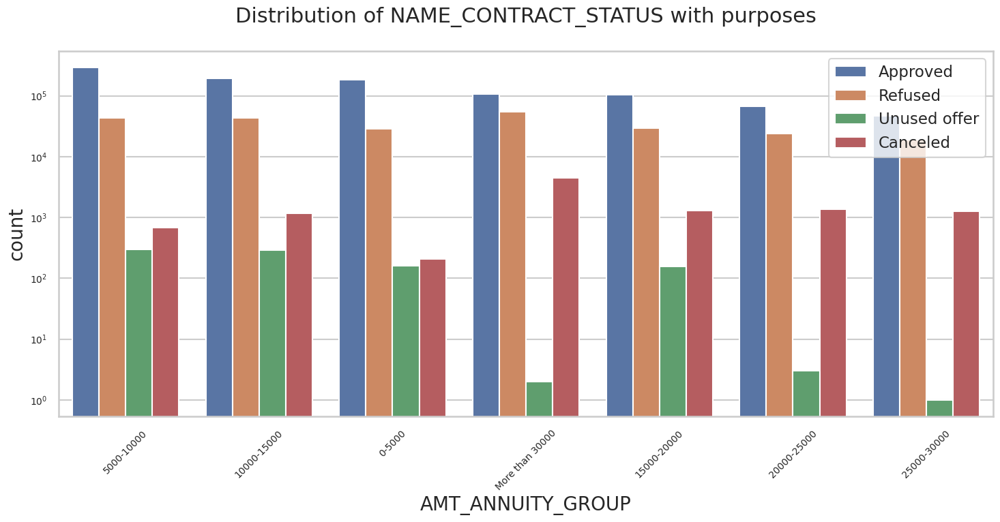

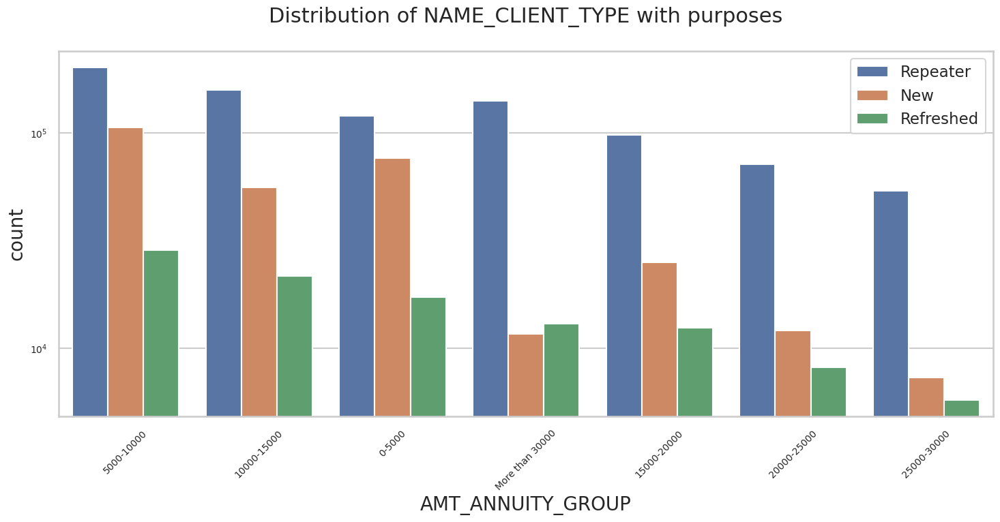

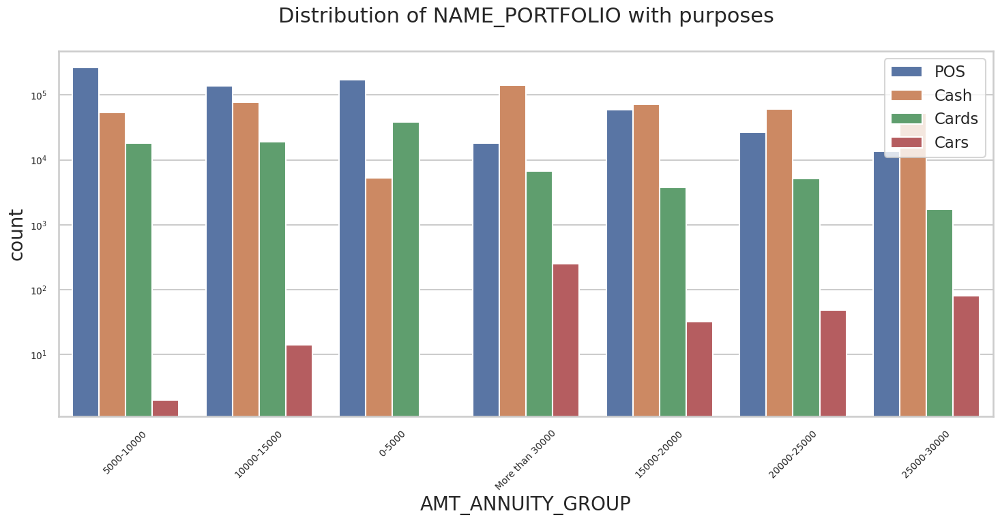

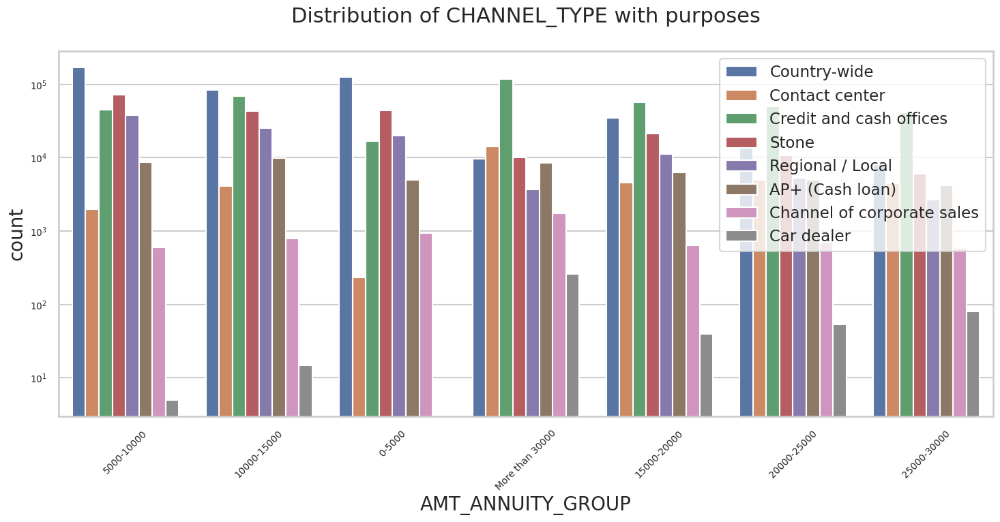

In [249]:
for col_for_obj in object_columns_pre_app_df:
  # Distribution of contract status in logarithmic scale
  sns.set_style('whitegrid')
  sns.set_context('talk')

  plt.figure(figsize=(15, 8))  # Adjusted figure size
  plt.rcParams["axes.labelsize"] = 20
  plt.rcParams['axes.titlesize'] = 22
  plt.rcParams['axes.titlepad'] = 30

  # Rotate x-axis labels for better readability
  plt.xticks(rotation=45)  # Adjust rotation angle as needed

  # Set the y-axis scale to logarithmic
  plt.yscale('log')
  plt.xticks(fontsize=10)  # Adjust fontsize as needed
  plt.yticks(fontsize=10)  # Adjust fontsize as needed
  plt.title('Distribution of '+col_for_obj+' with purposes')
  ax = sns.countplot(data=pre_app_df, x='AMT_ANNUITY_GROUP',
                    order=pre_app_df['AMT_ANNUITY_GROUP'].value_counts().index, hue=col_for_obj)

  # Move the legend outside the plot for better visibility
  ax.legend(loc='upper right', bbox_to_anchor=(1, 1))

  # Adjust layout
  plt.tight_layout()

  plt.show()

#### ***Heat MAP***

In [250]:
pre_app_df.columns


Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
       'NAME_CONTRACT_STATUS', 'DAYS_DECISION', 'NAME_CLIENT_TYPE',
       'NAME_PORTFOLIO', 'CHANNEL_TYPE', 'CNT_PAYMENT', 'AMT_ANNUITY_GROUP',
       'AMT_APPLICATION_GROUP', 'AMT_CREDIT_GROUP', 'AMT_GOODS_PRICE_GROUP',
       'CNT_PAYMENT_GROUP', 'DAYS_DECISION_GROUP'],
      dtype='object')

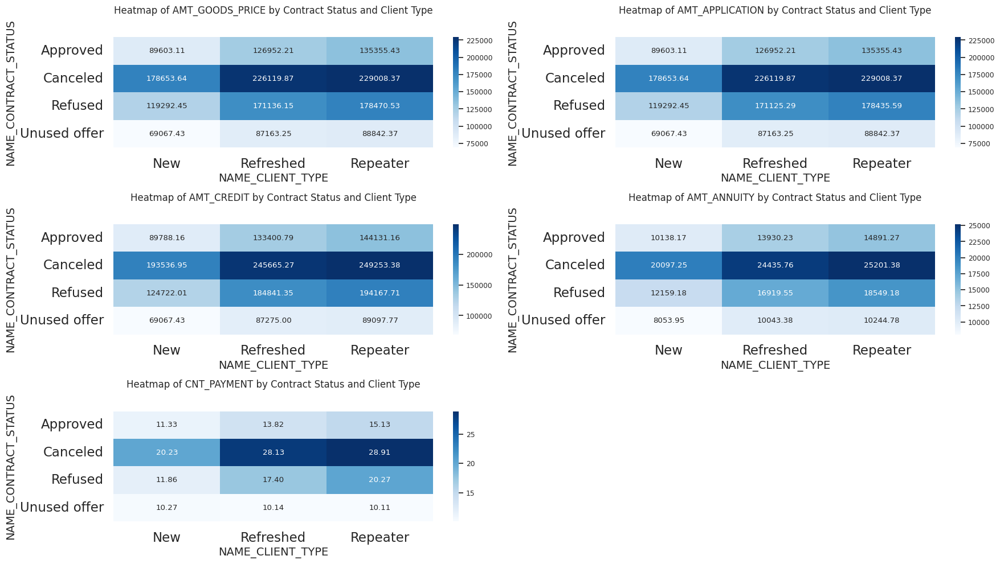

In [251]:
fin_cols = ['AMT_GOODS_PRICE', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_ANNUITY', 'CNT_PAYMENT']
fin_cols_len = len(fin_cols)

# Calculate the number of rows and columns for the subplot grid
num_cols = 2
num_rows = (fin_cols_len + num_cols - 1) // num_cols

# Create a subplot grid
fig, axes = plt.subplots(num_rows, num_cols, figsize=(18, 10))

for idx, val in enumerate(fin_cols):
    row_idx = idx // num_cols
    col_idx = idx % num_cols

    res = pd.pivot_table(data=pre_app_df, index="NAME_CONTRACT_STATUS", columns='NAME_CLIENT_TYPE', values=val)

    sns.set(font_scale=0.8)

    heatmap = sns.heatmap(res, annot=True, cmap='Blues', fmt=".2f", ax=axes[row_idx, col_idx])

    heatmap.set_xlabel(heatmap.get_xlabel(), fontsize=14)
    heatmap.set_ylabel(heatmap.get_ylabel(), fontsize=14)

    heatmap.set_title('Heatmap of ' + val + ' by Contract Status and Client Type', fontsize=12)

# Remove any empty subplots
for idx in range(len(fin_cols), num_rows * num_cols):
    fig.delaxes(axes.flatten()[idx])

plt.tight_layout()
plt.show()





***Notable Points***


* In all financial aspects such as 'AMT_GOODS_PRICE', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_ANNUITY', and 'CNT_PAYMENT,' the quantity of unused offers is exceptionally low for new client type.

* In all financial aspects such as 'AMT_GOODS_PRICE', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_ANNUITY', and 'CNT_PAYMENT,' Cancelled application amount is high for Repeater client type. The bank offers more favorable policies or interest rates for repeat applicants.



#### ***PairPlot***

<Figure size 800x400 with 0 Axes>

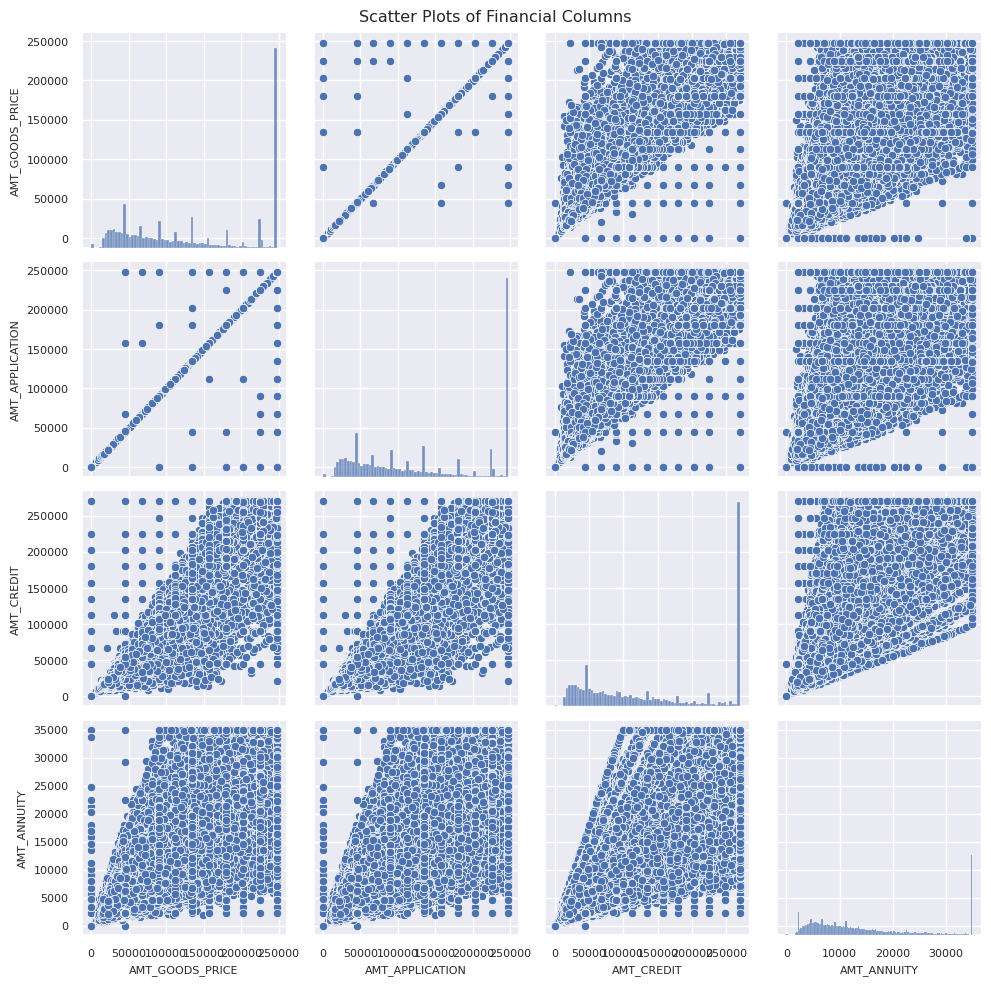

In [252]:
columns_to_plot = ['AMT_GOODS_PRICE', 'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_ANNUITY']

plt.figure(figsize=(8, 4))

pair_plot = sns.pairplot(pre_app_df[columns_to_plot])

# Loop through each subplot and adjust the font size of tick labels
for ax in pair_plot.axes.flat:
    ax.tick_params(axis='both', labelsize=8)
    ax.set_xlabel(ax.get_xlabel(), fontsize=8)
    ax.set_ylabel(ax.get_ylabel(), fontsize=8)

pair_plot.fig.suptitle('Scatter Plots of Financial Columns')

plt.tight_layout()  # Adjusts spacing between subplots

plt.show()

***Notable Points***

* It's understandable that AMT_GOODS_PRICE, AMT_ANNUITY, and AMT_APPLICATION exhibit a strong correlation. This is because when the value of a purchased item is higher, it's natural to expect a greater loan amount and, subsequently, a larger annual installment.

* Similarly, there is a notable correlation between AMT_CREDIT and AMT_GOODS_PRICE. This makes sense since the amount of credit granted is often linked to the price of the goods being financed.

In [253]:
pre_app_df.columns


Index(['SK_ID_PREV', 'SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'AMT_ANNUITY',
       'AMT_APPLICATION', 'AMT_CREDIT', 'AMT_GOODS_PRICE',
       'NAME_CONTRACT_STATUS', 'DAYS_DECISION', 'NAME_CLIENT_TYPE',
       'NAME_PORTFOLIO', 'CHANNEL_TYPE', 'CNT_PAYMENT', 'AMT_ANNUITY_GROUP',
       'AMT_APPLICATION_GROUP', 'AMT_CREDIT_GROUP', 'AMT_GOODS_PRICE_GROUP',
       'CNT_PAYMENT_GROUP', 'DAYS_DECISION_GROUP'],
      dtype='object')

In [254]:
corr_pre_app_df = pre_app_df[numberic_col_pre_app_df]
corr_pre_app_df.corr()

,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,DAYS_DECISION,CNT_PAYMENT
AMT_ANNUITY,1.000000,0.837867,0.835552,0.837966,-0.306399,0.464751
AMT_APPLICATION,0.837867,1.000000,0.984319,0.999867,-0.377921,0.615423
AMT_CREDIT,0.835552,0.984319,1.000000,0.984438,-0.390557,0.640527
AMT_GOODS_PRICE,0.837966,0.999867,0.984438,1.000000,-0.377957,0.615313
DAYS_DECISION,-0.306399,-0.377921,-0.390557,-0.377957,1.000000,-0.208990
CNT_PAYMENT,0.464751,0.615423,0.640527,0.615313,-0.208990,1.000000


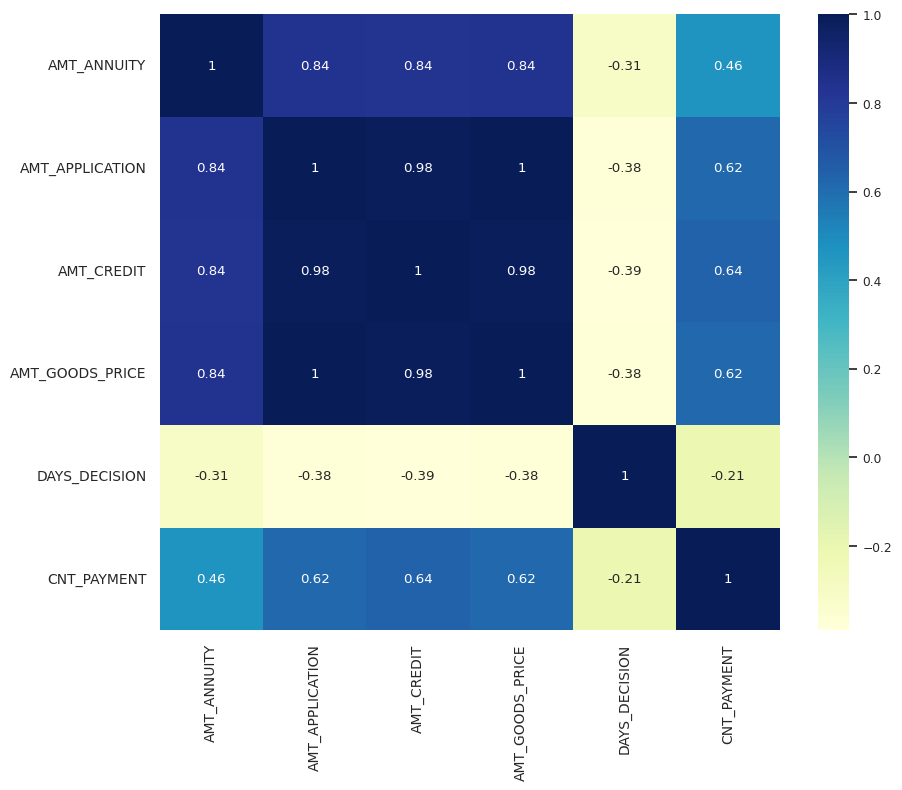

In [255]:
plt.figure(figsize=(10,8))
plot_1 = sns.heatmap(corr_pre_app_df.corr(),cmap="YlGnBu",annot=True)
plot_1.set_yticklabels(plot_1.get_yticklabels(), fontsize=10)
plot_1.set_xticklabels(plot_1.get_xticklabels(), fontsize=10)
plt.show()

According to the graph DAYS_DECISION having negative correlation ratio with other.

In [256]:
pre_app_df.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_GOODS_PRICE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_CLIENT_TYPE,NAME_PORTFOLIO,CHANNEL_TYPE,CNT_PAYMENT,AMT_ANNUITY_GROUP,AMT_APPLICATION_GROUP,AMT_CREDIT_GROUP,AMT_GOODS_PRICE_GROUP,CNT_PAYMENT_GROUP,DAYS_DECISION_GROUP
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,17145.0,Approved,3.0,Repeater,POS,Country-wide,12.0,0-5000,0-50000,0-50000,0-50000,6-12,0-10
1,2802425,108129,Cash loans,25188.615,247500.0,270000.0,247500.0,Approved,6.0,Repeater,Cash,Contact center,36.0,25000-30000,More than 200000,More than 250000,More than 200000,More than 30,0-10
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,112500.0,Approved,11.0,Repeater,Cash,Credit and cash offices,12.0,15000-20000,100000-150000,100000-150000,100000-150000,6-12,10-20
3,2819243,176158,Cash loans,34849.845,247500.0,270000.0,247500.0,Approved,18.0,Repeater,Cash,Credit and cash offices,12.0,More than 30000,More than 200000,More than 250000,More than 200000,6-12,10-20
4,1784265,202054,Cash loans,31924.395,247500.0,270000.0,247500.0,Refused,27.0,Repeater,Cash,Credit and cash offices,24.0,More than 30000,More than 200000,More than 250000,More than 200000,18-24,20-30


Change the column name from 'DAYS_DECISION' to 'MONTHS_DECISION'

In [257]:
pre_app_df.rename(columns={'DAYS_DECISION': 'MONTHS_DECISION'}, inplace=True)

In [258]:
pre_app_df.rename(columns={'DAYS_DECISION_GROUP': 'MONTHS_DECISION_GROUP'}, inplace=True)

# **Merged Both Datasets**

In [261]:
df=pd.merge( pre_app_df,app_df, how='left', on="SK_ID_CURR")
df.head()


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE_x,AMT_ANNUITY_x,AMT_APPLICATION,AMT_CREDIT_x,AMT_GOODS_PRICE_x,NAME_CONTRACT_STATUS,MONTHS_DECISION,NAME_CLIENT_TYPE,NAME_PORTFOLIO,CHANNEL_TYPE,CNT_PAYMENT,AMT_ANNUITY_GROUP_x,AMT_APPLICATION_GROUP,AMT_CREDIT_GROUP_x,AMT_GOODS_PRICE_GROUP_x,CNT_PAYMENT_GROUP,MONTHS_DECISION_GROUP,TARGET,NAME_CONTRACT_TYPE_y,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_y,AMT_ANNUITY_y,AMT_GOODS_PRICE_y,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,AGE_IN_YEARS,YEAR_EMPLOYED,YEAR_REGISTRATION,YEAR_ID_PUBLISH,AGE_IN_YEARS_GROUP,YEAR_EMPLOYED_GROUP,YEAR_REGISTRATION_GROUP,YEAR_ID_PUBLISH_GROUP,AMT_INCOME_TOTAL_GROUP,AMT_CREDIT_GROUP_y,AMT_ANNUITY_GROUP_y,AMT_GOODS_PRICE_GROUP_y
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,17145.0,Approved,3.0,Repeater,POS,Country-wide,12.0,0-5000,0-50000,0-50000,0-50000,6-12,0-10,0.0,Cash loans,F,N,Y,1.0,225000.0,533668.5,25803.0,477000.0,Unaccompanied,State servant,Incomplete higher,Married,House / apartment,0.035792,1.0,1.0,0.0,1.0,1.0,0.0,Others,3.0,1.0,1.0,TUESDAY,17.0,0.0,1.0,1.0,0.0,0.0,0.0,Military,0.683797,0.510853,39.0,19.0,23.0,11.0,30-40,18-20,20-25,10-12,180000-240000,400000-600000,20000-30000,400000-600000
1,2802425,108129,Cash loans,25188.615,247500.0,270000.0,247500.0,Approved,6.0,Repeater,Cash,Contact center,36.0,25000-30000,More than 200000,More than 250000,More than 200000,More than 30,0-10,0.0,Revolving loans,F,N,N,0.0,90000.0,135000.0,6750.0,135000.0,Family,Commercial associate,Secondary / secondary special,Civil marriage,House / apartment,0.025164,1.0,1.0,0.0,1.0,0.0,0.0,Private service staff,2.0,2.0,2.0,SUNDAY,10.0,0.0,0.0,0.0,0.0,0.0,0.0,Self-employed,0.663524,0.510853,58.0,3.0,14.0,11.0,50-60,2-4,10-15,10-12,60000-120000,0-200000,0-10000,0-200000
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,112500.0,Approved,11.0,Repeater,Cash,Credit and cash offices,12.0,15000-20000,100000-150000,100000-150000,100000-150000,6-12,10-20,0.0,Cash loans,F,N,Y,3.0,40500.0,284400.0,16456.5,225000.0,"Spouse, partner",Working,Secondary / secondary special,Married,House / apartment,0.025164,1.0,1.0,0.0,1.0,0.0,0.0,Core staff,4.0,2.0,2.0,TUESDAY,9.0,0.0,0.0,0.0,0.0,0.0,0.0,Postal,0.250565,0.510853,28.0,3.0,4.0,5.0,20-30,2-4,0-5,4-6,0-60000,200000-400000,10000-20000,200000-400000
3,2819243,176158,Cash loans,34849.845,247500.0,270000.0,247500.0,Approved,18.0,Repeater,Cash,Credit and cash offices,12.0,More than 30000,More than 200000,More than 250000,More than 200000,6-12,10-20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1784265,202054,Cash loans,31924.395,247500.0,270000.0,247500.0,Refused,27.0,Repeater,Cash,Credit and cash offices,24.0,More than 30000,More than 200000,More than 250000,More than 200000,18-24,20-30,0.0,Cash loans,F,N,N,1.0,180000.0,628069.5,34200.0,499500.0,Unaccompanied,State servant,Secondary / secondary special,Married,House / apartment,0.028663,1.0,1.0,0.0,1.0,0.0,0.0,Others,3.0,2.0,2.0,MONDAY,9.0,1.0,1.0,0.0,1.0,1.0,1.0,Security Ministries,0.560157,0.363945,27.0,6.0,11.0,7.0,20-30,4-6,10-15,6-8,120000-180000,600000-800000,30000-40000,400000-600000


In [262]:
df.shape


(1245419, 68)

In [263]:
CONTRACT_STATUS=df['NAME_CONTRACT_STATUS'].unique()
CONTRACT_STATUS

array(['Approved', 'Refused', 'Unused offer', 'Canceled'], dtype=object)

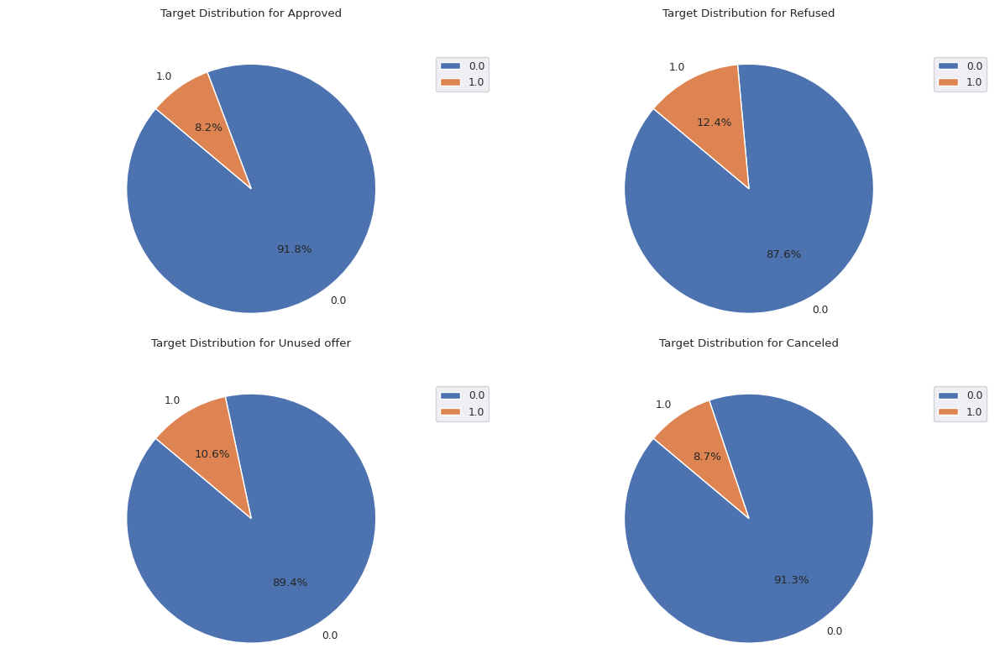

In [264]:
# Calculate the number of rows needed for subplots
num_contracts = len(CONTRACT_STATUS)
num_rows = (num_contracts + 1) // 2

# Create subplots with two pie charts per line
fig, axes = plt.subplots(num_rows, 2, figsize=(12, 4 * num_rows))

# Flatten axes for easy indexing
axes = axes.flatten()

for index, i in enumerate(CONTRACT_STATUS):

    # Filter data for the specific NAME_CONTRACT_STATUS value
    filtered_data = df[df['NAME_CONTRACT_STATUS'] == i]

    # Calculate normalized value counts
    value_counts = filtered_data['TARGET'].value_counts(normalize=True)

    # Create a pie chart in the corresponding subplot
    ax = axes[index]
    ax.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140)
    ax.set_title(f"Target Distribution for {i}")
    ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    ax.legend(value_counts.index, loc="best")

plt.tight_layout()
plt.show()

**Notable points**
* Among approved loans, 8.2% have resulted in defaults.
* It's concerning that defaults are observed in previous applications that were either refused, cancelled, or unused. This suggests that even though the financial company refused or cancelled previous applications, the current approved loans are still facing defaults.

In [265]:
# Count of Defaults in Approved Cases
approved_default_count = df[(df['NAME_CONTRACT_STATUS'] == "Approved") & (df['TARGET'] == 1)].shape[0]

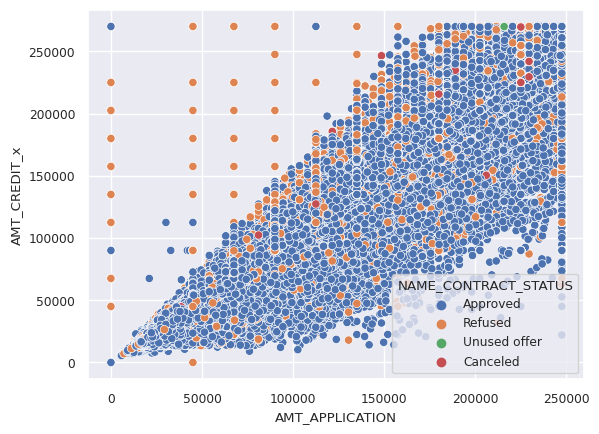

In [266]:
sns.scatterplot(x='AMT_APPLICATION',y='AMT_CREDIT_x',hue='NAME_CONTRACT_STATUS', data=df)
plt.show()

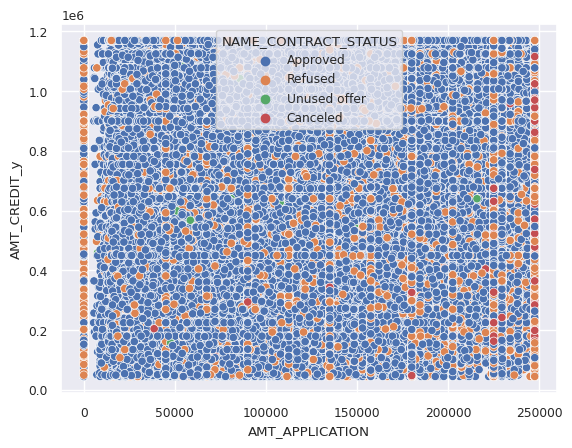

In [267]:
sns.scatterplot(x='AMT_APPLICATION',y='AMT_CREDIT_y',hue='NAME_CONTRACT_STATUS', data=df)
plt.show()

We can hardly figure out any pattern out of this.

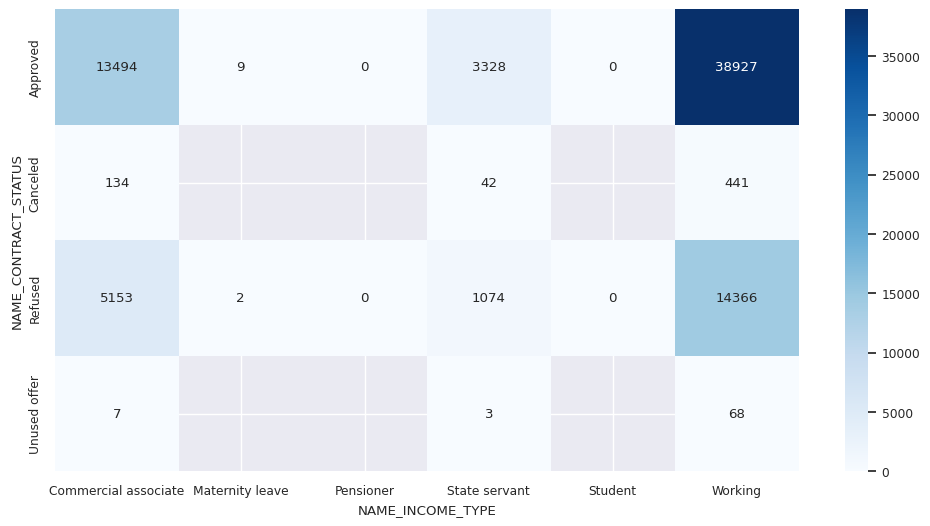

In [268]:
#Analyzing "NAME_CONTRACT_STATUS" and "NAME_INCOME_TYPE" with Target Aggregation
aggregated_data = pd.pivot_table(data=df, index="NAME_CONTRACT_STATUS", columns="NAME_INCOME_TYPE", values='TARGET', aggfunc="sum")

plt.figure(figsize=(12, 6))
sns.heatmap(aggregated_data, annot=True, cmap='Blues', fmt="g")
plt.show()

**Notable Point**

* A higher value in the upper matrix of the heatmap indicates a stronger correlation with default (Target 1).
* Among the various income types, working applicants with an approved status have the highest number of defaults.
* It's concerning that previous applications with refused, cancelled, or unused loans also show defaults. This suggests that even though the financial company rejected or cancelled previous applications, the current approved loans are facing defaults.
* Out of the working class applicants, 14,366 individuals who were previously refused have now defaulted on their loans.

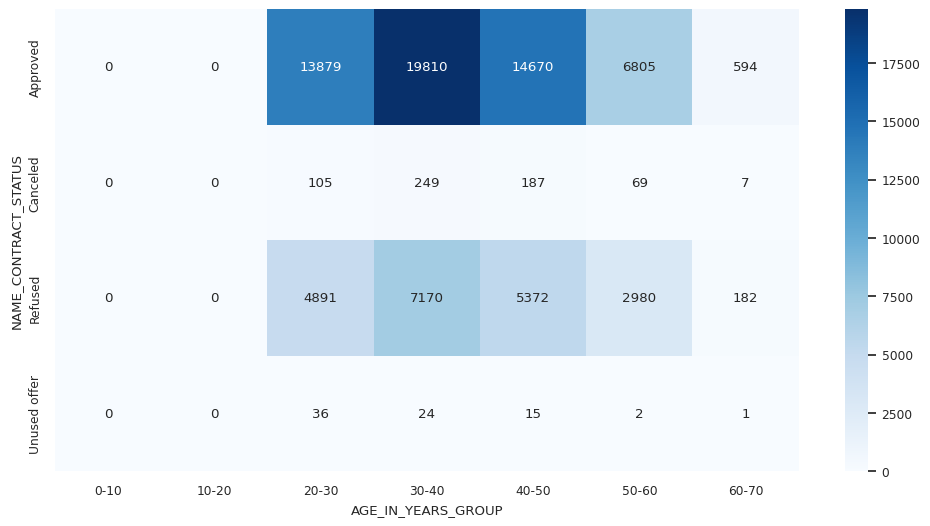

In [269]:

#Analyzing "NAME_CONTRACT_STATUS" and "AGE_IN_YEARS_GROUP" with Target Aggregation
aggregated_data = pd.pivot_table(data=df, index="NAME_CONTRACT_STATUS", columns="AGE_IN_YEARS_GROUP", values='TARGET', aggfunc="sum")

plt.figure(figsize=(12, 6))
sns.heatmap(aggregated_data, annot=True, cmap='Blues', fmt="g")
plt.show()

**Notable points**
* In the above matrix, a higher value indicates a stronger correlation with default (Target 1) since it represents defaulters.
* The age group 30-40 has the highest number of defaulters among approved loans, followed by age groups 20-30 and 40-50, which also show significant default rates.
* Previous applications with refused and cancelled loans are correlated with defaults in the current applications.

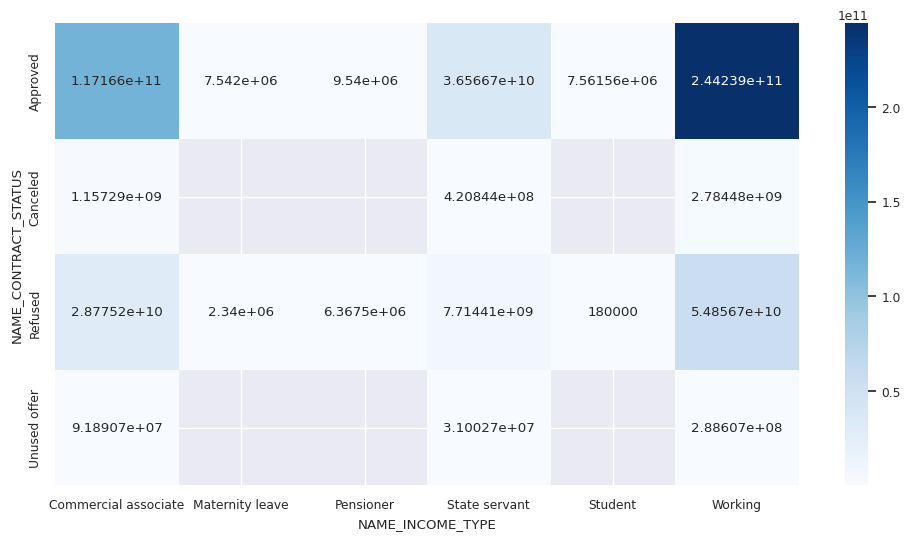

In [270]:

#Analyzing "NAME_CONTRACT_STATUS" and "NAME_INCOME_TYPE" with AMT_CREDIT_y Aggregation
aggregated_data = pd.pivot_table(data=df, index="NAME_CONTRACT_STATUS", columns="NAME_INCOME_TYPE", values='AMT_CREDIT_y', aggfunc="sum")

plt.figure(figsize=(12, 6))
sns.heatmap(aggregated_data, annot=True, cmap='Blues', fmt="g")
plt.show()

**Notable points**
* A significant observation is the higher credit offerings to individuals in the working and commercial associate categories.
* Refused applicants, especially students, tend to receive smaller credit amounts.

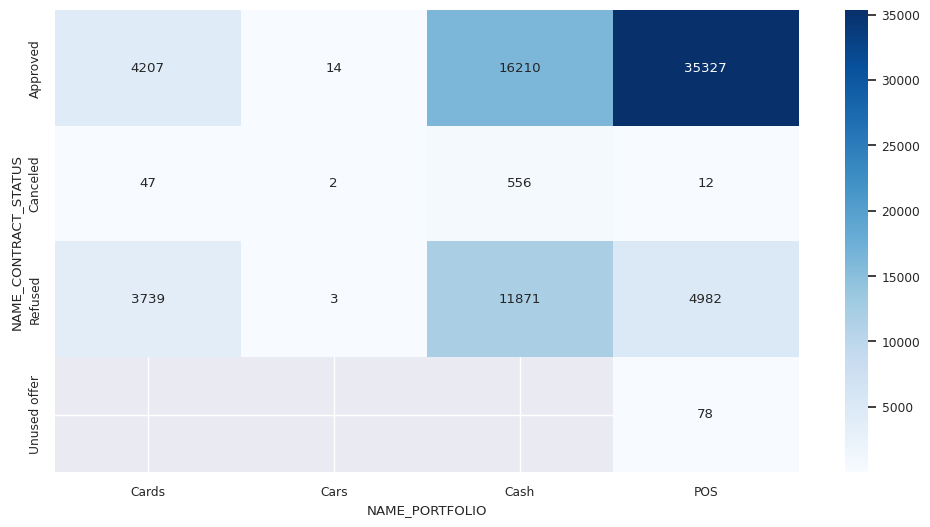

In [271]:

# Create a pivot table for AMT_CREDIT_y and plot a heatmap
pivot_table = pd.pivot_table(data=df, index="NAME_CONTRACT_STATUS", columns="NAME_PORTFOLIO", values='TARGET', aggfunc="sum")
plt.figure(figsize=(12, 6))
sns.heatmap(pivot_table, annot=True, cmap='Blues', fmt="g")
plt.show()

**Notable points**


* Among approved loans, the POS associate category exhibits the highest count of defaulters.
* Approved loans in the car portfolio show only 14 instances of default.

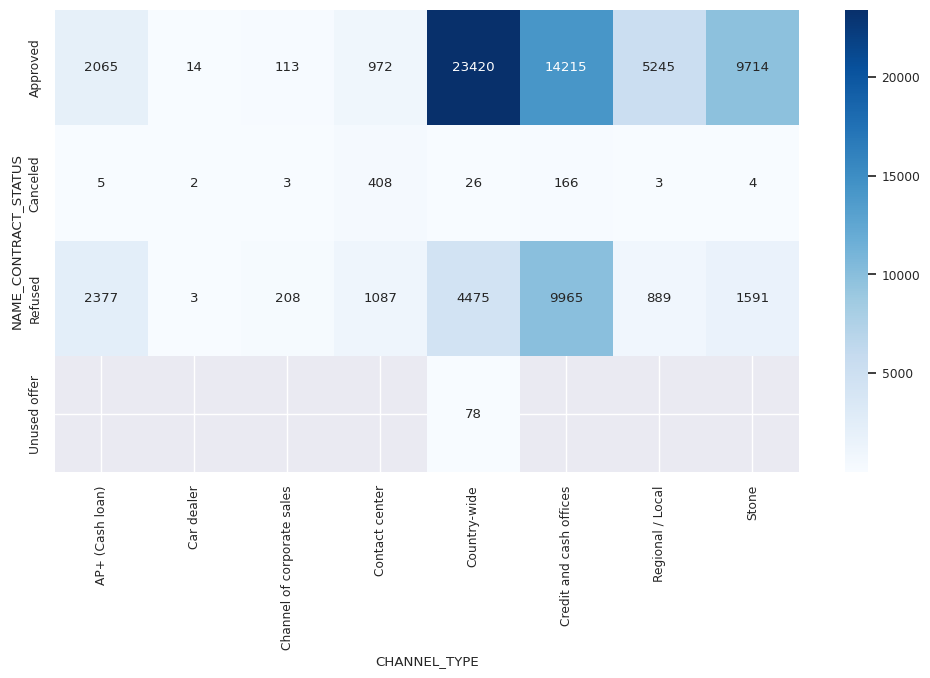

In [272]:
# Create a pivot table for TARGET and plot a heatmap
pivot_table = pd.pivot_table(data=df, index="NAME_CONTRACT_STATUS", columns="CHANNEL_TYPE", values='TARGET', aggfunc="sum")
plt.figure(figsize=(12, 6))
sns.heatmap(pivot_table, annot=True, cmap='Blues', fmt="g")
plt.show()

**Notable points**

* Among the approved loans, the country-wide associate category has the highest number of default cases.
* In the car dealer category of approved loans, there are only 14 instances of defaults.

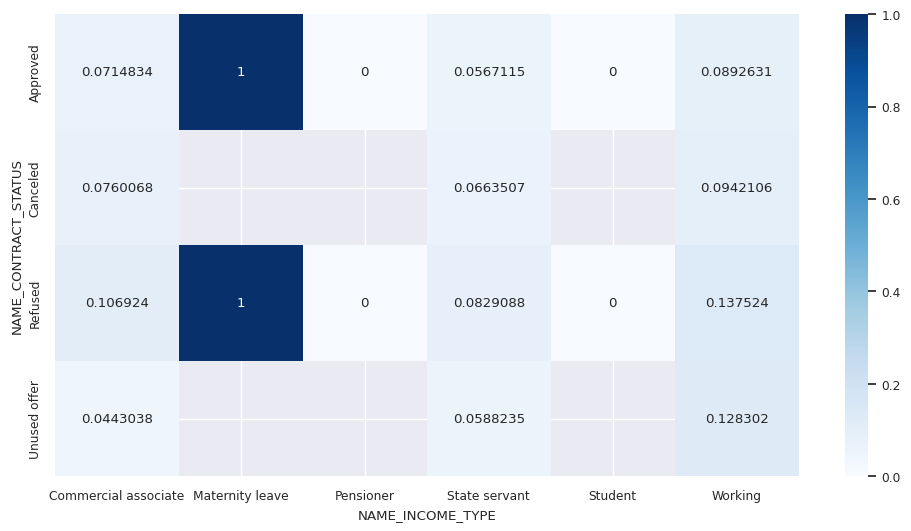

In [273]:
# Create a pivot table for TARGET and plot a heatmap
pivot_table = pd.pivot_table(data=df, index="NAME_CONTRACT_STATUS", columns="NAME_INCOME_TYPE", values='TARGET')
plt.figure(figsize=(12, 6))
sns.heatmap(pivot_table, annot=True, cmap='Blues', fmt="g")
plt.show()

**Notable points**

* When considering both approved and refused loans, the Maternity leave associate category stands out with the highest count of default cases.

* No instances of defaults are observed in the pensioner and student categories for both approved and refused loans.

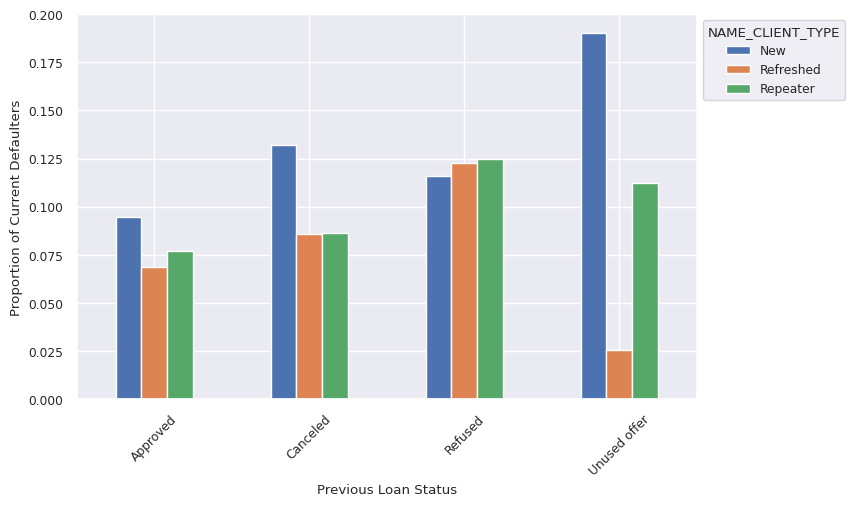

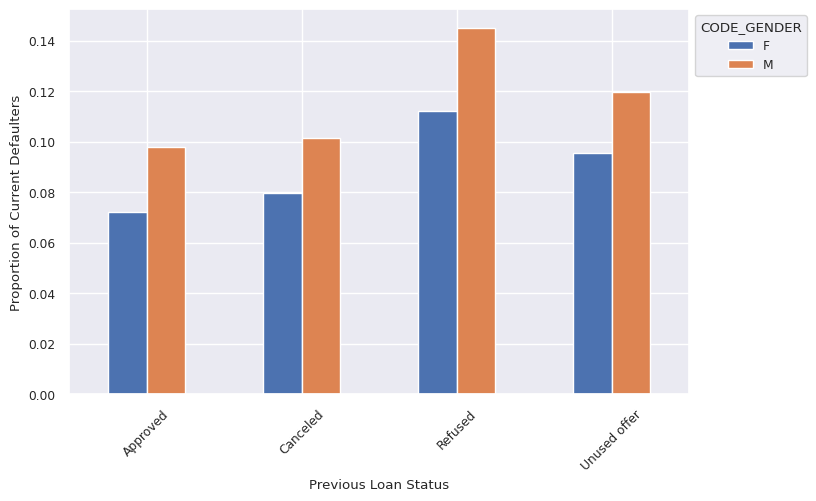

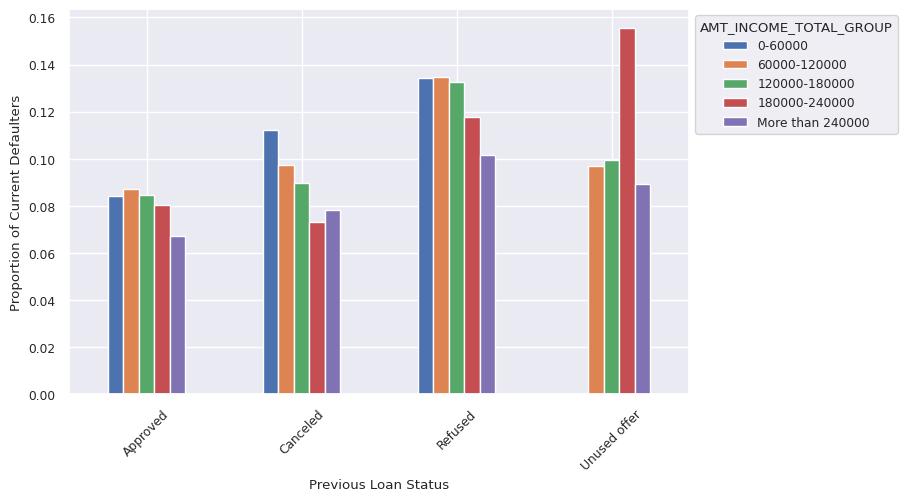

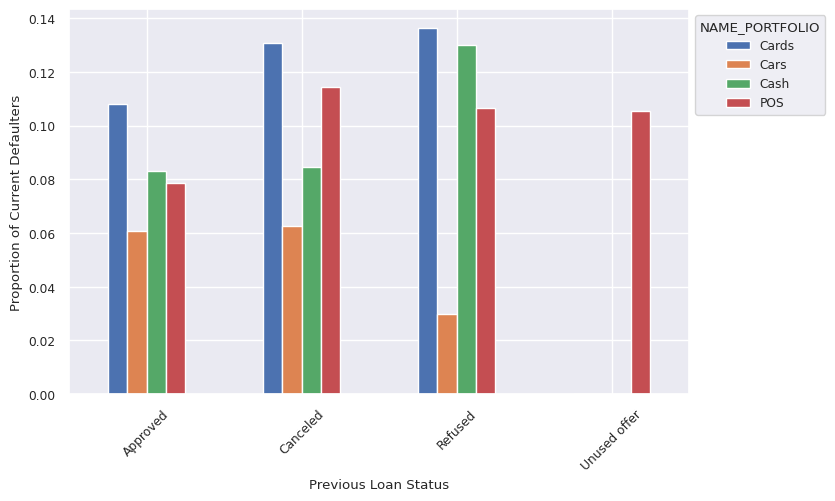

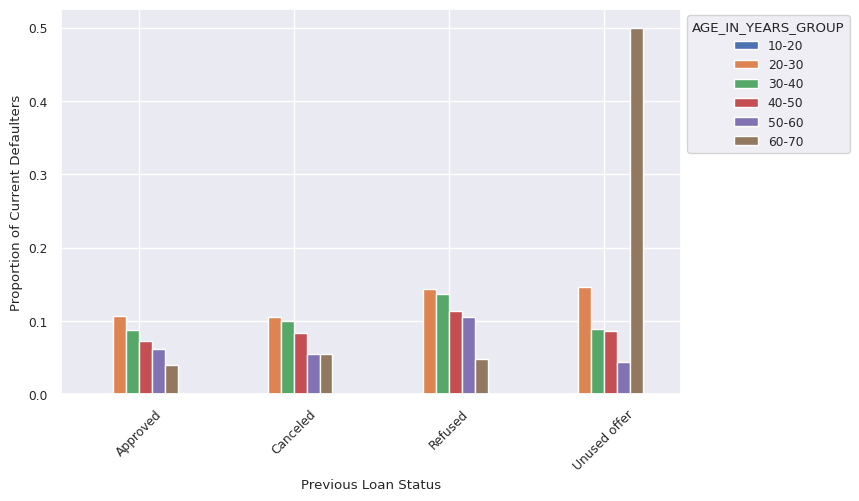

In [274]:
# Create a pivot table and plot a bar chart
cols_bar= ['NAME_CLIENT_TYPE','CODE_GENDER','AMT_INCOME_TOTAL_GROUP','NAME_PORTFOLIO','AGE_IN_YEARS_GROUP']
for col in cols_bar:
  pivot_table = df.pivot_table(values='TARGET', index='NAME_CONTRACT_STATUS', columns=col, aggfunc='mean')
  ax = pivot_table.plot.bar(figsize=(8, 5), rot=45)

  # Set labels for the axes
  plt.xlabel('Previous Loan Status')
  plt.ylabel('Proportion of Current Defaulters')
  # Move the legend to the top right outside the figure
  ax.legend(title=col, bbox_to_anchor=(1, 1), loc='upper left')
  # Display the bar chart
  plt.show()

**Notable Points**

*Default Patterns by Previous Loan Status and Gender:*

* Refused clients exhibit a higher default rate compared to approved clients.
* Across all loan statuses, males have a higher default rate than females.

*Default Patterns by Previous Loan Status and Client Type:*

* Defaulters are more prevalent among clients with a previous loan status of "Unused offers," particularly among those who were categorized as "New" clients.

* For previous "Approved" statuses, new clients show a higher default rate, followed by repeater clients.
* Among applicants with a previous status of "Refused," defaulters are more common among repeater clients.
* Among applicants with a previous status of "Canceled," new clients have a higher default rate.

*Default Patterns by Age Group for Approved Clients:*

* For approved clients, younger applicants tend to have a higher default rate.

* Among approved clients, senior applicants display a lower default rate compared to other age groups.

*Default Patterns by Income Range for Unused Offers:*

* Among unused offers, applicants with an income range of 180000-240000 have a higher default rate, while those with incomes exceeding 240000 show the least defaults.

* Across all loan statuses, default rates are relatively consistent across various income groups.

*Default Patterns by Loan Status and Portfolio Type:*

* Clients who refused applied loans for cards exhibit a higher default rate.

* For approved loan statuses, clients applying for cars have a lower default rate.
* Clients who refused applied loans for cars also show a lower default rate.





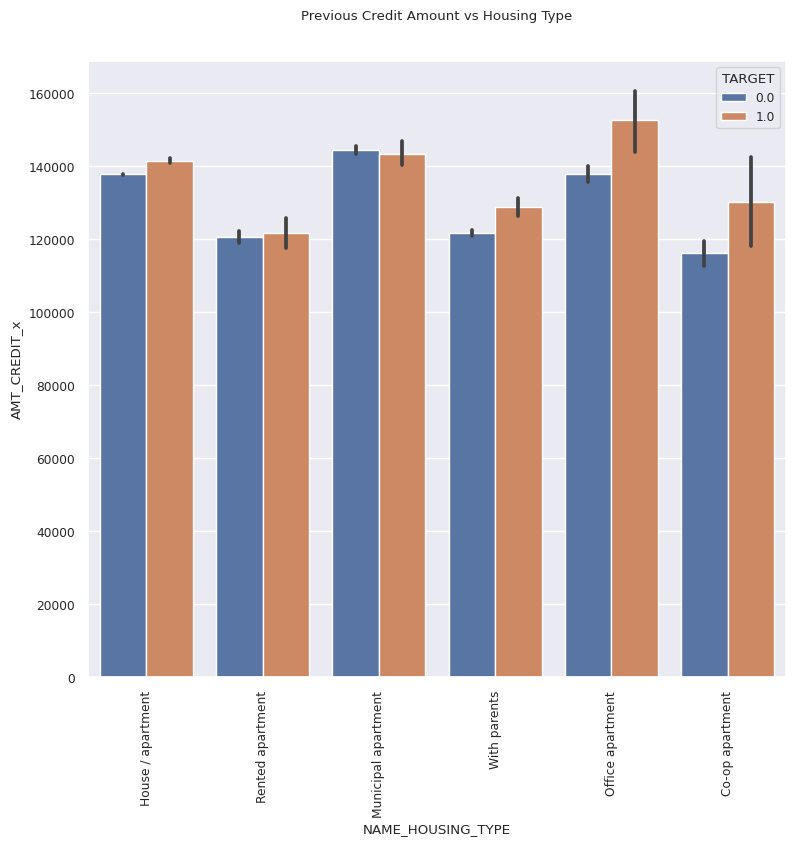

In [275]:
# Create a bar plot for previous credit amount vs housing type
plt.figure(figsize=(9, 8))
plt.xticks(rotation=90)
sns.barplot(data=df, y='AMT_CREDIT_x', hue='TARGET', x='NAME_HOUSING_TYPE')
plt.title('Previous Credit Amount vs Housing Type')
plt.show()

**Notable points**
* In terms of housing types, it's notable that office apartments exhibit a higher credit default rate (target 1), while municipal apartments show a higher credit repayment rate (target 0).
* This suggests that the bank should exercise caution when granting loans for office apartments, as they tend to face challenges in timely payments.
* Conversely, the bank could prioritize housing types such as those with parents, houses/apartments, or municipal apartments, which have a track record of more successful payment histories.

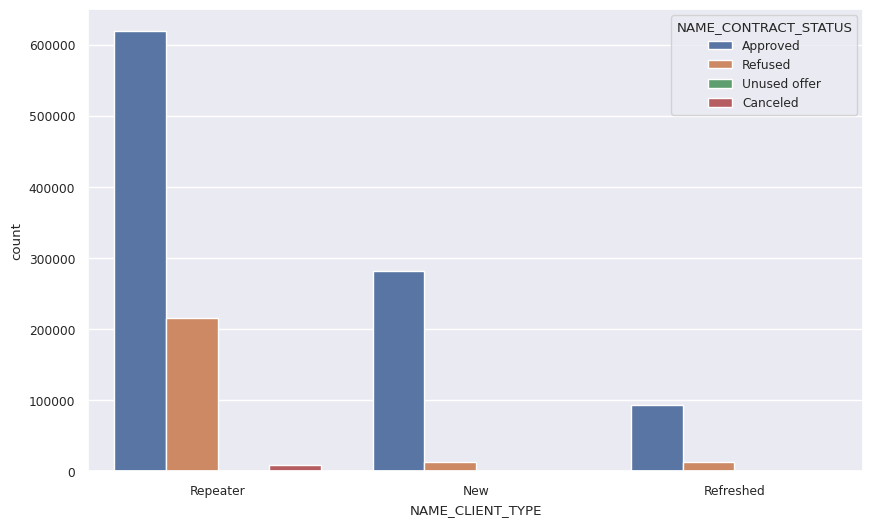

In [276]:
plt.figure(figsize=(10,6))

sns.countplot(x = 'NAME_CLIENT_TYPE' ,hue = 'NAME_CONTRACT_STATUS', data = df )
plt.show()

**Notable points**

* Observing the data, it's evident that Repeater clients have a higher count of approved loans compared to New and Refreshed clients.

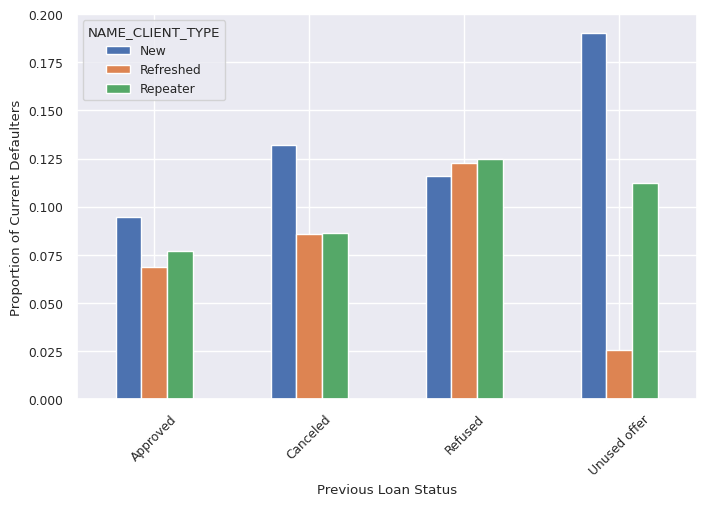

In [277]:
# Create a pivot table and plot a bar chart
pivot_table = df.pivot_table(values='TARGET', index='NAME_CONTRACT_STATUS', columns='NAME_CLIENT_TYPE', aggfunc='mean')
pivot_table.plot.bar(figsize=(8, 5), rot=45)

# Set labels for the axes
plt.xlabel('Previous Loan Status')
plt.ylabel('Proportion of Current Defaulters')

# Display the bar chart
plt.show()

**Notable Points**
* Among clients who were previously categorized as "Unused offers," there is a higher occurrence of defaulters, particularly among those who were categorized as "New" clients.
* When analyzing clients with a previous loan status of "Approved," it is noticeable that "New" clients have a higher count of defaults, followed by "Repeater" clients.
* For clients with a previous loan status of "Refused," the instances of defaulters are higher among "Refreshed" clients.
* Among applicants with a previous loan status of "Canceled," the count of defaulters is higher among "New" clients.

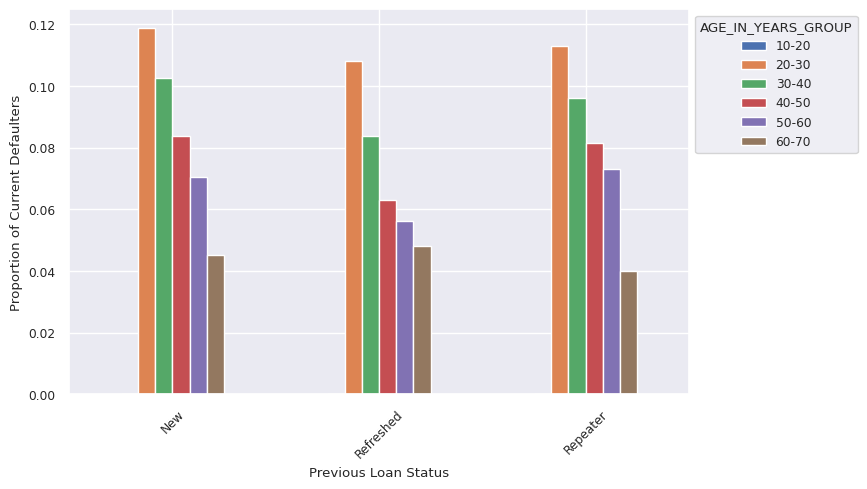

In [278]:

# Create a pivot table and plot a bar chart
pivot_table = df.pivot_table(values='TARGET', index='NAME_CLIENT_TYPE', columns='AGE_IN_YEARS_GROUP', aggfunc='mean')
ax = pivot_table.plot.bar(figsize=(8, 5), rot=45)

# Set labels for the axes
plt.xlabel('Previous Loan Status')
plt.ylabel('Proportion of Current Defaulters')
# Move the legend to the top right outside the figure
ax.legend(title='AGE_IN_YEARS_GROUP', bbox_to_anchor=(1, 1), loc='upper left')
# Display the bar chart
plt.show()

**Notable Points**
* Across all previous loan statuses, younger applicants exhibit a higher frequency of defaults.
* Irrespective of the previous loan status, senior applicants show a lower incidence of defaults compared to other age groups.

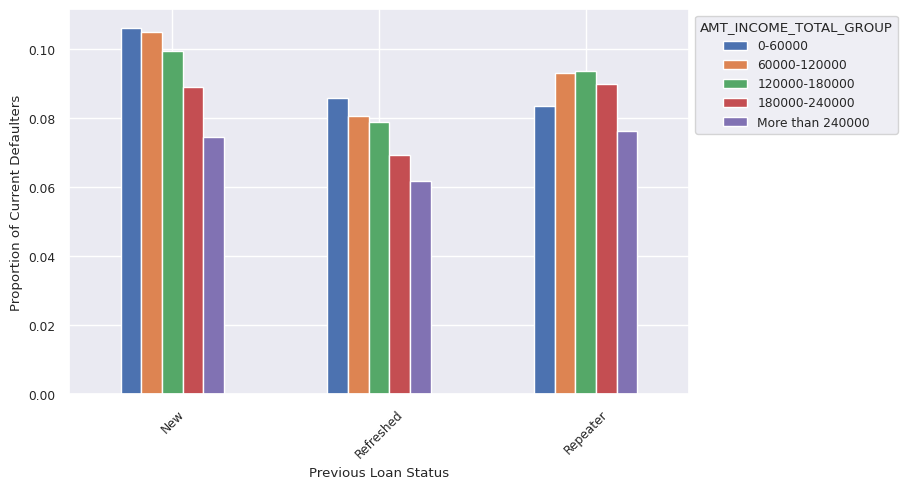

In [279]:

# Create a pivot table and plot a bar chart
pivot_table = df.pivot_table(values='TARGET', index='NAME_CLIENT_TYPE', columns='AMT_INCOME_TOTAL_GROUP', aggfunc='mean')
ax = pivot_table.plot.bar(figsize=(8, 5), rot=45)

# Set labels for the axes
plt.xlabel('Previous Loan Status')
plt.ylabel('Proportion of Current Defaulters')
# Move the legend to the top right outside the figure
ax.legend(title='AMT_INCOME_TOTAL_GROUP', bbox_to_anchor=(1, 1), loc='upper left')
# Display the bar chart
plt.show()

**Notable Points**

* New applicants with an income range of 0-60000 tend to have a higher rate of defaults.
* Among repeater applicants, those with an income range of 0-60000 show a lower default rate compared to other client types.
* Repeater applicants with an income exceeding 240000 exhibit a higher default rate compared to other income ranges.

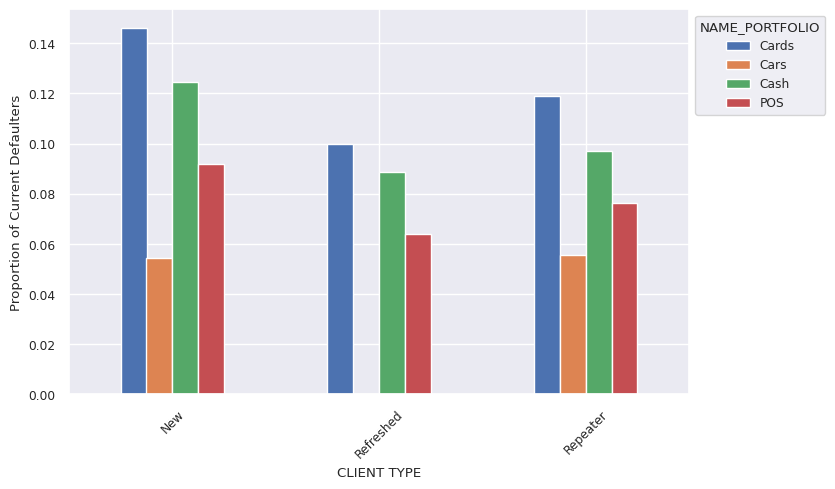

In [280]:

# Create a pivot table and plot a bar chart
pivot_table = df.pivot_table(values='TARGET', index='NAME_CLIENT_TYPE', columns='NAME_PORTFOLIO', aggfunc='mean')
ax = pivot_table.plot.bar(figsize=(8, 5), rot=45)

# Set labels for the axes
plt.xlabel('CLIENT TYPE')
plt.ylabel('Proportion of Current Defaulters')
# Move the legend to the top right outside the figure
ax.legend(title='NAME_PORTFOLIO', bbox_to_anchor=(1, 1), loc='upper left')
# Display the bar chart
plt.show()

**Notable points**
* Among the cards portfolio, new applicants display the highest default rate.
* Within the cars portfolio, refreshed applicants have no instances of default.
* Among different client types in the cards portfolio, refreshed applicants exhibit the lowest default rate compared to others.

#***This is a noteworthy observation***

* Variables such as medium income, age groups of 20-30 and 30-40, being male,and occupation types like business type 3,self-employed were identified as leading to defaults.

* Married clients with five or more children have an elevated risk of defaulting.Default rates are highest among males with lower secondary education.Maternity Leave tend to have a higher tendency to default when they have a larger number of children.
These findings were confirmed when checking against approved loans with defaults.

* Unused applications tend to be more prevalent in the higher age group, which could provide an explanation for their underutilization.

* Female applicants have a lower default rate, suggesting that they could be given extra consideration.

* Although more defaulters are working applicants, this does not imply that working applicants should be refused outright. Further scrutiny of other parameters is necessary.


* Banks should prioritize applicants with an educational background of 'Higher education' while exercising caution with those who have completed 'Secondary/secondary special,' as they tend to encounter difficulties in making payments.

* It is advisable for banks to steer away from clients with an income type of 'Working' due to their higher likelihood of facing payment difficulties. Instead, they should concentrate on clients classified as 'Commercial associate,' 'Pensioner,' and 'State servant.'

* To reduce payment difficulties, banks should place a stronger emphasis on clients residing in 'House/apartment' housing types, as they exhibit fewer issues with payments.

* Banks should note that the 'Country-wide' channel type tends to result in more approved loans, whereas the 'Credit and cash offices' channel type is associated with a higher number of canceled and refused loans.





